# Important Libraries

In [1]:
# Initialization commands
%matplotlib inline

# Important libraries
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib as mpl
import seaborn as sns
import os

import numpy.random as npr # random sampling functions
import scipy.stats as sps # statistical functions
import matplotlib.pyplot as plt # Matlab plotting framework
import matplotlib.mlab as mlab
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib.ticker as mticker
import time

# Important functions
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from mpl_toolkits.mplot3d import Axes3D
from numpy import array
from scipy.io import loadmat
from multiprocessing.dummy import Pool as ThreadPool
from scipy.cluster.vq import vq, kmeans, whiten
from matplotlib import colors as mcolors
colors = dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS)

# Misc settings
sns.set(context="poster", style="whitegrid")

import warnings
warnings.filterwarnings('ignore')

basePath = os.getcwd()

import matplotlib.pylab as pylab
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 50,
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
pylab.rcParams.update(params)

# 1. The Model

### Regression Analysis

Statistical post-processing is fundamentally a regression problem. It embodies the search for a mathematical transformation that consistently maps an arbitrary collection of estimators to a vector of predictands for which a forecast is desired. Linear transformations are frequently selected for analytical convenience and computational efficiency (e.g., Lorenz 1962 and Leith 1974), and any number of predictor variables may be considered (e.g., climatology or an arbitrary collection of multi-model ensemble estimates), according to the multiple linear regression framework in Kruschke (2014). In this sense, the post-processing schemes examined by various authors in the literature review employ algorithms that map imperfect forecasts, which serve as predictor variables, to the dependent response of the observations. While any number of known or, as is often the case, unknown physical processes may be involved in the dynamical realization of an arbitrary set of predictands, statistical regression provides a basis for the estimation of regression parameters (e.g., the slope and intercept in a standard linear scheme) that appropriately characterize their stochastic realization. The figure below illustrates the basic elements of this predictor-response relationship, in which a scatter plot of ensemble mean forecasts and their corresponding observations are visualized as a set of ordered pairs.

<img src="https://dl.dropboxusercontent.com/u/88590382/html_pics/scatter.png" style="width:600px">

__Verification plot showing bias in ensemble mean forecasts of maximum diurnal surface temperatures in the Weather Challenge forecast competition. The colorbar at right indicates the normalized age of each forecast-observation pair, which could be used to weight data (e.g., BMA) in the resulting simple linear regression.__

To a first-order, linear approximation, the canonical ordinary least squares (OLS) regression method produces a line of best fit that attempts to minimize a quadratic cost function of independent and dependent variables. While the mathematical details of this analysis are too elementary to be reproduced here, the prognostic utility of the approach is quite profound. In particular, the linear transformation produced by the OLS regression produces a minimum-error mapping of independent forecast variables to dependent observations – a set of mathematical instructions that, on average, would have nudged raw forecasts towards their corresponding observations. Although constructed from observed data (i.e., previous sets of estimators and predictands), the basic elements of any generative model require counterfactual statements about unobserved predictands from a posteriori beliefs. “With inferential statistics,” Kruschke (2014) observes, “we don’t just introspect to find the truth. Instead, we rely on data from observations. Based on the data, what should we believe in?”

<img src="https://dl.dropboxusercontent.com/u/88590382/html_pics/regression_pic.png" style="width: 800px">

__Examples of simple linear regression with (a) plausible lines of best fit and (b) Gaussian PDFs fit to a scatter of arbitrary data to illustrate the basic elements of the underlying statistic inference (from Kruschke 2014).__

To this end, the simple linear regression procedures described above provide a rudimentary template for adjusting contemporary ensemble guidance towards an outcome with greater statistical likelihood – a bias correction. It is also adaptive in the sense that the details of the linear transformation are a function of the independent predictor variable; that is, a correction that is appropriate for a raw temperature prediction of 285K may not be ideal for a raw prediction exceeding 300K. This feature is commonly described as a state-dependent bias correction in the statistical post-processing literature, and it should be noted that the model proposed for this dissertation will follow the standard convention of mapping ensemble forecasts (i.e., estimators) to observations (i.e., realized predictands) – not the inverse scheme explored by Hodyss et al. (2016). While the former first-order scheme can be effective in operational applications – even in trivial circumstances when the bias correction is simply a constant offset from the predictor variable (i.e., the regression slope is identically one) – it lacks the rigor of the advanced regression techniques considered by other authors. Moreover, it fails to capture more complex inference structures as with the deficiencies of KDE. In this way, a full Bayesian framework is proposed.

[Hodyss, D., E. Satterfield, J. McLay, T. M. Hamill, and M. Scheuerer, 2016: Inaccuracies with multi-model post-processing methods involving weighted, regression-corrected forecasts. Monthly Weather Review, 144(4), 1649–68.](http://journals.ametsoc.org/doi/abs/10.1175/MWR-D-15-0204.1)
    
[Kruschke, J. K., 2014: Doing Bayesian Data Analysis: A Tutorial with R, JAGS, and Stan. Academic Press, 776 pp.](http://www.indiana.edu/~kruschke/DoingBayesianDataAnalysis/)
    
[Leith, C. E., 1974: Theoretical skill of Monte Carlo forecasts. Monthly Weather Review, 102, 409–18.](http://journals.ametsoc.org/doi/abs/10.1175/1520-0493(1974)102%3C0409%3ATSOMCF%3E2.0.CO%3B2)
    
[Lorenz, E. N., 1962: The statistical prediction of solutions of dynamic equations. Proceedings of the International Symposium on Numerical Weather Prediction, Tokyo, 629–35.](http://eaps4.mit.edu/research/Lorenz/publications.htm)

### Bayesian Data Analysis

From a robust statistical modeling perspective, it is advantageous to explicitly quantify the underlying uncertainty associated with an inference (Gelman 2013). While classical frequentists (i.e., non-Bayesian) methods are suitable for this task, and are typically accompanied by 95% confidence intervals, Gelman (2013) and Kruschke (2014), among others, emphasize the power of BA in this regard. Inspired by meaningful improvements in computational power during the 1980s, Robert and Casella (2011) observe that an MCMC “revolution” led to an important resurgence of complex Bayesian probability models within the statistical community (e.g., Geman and Geman 1984, Gelfand and Smith 1990). Moreover, these BA methods were subsequently observed to have several advantages. In his development of Bayesian multiple linear regression techniques, which have principle relevance to this dissertation, Kruschke (2014) notes:

    "One of the benefits of Bayesian analysis is that correlations of credible parameter values are explicit in the posterior distribution. Traditional statistical methods provide only a single 'best' (e.g., MLE) parameter value, without indicating the trade-offs among parameter values. The Bayesian posterior, however, naturally reveals trade-offs and redundancies among parameters. It is up to the user to actually look for and interpret the correlations of parameters, of course. Another benefit of Bayesian analysis is that the model doesn’t “explode” when predictors are correlated. If predictors are correlated, the joint uncertainty in the regression coefficients is evident in the posterior, but the model happily generates a posterior regardless of correlations in the predictors. The classical, one-best-solution method is much less robust in the presence of strongly correlated predictors."

A concise description of Bayesian reasoning, which was notably advanced by Laplace and other contemporary mathematicians (Stigler 1990), is provided by Gelman (2013) as a procedure to “invert the probability statement and obtain probability statements about [parameters] given observed [data].”

In this way, Bayes' rule is frequently derived as

$$p(y,\theta) = p(y|\theta)p(y) = p(\theta|y)p(\theta),$$

where $p(y|\theta)$ is the conditional probability of observed data given the model parameters, p(\theta|y) is the conditional probability of model parameters given the observed data, and p(\theta) and p(y) are the marginal probabilities of the model parameters and the data. The theorem itself is revealed by a trivial manipulation of the above to produce

$$ p(\theta|y) = \frac {p(y|\theta)p(y)}{p(y)}, $$

which implies the all-important result:

$$ p(\theta|y) \propto p(y|\theta)p(\theta) $$

As with Lorenz and chaos theory, the implications of these concepts are difficult to overstate. In simple terms, there is tremendous value in “inverting the probability statement” (vis-à-vis Gelman 2013) to update our beliefs in model parameters, regardless of their subjective origins, and, therefore, refine the inferences they inform with data. Unlike the KDE/BMA and simple linear regression schemes previously considered, which work directly with objective evidence in a more naïve fashion, this expression combines data with subjective information encoded within the Bayesian prior to produce an optimal,
updated estimation of generative model parameters. This simple analytical framework can similarly exploit the chain rule of probability (vis-à-vis Hodyss 2016) to construct Bayesian JPMs with an arbitrarily large number of parameters. In this way, Bayesian reasoning can be easily scaled to generate tractable probability models of exceptional sophistication (Gelman 13).

The Bayesian joint probability model (JPM) is selected by the modeler and composed of the likelihood function the prior - that is, $p(\theta|y)$ - and $p(\theta)$. In simple terms, the likelihood function represents the probability of observing our data set as we vary the parameters in phase space of the model. The latter point is a key aspect of Bayesian thinking: the model parameters themselves are treated as random variables, which means we can make statistical inferences about their values conditioned on the data, as one would expect, but also on any __a priori__ beliefs encoded in the Bayesian prior.

To capture the covariation of desired observable variables with an arbitrary number of explanatory variables (i.e., so-called predictor variables), my research is primarily focused on Bayesian multivariate multiple linear regression. More specifically, we extend the Bayesian inference scheme in one dimension, which is written as

$$y(x_i|\beta_0,\beta_1) \sim (\beta_0 + \beta_1x, \sigma^2)$$

to $k-1$ predictors, or estimators, in the form 

$$y(x_i|\beta_0,\beta_1,...,\beta_n) \sim (\beta_0 + \sum_{i=1}^{k-1} \beta_i x_i, \sigma^2)$$

In this way, the Bayesian JPM can be visualized as
<img src="https://dl.dropboxusercontent.com/u/88590382/html_pics/jpm.png" style="width: 900px">

__JPM diagrams for two multiple linear regression models. The panel on the left (a) depicts a non-hierarchical GLM in which the hyperparameters are fixed. The panel on the right (b) depicts a hierarchical GLM in which the hyperparameters of the Bayesian priors are also model parameters influenced by the data via hyperpriors (from Kruschke 2014).__

Finally, we must extend this model structure even further if we wish to diagnose covaration among a vector of observable variables - the predictands - for forecast applications with multiple desired predictions (e.g., tropical cyclone track and intensity predictions):

$$y_{i,1}=x_i^TB_1+\epsilon_{i,1}$$
$$y_{i,2}=x_i^TB_2+\epsilon_{i,2}$$
$$...$$

$$y_{i,m}=x_i^TB_m+\epsilon_{i,m}$$

More generally, we can write:

$$y_i^T=x_i^TB+\epsilon_i^T,$$

where $y^T$ is a row vector of length $m$, $x^T$ is a row vector of length k, and $\beta$ is a $k x m$ matrix. When $n$ train samples are considered, this is written as:

$$Y=XB+E,$$

where $X$ is known as the design matrix, which contains the explanatory variables over $n$ samples and the error matrix $E$ is composed of multivariate normal (MVN) errors centered on $XB$.

BA permits a wide variety of likelihood functions for the JPM. However, the proposed dissertation will seek the widest application of the MVN form indicated in the next section. Moreover, the parameter inferences invoked by the equations above require some form a prior information (i.e., $p(\theta))$. While the modeler has tremendous freedom to “let the data speak for themselves,” which would be implemented through so-called non-informative or weakly informative priors, almost any proper prior distribution (i.e., $p(\theta)$ is independent of data and integrates to unity) will suffice (Gelman 2013). In this way, a subject matter expert can imbed meaningful dynamical reasoning into the JPM – not simply from the distribution chosen for the likelihood function, which describes the manner in which observed and unobserved data are stochastically realized, but also from subjective beliefs about model parameters we include in the Bayesian prior.

For many Bayesian probability models, including the multiple linear regression framework described by Rossi et al. (2005) and Kruschke (2014), the prior distributions can be augmented with hyperparameters that are also influenced by the data. In simple terms, this means the prior distributions contain unknown hyperparameters that are not fixed, but are instead described by an additional level – or levels – of stochastic expressions (i.e., the hyperpriors) with their own hyperparameters. As with the GLM concept, hierarchical models capture additional structure in the parameters that can improve the fit of the JPM to the data (e.g., regression coefficient shrinkage vis-à-vis Kruschke 2014). To this end, the MVN likelihood proposed for this dissertation will be heuristically paired with a variety of hierarchical priors – most frequently with either a Gaussian or t location-scale distribution fit to the multiple linear regression coefficients.

The inferences produced by the methods described heretofore focus exclusively on the parameters of the selected JPM. In this way, Bayesian posteriors are useful for diagnostic analyses of model parameters, because they describe optimal updated statistical beliefs in the elements of the generative model. However, they are not explicitly prognostic. If predictive statements about unobserved data are desired, as required by the nature of the statistical post-processing methodologies engaged by the proposed research, then additional analysis must be pursued. In particular, the posterior belief in model
parameters acquired though Bayesian analysis, which is contained in the joint probability distribution of $p(\theta|y)$ , must be weighted by the conditional probability of observing the unobserved random variable and summed over all possible values of the model parameters (Gelman 2013). To this end, let $z$ be an unobserved observable random variable (i.e., synthetic data), $y$ be an observed observable random variable (i.e., train data), and $p(z|y)$ describe the
posterior predictive distribution as

$$ p(z|y) = \int p(z,\theta|y)d\theta = \int p(z|\theta)p(\theta|y)d\theta, $$

where the quantity $p(z|\theta)$ is functionally equivalent to the likelihood selected for the JPM (Gelman 2013). While this expression is indeed analytically intractable for some models, the same MCMC techniques that helped popularize Bayesian analysis produce joint posterior samples from $p(\theta|y)$ that are easily repurposed for a discrete analogue of the above equation. In simple terms, the MCMC samples produced by the methods described in the next section produce
samples from $p(z|y)$ with little additional computational expense or modeling effort.

[Gelfand, A. E. and A. F. M. Smith, 1990: Sampling-based approaches to calculating marginal densities. Journal of the American Statistical Association, 85, 398–409.](http://wwwf.imperial.ac.uk/~das01/MyWeb/SCBI/Papers/GelfandSmith.pdf)
    
[Gelman, A., J. B. Carlin, H. S. Stern, D. B. Dunson, A. Vehtari, and D. B. Rubin, 2013: Bayesian Data Analysis, Third Edition. Chapman & Hall/CRC Press, 675 pp.](http://www.stat.columbia.edu/~gelman/book/)
    
[Geman, S. and D. Geman, 1984: Stochastic relaxation, Gibbs distributions and the Bayesian restoration of images. IEEE Transactions on Pattern Analysis and Machine Intelligence, 6, 721–41.](http://www.stat.cmu.edu/~acthomas/724/Geman.pdf)
    
[Kruschke, J. K., 2014: Doing Bayesian Data Analysis: A Tutorial with R, JAGS, and Stan. Academic Press, 776 pp.](http://www.indiana.edu/~kruschke/DoingBayesianDataAnalysis/)
    
[Robert, C. P. and G. Casella, 2011: A Short History of Markov Chain Monte Carlo: Subjective Recollections from Incomplete Data. Statistical Science, 26(1), 102–15.](http://www.stat.ufl.edu/archived/casella/Papers/MCMCHistory.pdf)
    
[Rossi, P. E., G. M. Allenby, and R. McCulloch, 2005: Bayesian Statistics and Marketing. John Wiley & Sons, 368 pp.](http://www.wiley.com/WileyCDA/WileyTitle/productCd-0470863676.html)

### Markov Chain Monte Carlo Sampling

In the decades that preceded the MCMC “revolution” inspired by Gelfand and Smith (1990), Bayesian analysis was effectively dormant in the statistical community (Robert and Casella 2011). However, MCMC sampling would reinvigorate Bayesian methods and make important contributions in machine learning, deep learning, and artificial intelligence. In some trivial applications, the BA described in the previous section can be completed without the aid of computational techniques. These circumstances typically result from the selection of conjugate priors, which guarantee that, for a given likelihood function, the Bayesian posterior and prior will belong to the same distributional family (Kruschke 2014). While computationally tractable and conceptually convenient, conjugate priors limit the scope and utility of Bayesian models – perhaps most notably in the complexity of the JPM/GLM permitted by the inference. In this way, MCMC computational methods are frequently invoked to complete the inference in Bayesian “models with many parameters and complicated multilayered probability specifications” (Gelman 2013). While a full description of MCMC theory is beyond the scope of this proposal, the essential elements of one popular approach – the Metropolis algorithm (Metropolis et al. 1953) – will be developed to demonstrate their application in Bayesian models.

The principle obstacle to arbitrarily complex models in BA is the specification of the normalizing constant  - that is, the denominator in Bayes’ theorem (Gilks 1996). To this end, Gelman (2013) expands $p(y)$ as

$$ p(y) = \int p(y,\theta)d\theta = \int p(y)p(y|\theta)d\theta$$

Unlike the other elements of Bayes' rule, which are functions of the model parameters $\theta$, the quantity defined above has marginalized this dependence out of the integrand. Although a constant with respect to the parameters, this expression – which ensures the Bayesian posterior integrates to unity (i.e., a PDF) – is frequently unavailable in closed-form (Gelman 2013). Without the benefits of Markov chain simulation, this analytical obstacle prevents the completion of the inference in many Bayesian models. Fortunately, a computational scheme introduced by Metropolis et al. (1953), and later generalized by Hastings (1970), provides a method of drawing samples from arbitrarily complicated target distributions that are otherwise intractable by classical methods (Robert and Casella 2011). Compared to other schemes available for parameter estimation (e.g., the expectation-Maximization algorithm in R05), MCMC methods offer many advantages (Vrugt et al. 08). In particular, these MCMC methodologies leverage a special property of Markov chains – that is, the Markov property – for which the development of any state, $\theta_t$, in a sequence of random variables is dependent solely on the previous state, $\theta_{t-1}$, and a transition kernel, $T$, that stochastically maps every possible state of $\theta$ to any other (Gilks 1996). As a result, this sequence of states is considered memoryless; each additional step is independent of all previous states visited and, perhaps more importantly, the sequence of states produced in this manner – that is, the Markov chain – represents a random walk through the phase space of the random variables and the transition kernel (Kruschke 2014).

The efficacy of Markov chain simulation in BA depends on three additional properties. If the chains are also observed to be irreducible (i.e., transitions to and from any phase space location have non-zero probability and are possible in finite time), aperiodic (i.e., no diagnosable periodicity in the frequency with which phase space locations are visited), and non-transient, then the Markov chain is guaranteed to “forget” its initial state (Gilks 1996) and converge to a unique stationary distribution (Gelman 2013). MCMC methods exploit these properties by reverse-engineering a Markov chain with a stationary distribution that matches the target (e.g., $p(\theta|y) \propto p(y|\theta)p(\theta)$ – the unnormalized Bayesian posterior). In particular, we seek a Markov chain that visits phase space locations with a relative frequency that is statistically consistent with the probabilistic mass contained within the desired joint probability distribution. The analytical development of this condition, which guarantees the equivalence of the stationary and target distributions, is beyond the scope of this document; however, the eager reader is encouraged to consult Gilks (1996), Gelman (2013), and Kruschke (2014) for additional details. Nevertheless, a parsimonious description of the Metropolis algorithm reproduces the most relevant portions of the associated proof.

To generate samples from an arbitrary target distribution over $\theta$ , we seek a Markov chain that produces a random walk through the multi-dimensional phase space of the parameters (Kruschke 2014). To accomplish this, Metropolis et al. (1953) introduced a simple modification to Markov chain mechanics that ensures the chain “finds” the desired stationary distribution (Gelman 2013). If the Bayesian posterior is the target, the Metropolis algorithm generates each step in the resulting sequence by evaluating the quantity $p(\theta|y)$ at two locations in the phase space of the model: the current location, $\theta_t$, and a proposal location, $\theta_{t+1}$, which is stochastically drawn from a symmetric jumping (i.e., transition) distribution centered on the current value of $\theta_t$. If the ratio of the target densities at the
proposed and current locations is defined as

$$ \frac {p(\theta_{t+1}|y)}{p(\theta_t|y)} = \frac {\frac {p(y|\theta_{t+1}p(\theta_{t+1})}{p(y)}}{\frac {p(y|\theta_{t})p(\theta_{t})}{p(y)}} = \frac {p(y|\theta_{t+1}p(\theta_{t+1})}{p(y|\theta_{t})p(\theta_{t})},$$

then the transition is accepted with probability $min(r,1)$; that is, the location $\theta_{t+1}$ is appended to the sequence if $r \geq 1$ or if a random number drawn from the open interval (0,1) is less than r (Gelman 2013). If this condition is not satisfied, then current value of $\theta_t$ is appended as the next element of the chain. Regardless, this process is repeated until the moving average of multi-dimensional states reaches its stationary distribution. Monte
Carlo samples of the desired target distribution may be taken from any portion of the chain that has reached its stationary distribution (i.e., converged) in this manner.

The Markov chain created by this procedure does not discriminate between multidimensional states that have been accepted or rejected. While transitions to locations with lower target density are similarly permitted, the Metropolis algorithm merely records the sequence of phase space locations visited during the random walk. As a result, phase space locations with greater density in the joint probability distribution will be recorded more frequently in the multi-dimensional sequence of the evolving chain. The equation above also reveals the mechanism by which the normalizing constant is managed in MCMC algorithms. While crucial to the completion of the Bayesian inference by purely analytical means, the normalization constant is identically canceled from the ratio because it does not depend on the variability of the multidimensional parameter $\theta$. The resulting expression, which requires only the likelihood function and the Bayesian priori, can be computationally evaluated for arbitrarily complex Bayesian models. This gives the BA modeler tremendous flexibility in the selection of the JPM and, ideally, the fit of the inference scheme to data and subjective a priori beliefs.


<img src="https://dl.dropboxusercontent.com/u/88590382/html_pics/mcmc_trace.png" style="width: 900px">

__Multiparameter trace diagram for five parallel Markov chains in a semi-log time series of discrete phase space locations (grey dots) and superimposed moving averages (solid blue and dashed black). Panel (a) shows the joint trace; panels (b) and (c) depict the associated marginal traces (cross-sectional views). Time increases up in (a) and right in (b) and (c).__


<img src="https://dl.dropboxusercontent.com/u/88590382/html_pics/mcmc_compare.png" style="width: 700px">

__Comparison of analytical (green plot) and MCMC (blue histogram) solutions for a simple Bayesian inference scheme with a conjugate normal priori distribution. The normal posterior distribution represented in the histogram was generated by extending the Metropolis algorithm represented in Figure 10 through 15000 additional iterations (from Wiecki 2015).__

Finally, the posterior samples produced by MCMC methods require additional manipulation to make probability statements about unobserved data (i.e., predictions). To this end, the likelihood function found in MLE and BA can be similarly tasked to produce samples from Bayesian PPDs (Gelman13). MCMC methods make this process conceptually and computational efficient. As suggested by Equation (3), a Gaussian likelihood function similarly assumes that an unobserved observable random variable z is stochastically drawn as

$$ z \sim N(\mu, \sigma^2),$$

where $\mu$ and $\sigma^2$ are location and shape parameters that may be arbitrarily reparametrized in a GLM of the modeler’s choosing. Multi-dimensional samples from the joint posterior distribution of unobservable parameters $\theta$ can be combined with updated predictor variables (i.e., current values for the explanatory variables to iteratively populate the elements of the corresponding GLM. In this way, PPD samples are generated by a discrete formulation of $p(z|y)$ as

$$ p(z|y) = \sum p(z|\theta)p(\theta|y)$$

where each sample of $z$ is stochastically drawn from the likelihood specified by $p(z|\theta)$ according to the multi-dimensional parameter samples from $p(\theta|y)$. While no prohibitions on the number of PPD samples drawn for each $\theta$ are known exist, so long as they are uniformly distributed over the parameter samples, the proposed dissertation will initially assume that a $1:1$ ratio between z and $\theta$ samples will be sufficient to accurately specify the desired PPDs. In this way, BA/MCMC PPDs complete a full inference scheme that brings a robust diagnostic and prognostic functionality to almost any data science problem. While the proposed research will specialize the MVN JPM to the meteorological/NWP applications in section II.D of the full proposal, these methods can be considered for virtually any inference required in computational science.

[Gelfand, A. E. and A. F. M. Smith, 1990: Sampling-based approaches to calculating marginal densities. Journal of the American Statistical Association, 85, 398–409.](http://wwwf.imperial.ac.uk/~das01/MyWeb/SCBI/Papers/GelfandSmith.pdf)
    
[Gelman, A., J. B. Carlin, H. S. Stern, D. B. Dunson, A. Vehtari, and D. B. Rubin, 2013: Bayesian Data Analysis, Third Edition. Chapman & Hall/CRC Press, 675 pp.](http://www.stat.columbia.edu/~gelman/book/)
    
[Gilks, W. R., S. Richardson, and D. J. Spiegelhalter, 1996: Markov Chain Monte Carlo in Practice. Chapman & Hall, 504 pp.](https://www.crcpress.com/Markov-Chain-Monte-Carlo-in-Practice/Gilks-Richardson-Spiegelhalter/p/book/9780412055515)
    
[Hastings, W., 1970: Monte Carlo sampling methods using Markov chains and their application. Biometrika, 57, 97–109.](http://www.jstor.org/stable/2334940?seq=1#page_scan_tab_contents)
    
[Kruschke, J. K., 2014: Doing Bayesian Data Analysis: A Tutorial with R, JAGS, and Stan. Academic Press, 776 pp.](http://www.indiana.edu/~kruschke/DoingBayesianDataAnalysis/)
    
[Metropolis, N., A. Rosenbluth, M. Rosenbluth, A. Teller, and E. Teller, 1953: Equations of state calculations by fast computing machines. Journal of Chemical Physics, 21, 1087–92.](http://bayes.wustl.edu/Manual/EquationOfState.pdf)
    
[Robert, C. P. and G. Casella, 2011: A Short History of Markov Chain Monte Carlo: Subjective Recollections from Incomplete Data. Statistical Science, 26(1), 102–15.](http://www.stat.ufl.edu/archived/casella/Papers/MCMCHistory.pdf)
    
[Vrugt, J., C. J. H. Diks, and M. P. Clark, 2008: Ensemble Bayesian Model Averaging using Markov-chain Monte Carlo sampling. Environmental Fluid Mechanics, 8, 579–95.](http://faculty.sites.uci.edu/jasper/files/2016/04/41.pdf)
    
[Wiecki, T., cited 2015: While my MCMC Gently Samples: MCMC sampling for dummies.](http://twiecki.github.io/blog/2015/11/10/mcmc-sampling/)

# 2. MCMC Functions

### Log-posterior Odds: Multivariate Normal (MVN) Likelihood with Normal Priors

A MVN log-likelihood function may be represented as

$$l(B ,\Sigma) = - \frac{n}{2}\ln | {\Sigma} | - \frac{1}{2}\sum_{i=1}^n (y_i^T-x_i^TB) \Sigma^{-1} (y_i^T-x_i^TB)^T,$$

which may also be re-written with the so-called "trace trick" to facilitate computational efficiency as

$$l(B ,\Sigma) = - \frac{n}{2}\ln | {\Sigma} | - \frac{1}{2}tr\Bigg[\Sigma^{-1}\sum_{i=1}^n (y_i^T-x_i^TB)^T(y_i^T-x_i^TB)\Bigg]$$

Our normal log-priors are evaluated with fixed hyperparameters $\mu$ and $\sigma$ as:

$$l(\theta|\mu,\sigma) = -\frac{1}{2}\ln(2\pi) - \frac{1}{2}\ln(\sigma^2) - \frac{1}{2\sigma^2} \sum_{i=1}^n (\theta_i - \mu)^2$$

[Bayesian multivariate linear regression](https://en.wikipedia.org/wiki/Bayesian_multivariate_linear_regression)

[Kruschke, J. K., 2014: Doing Bayesian Data Analysis: A Tutorial with R, JAGS, and Stan. Academic Press, 776 pp.](http://www.indiana.edu/~kruschke/DoingBayesianDataAnalysis/)
    
[Gu, L., cited 2008: Multivariate Gaussian Distribution.](https://www.cs.cmu.edu/~epxing/Class/10701-08s/recitation/gaussian.pdf)
    
[Rossi, P. E., G. M. Allenby, and R. McCulloch, 2005: Bayesian Statistics and Marketing. John Wiley & Sons, 368 pp.](http://www.wiley.com/WileyCDA/WileyTitle/productCd-0470863676.html)

In [2]:
def logPost(theta,zHat,oHat):
    
    mm = oHat.shape[1]
    kk = zHat.shape[1]
    nn = oHat.shape[0]
    
    # form the covariance matrix
    covM = tril2cov(theta[-mm*(mm+1)/2:],mm)
    
    # form the beta matrix
    betaM = np.reshape(theta[:mm*kk],(kk,mm))
    arg = np.transpose(oHat - np.dot(zHat,betaM))
    
    # compute the log-likelihood at this location in phase space
    logLike = -0.5*nn*np.log(np.linalg.det(covM)) - 0.5*np.trace(np.linalg.solve(covM, np.dot(arg,arg.T)))
    
    return logLike

### Log-prior: Normal Distribution

In [3]:
def priorNorm(x,mu,sigma): 
    
    return np.sum(- 0.5*np.log(2*np.pi) - np.log(sigma) - ((x - mu)**2)/(2*(sigma**2)))

### Adaptive Metropolis Sampler with MVN Block Updates

[Metropolis–Hastings algorithm](https://en.wikipedia.org/wiki/Metropolis%E2%80%93Hastings_algorithm)

[Metropolis Algorithm](http://www.life.illinois.edu/dietze/Lectures2012/Lesson12_Metropolis.pdf)

[MCMC: Multivariate Distributions, Block-wise, & Component-wise Updates](https://theclevermachine.wordpress.com/2012/11/04/mcmc-multivariate-distributions-block-wise-component-wise-updates/)

[Pasarica, C., Gelman, A.: Adaptively scaling the Metropolis algorithm using the average squared jumped distance. Tech. Rep. Department of Statistics, Columbia University (2003)](http://www.stat.columbia.edu/~gelman/research/published/A06-109-new_version.pdf)

[Roberts, G. O.; Gelman, A.; Gilks, W. R. Weak convergence and optimal scaling of random walk Metropolis algorithms. Ann. Appl. Probab. 7 (1997), no. 1, 110--120. doi:10.1214/aoap/1034625254.](http://projecteuclid.org/download/pdf_1/euclid.aoap/1034625254)

In [4]:
def mcmc(ZH,OH,nn,NN,aa):
    
    # preallocate standard normal MVN matrix of proposals
    mvnJ = npr.multivariate_normal(np.zeros((1,nn)).ravel(),np.eye(nn),NN)
    mvnN = np.reshape(np.apply_along_axis(np.linalg.norm,1,mvnJ),(-1,1))
    mvnJ = mvnJ/mvnN
    
    # initialize the chains 
    pw = np.zeros((1,NN)).ravel()
    ns = np.zeros((1,NN)).ravel()
    theta = np.zeros((NN,nn))
    rndVal = np.log(npr.rand(1,NN)).ravel()
    jj = 0
    
    for i in range(NN):
        
        if np.less(jj,1):
            
            jumpVar = npr.randn()
            thetaHat = npr.multivariate_normal(np.zeros((1,nn)).ravel(),np.eye(nn))
        
        pw[i] = 2*jumpVar
        thetaStar = np.exp(jumpVar)*mvnJ[i] + thetaHat
        logOdds = logPost(thetaStar,ZH,OH) - logPost(thetaHat,ZH,OH)
        
        if np.less(rndVal[i],logOdds):
            
            thetaHat = thetaStar
            jj += 1
        
        if np.greater(jj,0):
            
            jmpDev = np.log(jj) - np.log(i+1) - np.log(aa)
            jmpRel = (NN/4 - 1e3)*((i+1)/NN) + 1e3
            jumpVar = jumpVar + jmpDev/jmpRel
        
        ns[i] = jj/(i+1)
        theta[i] = thetaHat
        
    ns = ns.flatten().tolist()
    pw = pw.flatten().tolist()
    
    return theta,ns,pw

### Covariance Matrix
Cholesky decomposition of a Hermitian positive-definite matrix is defined as $\Sigma = LDL^T$, where $L$ is any real-valued lower unit triangular matrix and $D$ is a diagonal matrix with positive elements. We allow the MVN proposal distribution to populate the elements of $L$ in such a way that all proposals provided by the jumping kernel are valid. The code below manipulates these raw MVN proposal locations to ensure the resulting $\Sigma$ is always a Hermitian positive-definite matrix.

$$\theta^* \sim\ MVN(\theta,\lambda I)$$

$$\Sigma = LDL^T = \left[ \begin{array}{cccc}
1 & 0 & 0 \\
\theta_{4} & 1 & 0 \\
\theta_{5} & \theta_{6} & 1 \\ \end{array} \right]
\left[ \begin{array}{cccc}
\exp(\theta_{1}) & 0 & 0 \\
0 & \exp(\theta_{2}) & 0 \\
0 & 0 & \exp(\theta_{3}) \\ \end{array} \right]
\left[ \begin{array}{cccc}
1 & \theta_{4} & \theta_{5} \\
0 & 1 & \theta_{6} \\
0 & 0 & 1 \\ \end{array} \right] =
\left[ \begin{array}{cccc}
\sigma_{1}^2 & \rho_{12}\sigma_{1}\sigma_{2} & \rho_{13}\sigma_{1}\sigma_{3} \\
\rho_{12}\sigma_{1}\sigma_{2} & \sigma_{2}^2 & \rho_{23}\sigma_{2}\sigma_{3} \\
\rho_{13}\sigma_{1}\sigma_{3} & \rho_{23}\sigma_{2}\sigma_{3} & \sigma_{3}^2 \\ \end{array} \right]$$

In [5]:
def tril2cov(x,m):
    
    D = np.diag(np.exp(x[:m]))
    L = np.zeros((m,m))
    L[np.tril_indices(m,-1)] = x[-(len(x)-m):]
    L[np.diag_indices(m)] = np.ones(m) 
    
    return np.dot(np.dot(L,D),L.T)

In [6]:
def tril2mvn(x,m):
    
    D = np.diag(np.exp(x[:m]))
    L = np.zeros((m,m))
    L[np.tril_indices(m,-1)] = x[-(len(x)-m):]
    L[np.diag_indices(m)] = np.ones(m)
    
    return np.dot(L,sp.linalg.sqrtm(D))

### Unpacking the Covariance Matrix After Sampling
While variance parameter estimates can be useful, we desire inferences for the common elements of the correpsonding covariance matrix in our multivariate Bayesian model. Since the sampler operates on raw Cholesky decomposition parameters and then reshapes them into a covariance matrix with a helper function (i.e., tril2cov), the posterior samples we obtain aren't easily interpreted. As a result, we must convert Cholesky decomposition parameters into the inuitive components of the covariance matrix.

$$\Sigma = \left[ \begin{array}{cccc}
\sigma_{1}^2 & \rho_{12}\sigma_{1}\sigma_{2} & \rho_{13}\sigma_{1}\sigma_{3} \\
\rho_{12}\sigma_{1}\sigma_{2} & \sigma_{2}^2 & \rho_{23}\sigma_{2}\sigma_{3} \\
\rho_{13}\sigma_{1}\sigma_{3} & \rho_{23}\sigma_{2}\sigma_{3} & \sigma_{3}^2 \\ \end{array} \right]
= \left[ \begin{array}{cccc}
1 & 0 & 0 \\
\theta_{4} & 1 & 0 \\
\theta_{5} & \theta_{6} & 1 \\ \end{array} \right]
\left[ \begin{array}{cccc}
\exp(\theta_{1}) & 0 & 0 \\
0 & \exp(\theta_{2}) & 0 \\
0 & 0 & \exp(\theta_{3}) \\ \end{array} \right]
\left[ \begin{array}{cccc}
1 & \theta_{4} & \theta_{5} \\
0 & 1 & \theta_{6} \\
0 & 0 & 1 \\ \end{array} \right] = LDL^T$$

In [7]:
def cov2cor(x,d):
    
    x = x.as_matrix()
    n = x.shape[0] # number of samples
    p = int(d*(d+1)/2) # total number of unique elements in the covariance matrix
    m = int(d*(d-1)/2) # number of unique off-diagonal elements
    
    # preallocate arrays
    sig = np.zeros((n,d))
    pcc = np.zeros((n,m))
    
    for i in range(n):
        
        covM = tril2cov(x[i,-p:],d)
        sig[i] = np.sqrt(np.diag(covM))  
        covI = np.outer(sig[i],sig[i])
        corM = covM/covI
        pcc[i] = corM[np.tril_indices(d,-1)]
    
    return sig,pcc

### Posterior Predictive Distributions (PPDs)

In [8]:
def ppd(bM,cM,FF,xMu,xStd,oMu,oStd,mm,kk):
    
    nn = bM.shape[0]
    FF = array(FF).reshape(1,-1)
    xMu = array(xMu).reshape(1,-1)
    xStd = array(xStd).reshape(1,-1)
    oMu = array(oMu).reshape(1,-1)
    oStd = array(oStd).reshape(1,-1)
    
    dM = (FF - xMu)/xStd
    dM = np.append(array([1]),dM)
    
    samples = np.zeros((nn,mm))
    mvnJ = npr.multivariate_normal(np.zeros((1,mm)).ravel(),np.eye(mm),nn)
    
    for i in range(nn):
        
        meanArg = np.dot(dM,bM[i])
        smpTmp = meanArg.reshape(-1,1) + np.dot(cM[i],mvnJ[i].reshape(-1,1))
        samples[i,:] = smpTmp.reshape(1,-1)*oStd + oMu
    
    return samples

In [9]:
def ppdMat(parms,mm,kk):
    
    nn = parms.shape[0]
    bM = np.zeros((nn,kk,mm))
    cM = np.zeros((nn,mm,mm))
    
    for i in range(nn):
        
        theta = parms[i,:]
        bM[i] = np.reshape(theta[:mm*kk],(kk,mm))
        cM[i] = tril2mvn(theta[-int(mm*(mm+1)/2):],mm)
    
    return bM,cM

# 3. Helper Functions:

### Data Standardization: Z-Scores
The computational behavior of MLE and MCMC methods is improved when working with data has been shifted and scaled to have $\mu=0$ and $\sigma^2=1$ along each dimension of the data. [Standard score](https://en.wikipedia.org/wiki/Standard_score)

\begin{equation}
        z = \frac{x - \bar{x}}{s}  \tag*{[1]}
\end{equation}

<img src="https://upload.wikimedia.org/wikipedia/commons/b/bb/Normal_distribution_and_scales.gif" style="width: 800px">

In [10]:
# center and/or scale data to have mean = 0 and variance = 1

def zscore(data, mode=0):
    
    mu = np.mean(data)
    sig = np.std(data)
    
    if mode == 0:
        
        z = (data - mu)/sig
        
    else:
        
        z = data/sig
    
    return z,mu,sig

In [11]:
# provide an inverse z-score transformation

def zreturn(data, mu, sig, dim=0):
    
    return sig[dim]*data + mu[dim]

### IQR

Describes the spread of data as the interval between the first and third quartiles of the distribution. Contains 50% of the probabilistic mass of the data. [Interquartile range](https://en.wikipedia.org/wiki/Interquartile_range)

\begin{equation}
        IQR(x) = Q_3(x) - Q_1(x) \tag*{[1]}
\end{equation}

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/1/1a/Boxplot_vs_PDF.svg/598px-Boxplot_vs_PDF.svg.png" style="width: 500px">

In [12]:
def iqr(data):
    
    data = np.reshape(data,(1,-1))
    data = np.sort(data).ravel()
    
    return np.percentile(data, 25), np.percentile(data, 75)

### Credible Estimates: The Highest Density Interval/Region
Meaningful quantitative uncertainty statements are frequently delivered as interval estimates over the desired random variable(s). It is often convenient to idenitfy the narrowest such interval/region when summarizing the uncertainty associated with a statistical inference. The highest density interval is the narrowest interval that contains a specified probablistic mass fraction.

[Doing bayesian Data Analysis](http://doingbayesiandataanalysis.blogspot.com/2013/07/decisions-from-posterior-distributions.html)

<img src="http://2.bp.blogspot.com/-LMd9QMKln94/UerONyAbxeI/AAAAAAAAAns/yHDQy8BTHVA/s1600/HDIdecisionSkewDistrib.R.jpg" style="width: 700px">

In [13]:
# Code modified for Python from Doing Bayesian Data Analysis: A Tutorial with R and BUGS by John K. Kruschke
# Functions for approximating highest density intervals

def HDI(data, massFrac=0.95):
    
    data = np.reshape(data,(1,-1))
    sortData = np.sort(data).ravel()
    ciIdxInc = int(np.floor(massFrac*len(sortData)))
    nCI = int(len(sortData) - ciIdxInc)
    
    ciWidth = np.zeros((1,nCI)).ravel()
    
    for idx in range(nCI):
        
        ciWidth[idx] = sortData[idx+ciIdxInc] - sortData[idx] 
    
    return sortData[np.argmin(ciWidth)],sortData[np.argmin(ciWidth)+ciIdxInc]

In [14]:
# multivariate version of the HDI function defined above

def HDI2(data, massFrac):
    
    ansVar = np.zeros((massFrac.size,3))
    
    for ix in range(massFrac.size):
        
        tempAns = HDI(data,massFrac[ix])
        ansVar[ix,:] = array([massFrac[ix],tempAns[0],tempAns[1]])
    
    return ansVar

### Interval Check Helper Function   

In [15]:
#check to see if data lies within the specified interval

def intCheck(data, lp, rp):
    
    return ((data >= lp) & (data <= rp))

### Freedman–Diaconis Rule: Histogram Parameter Determination

Rigorous method of determining the optimal bin parameters (i.e., width and/or number) to represent discrete data in a histogram. This scheme is described as minimizing the difference between the area under the empirical and theoretical probability distribution functions. [Freedman–Diaconis rule](https://en.wikipedia.org/wiki/Freedman%E2%80%93Diaconis_rule)

\begin{equation}
        Bin size = 2\frac{IQR(x)}{n^{1/3}} \tag*{[1]}
\end{equation}

[Freedman, D. & Diaconis, P. Z. Wahrscheinlichkeitstheorie verw Gebiete (1981) 57: 453. doi:10.1007/BF01025868](https://statistics.stanford.edu/sites/default/files/EFS%20NSF%20159.pdf)

In [16]:
# determine optimal histogram bin parameters using the FD rule
# mode 0 returns the optimal number of bins
# mode 1 returns the optimal bin width

def binFD(data, mode = 0):
    
    data = np.reshape(data,(1,-1))
    data = np.sort(data).ravel()
    bw = 2*sps.iqr(data)/(len(data)**(1/3))
    
    if mode == 0:
        
        funcAns = int(np.ptp(data)/bw)
        
    else:
                    
        funcAns = bw
        
    return funcAns

### Autocorrelation Function 
[Autocorrelation and Partial Autocorrelation](https://www.mathworks.com/help/econ/autocorrelation-and-partial-autocorrelation.html)

\begin{equation}
        \hat{\rho}_h = \frac{\sum_{t=h+1}^{T} (y_t-\bar{y})(t_{t-h}-\bar{y})}{\sum_{t=1}^{T} (y_t-\bar{y})^2} \tag*{[1]}
\end{equation}

In [17]:
def ACF(data, lags):
    
    sac = np.zeros((lags))
    arg = data - np.mean(data)
    
    for i in range(lags):
        
        sac[i] = np.inner(np.reshape(arg[-(data.size-(i+1)):],(1,-1)),
                          np.reshape(arg[:(data.size-(i+1))],(1,-1)))
    
    return np.insert(sac/np.sum(arg**2),0,1)

### Empirical CDF Helper Function

Describes the probablistic mass contained in a probability distribution for $x \leq t$, where $t$ represents an arbitrary location of the continuous random variable. in simple terms, the ECDF is appended by $\frac{1}{n}$ for each sample in the data over the random variable of interest. [Empirical distribution function](https://en.wikipedia.org/wiki/Empirical_distribution_function)

\begin{equation}
        \hat{F}_n(t) = \frac{1}{n}\sum_{i=1}^{n}1_{x_i\leq t} \tag*{[1]}
\end{equation}

<img src="https://upload.wikimedia.org/wikipedia/commons/1/17/Empirical_CDF.png" style="width: 400px">

In [18]:
def ecdf(data):
    
    data = np.reshape(data,(1,-1))
    sortData = np.sort(data).ravel()

    return sortData, np.arange(1, len(sortData)+1)/float(len(sortData))

### Kernel Density Estimation (KDE)

[Kernel Density Estimation](https://en.wikipedia.org/wiki/Kernel_density_estimation)

[Kernel Density Estimation in Python](https://jakevdp.github.io/blog/2013/12/01/kernel-density-estimation/)

<img src="https://upload.wikimedia.org/wikipedia/commons/4/41/Comparison_of_1D_histogram_and_KDE.png" style="width: 700px">

In [19]:
# code modified from https://jakevdp.github.io/blog/2013/12/01/kernel-density-estimation/
# x_grid limits chosen to provide a 4-sigma buffer on either side of the data's extrema vis-a-vis a Gaussian
# kernel function

def kde_scipy(x, bandwidth=0.2, **kwargs):
    
    # Note that scipy weights its bandwidth by the covariance of the
    # input data.  To make the results comparable to the other methods,
    # we divide the bandwidth by the sample standard deviation here.
    
    x_grid = np.linspace(np.min(x) - 4*bandwidth, np.max(x) + 4*bandwidth, 1e3)
    kde = sps.gaussian_kde(x, bw_method=bandwidth / x.std(ddof=1), **kwargs)
    
    return x_grid,kde.evaluate(x_grid)

# 3. Scoring Functions

### Skill Score

[Forecast Skill](http://glossary.ametsoc.org/wiki/Skill)

In [20]:
def skill_score(fcst, ref, perfect):
    
    return (fcst - ref)/(perfect - ref)

### Taylor Diagrams
Taylor diagrams provide three dimensions of scoring information in a two-dimensional polar plot. In particular, the Law of Cosines provides a convenient link between a modification of the canonical root mean square error - in this case, the mean-centered RMS difference - and the standard deviations of the forecasts and obeservations combined with their Pearson correlation coefficient. In particular,

\begin{equation}
        \hat{E}^2 = \sigma_f^2 + \sigma_o^2 - 2\sigma_f\sigma_o\rho, \tag*{[1]}
\end{equation}

where $\rho$ is the Pearson correlation coefficient, $\sigma_f$ and $\sigma_o$ are the standard deviations for the forecasts and observations, and $\hat{E}^2$ is the centered RMS deviation between them. In this way, "good" forecasts are identified by their proximity to the reference location along the $\rho = \cos(\phi)= 1$ radial - closer is better.

[Taylor diagram](https://en.wikipedia.org/wiki/Taylor_diagram)

<img src="https://www.ncl.ucar.edu/Applications/Images/taylor_4_1_lg.png" style="width: 500px">

[Taylor Diagram Primer (2005)](http://www-pcmdi.llnl.gov/about/staff/Taylor/CV/Taylor_diagram_primer.pdf)

[Taylor KE (2001) Summarizing multiple aspects of model performance in a single diagram. J Geophys Res 106:7183–7192](http://onlinelibrary.wiley.com/doi/10.1029/2000JD900719/abstract;jsessionid=49124CDF4E5DCCD5CB9691674E0AE448.f04t01)

[Taylor diagram via Yannick's Blog](http://yannick-copin.blogspot.com/2012/08/taylor-diagram.html)

[Taylor diagram implementation for python/matplotlib](https://gist.github.com/ycopin/3342888)

In [21]:
# code modified from Yannick's code in the cell above

class TaylorDiagram(object):
    """Taylor diagram: plot model standard deviation and correlation
    to reference (data) sample in a single-quadrant polar plot, with
    r=stddev and theta=arccos(correlation).
    """

    def __init__(self, refstd, sLim, fig=None, rect=111, label='_'):
        """Set up Taylor diagram axes, i.e. single quadrant polar
        plot, using mpl_toolkits.axisartist.floating_axes. refstd is
        the reference standard deviation to be compared to.
        """

        from matplotlib.projections import PolarAxes
        import mpl_toolkits.axisartist.floating_axes as FA
        import mpl_toolkits.axisartist.grid_finder as GF

        self.refstd = refstd            # Reference standard deviation

        tr = PolarAxes.PolarTransform()

        # Correlation labels
        rlocs = np.concatenate((np.arange(10)/10.,[0.95,0.99]))
        tlocs = np.arccos(rlocs)        # Conversion to polar angles
        gl1 = GF.FixedLocator(tlocs)    # Positions
        tf1 = GF.DictFormatter(dict(zip(tlocs, map(str,rlocs))))

        # Standard deviation axis extent
        self.smin = 0
        self.smax = 1.2*np.amax([sLim,self.refstd])

        ghelper = FA.GridHelperCurveLinear(tr,
                                           extremes=(0,np.pi/2, # 1st quadrant
                                                     self.smin,self.smax),
                                           grid_locator1=gl1,
                                           tick_formatter1=tf1,
                                           )

        if fig is None:
            fig = plt.figure()

        ax = FA.FloatingSubplot(fig, rect, grid_helper=ghelper)
        fig.add_subplot(ax)

        # Adjust axes
        ax.axis["top"].set_axis_direction("bottom")  # "Angle axis"
        ax.axis["top"].toggle(ticklabels=True, label=True)
        ax.axis["top"].major_ticklabels.set_axis_direction("top")
        ax.axis["top"].label.set_axis_direction("top")
        ax.axis["top"].label.set_text(r"PCC: $\rho = cos(\phi)$")

        ax.axis["left"].set_axis_direction("bottom") # "X axis"
        ax.axis["left"].label.set_text(r"$Standard$ $Deviation$: $\sigma$")

        ax.axis["right"].set_axis_direction("top")   # "Y axis"
        ax.axis["right"].toggle(ticklabels=True)
        ax.axis["right"].major_ticklabels.set_axis_direction("left")

        ax.axis["bottom"].set_visible(False)         # Useless
        
        # Contours along standard deviations
        ax.grid(False)

        self._ax = ax                   # Graphical axes
        self.ax = ax.get_aux_axes(tr)   # Polar coordinates

        # Add reference point and stddev contour
        # print('Reference std:'), self.refstd
        l, = self.ax.plot([0], self.refstd, 'k*',
                          ls='', ms=40, label=label)
        t = np.linspace(0, np.pi/2)
        r = np.zeros_like(t) + self.refstd
        self.ax.plot(t,r, 'k--', label='_')
        
        # Collect sample points for latter use (e.g. legend)
        self.samplePoints = [l]

    def add_sample(self, stddev, corrcoef, *args, **kwargs):
        """Add sample (stddev,corrcoeff) to the Taylor diagram. args
        and kwargs are directly propagated to the Figure.plot
        command."""

        l, = self.ax.plot(np.arccos(corrcoef), stddev,
                          *args, **kwargs) # (theta,radius)
        self.samplePoints.append(l)

        return l

    def add_contours(self, levels=5, **kwargs):
        """Add constant centered RMS difference contours."""

        rs,ts = np.meshgrid(np.linspace(self.smin,self.smax),
                            np.linspace(0,np.pi/2))
        # Compute centered RMS difference
        rms = np.sqrt(self.refstd**2 + rs**2 - 2*self.refstd*rs*np.cos(ts))
        
        contours = self.ax.contour(ts, rs, rms, levels, **kwargs)

        return contours

### Linear Continuous Ranked Probability Score
Gneiting and Raftery (2004) introduce the CRPS as a strictly proper scoring rule that works directly on the cumulative distribution function of a probabilistic forecast, which is convenient for empirically-derived forecast distributions that lack an explit or obvious parametric representation. It also represents a continuous analogue of both the Brier score and the mean aboslute error (MAE) - the latter appearing directly in equation [2] below. This interpretation is particularly useful, as it permits a direct comparison of mean aboslute error between discrete and probabilistic forecast estimates in the native units of the predictand. [CRPS](https://www.lokad.com/continuous-ranked-probability-score)

\begin{equation}
        CRPS(F,x) = \int_{-\infty}^{\infty} \big[ F(y) - \mathcal{H}(y-x)\big]^2 dy \tag*{[1]}
\end{equation}
$$ $$
\begin{equation}
        CRPS(F_{ens},x) = \frac{1}{M} \sum_{m=1}^{M} \left|x_m - x\right| - \frac{1}{2M^2} \sum_{m=1}^{M}\sum_{n=1}^{M} \left|x_m - x_n\right| \tag*{[2]}
\end{equation}

<img src="http://www.bom.gov.au/water/ssf/faq/CRPS.png" style="width: 600px">

[Gneiting, T. and Raftery, A. E. (2004). Strictly proper scoring rules, prediction, and estimation. Technical Report no 463, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/raftery/Research/PDF/Gneiting2007jasa.pdf)
    
[Grimit, E. P., Gneiting, T., Berrocal, V. J. and Johnson, N. A. (2005). The continuous ranked probability score for circular variables and its application to mesoscale forecast ensemble verification. Technical Report no 493, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/research/reports/2006/tr493.pdf)

In [22]:
# integral CRPS calculation based on equation [1]

def CRPS_trapz(data, truth):
    
    sortData, F = ecdf(data)
    hvy = np.piecewise(sortData, [sortData < truth, sortData >= truth], [0, 1]) 
    
    return np.trapz((F - hvy)**2,x=sortData)

In [23]:
# CRPS caluclation for discrete predictive distributions based on equation [2]

def CRPS(data, truth):
    
    data = np.reshape(data,(1,-1))
    data = data[~np.isnan(data)]
    sortData = np.sort(data).ravel()
    
    M = sortData.size
    
    # expected value of the absolute error
    eae = (np.abs(sortData - truth).sum())/M
    
    # correction factor that measures the sharpness of the probabilistic forecast F
    cf = np.sum(np.sum(np.abs(t-sortData)) for t in sortData)/(2*(M**2))
    
    return eae - cf

In [24]:
# used for multivariate calculations

def CRPS2(data, truth):
    
    m = data.shape[1]
    crps = np.zeros((1,m))
    
    for i in range(m):
        
        crps[0,i] = CRPS(data[:,i],truth[0,i]) 
    
    return crps.flatten().tolist()

### Linear logarithmic Score: Forecast Ignorance
Developed by Good (1952), this is a strictly proper score that considers the natural logarithm of the a priori probability density that the forecast distribution assigned to truth. In simple terms, it quantifies the probability density a forecast distribution assigned to the actual, observed outcome. [Scoring rule](https://en.wikipedia.org/wiki/Scoring_rule)

\begin{equation}
        LogS(p,\omega) = -\ln p(\omega) \tag*{[1]}
\end{equation}

[Good, I. J. (1952), “Rational Decisions,”Journal of the Royal Statistical Society, Ser. B, 14, 107–114](https://pdfs.semanticscholar.org/61f2/cbb40ae34df12d18cd60c1dd86f205424ada.pdf)

[Gneiting, T. and Raftery, A. E. (2004). Strictly proper scoring rules, prediction, and estimation. Technical Report no 463, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/raftery/Research/PDF/Gneiting2007jasa.pdf)

[Grimit, E. P., Gneiting, T., Berrocal, V. J. and Johnson, N. A. (2005). The continuous ranked probability score for circular variables and its application to mesoscale forecast ensemble verification. Technical Report no 493, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/research/reports/2006/tr493.pdf)

In [25]:
def IGS(data, truth):
    
    data = np.reshape(data,(1,-1))
    data = data[~np.isnan(data)]
    sortData = np.sort(data).ravel()
    
    # find a kernel density estimate (with a Gaussian kernel function) for the data
    xx,yy = kde_scipy(sortData)
    
    if intCheck(truth,np.min(xx),np.max(xx)):
    
        tempVal = -np.log(np.interp(truth,xx,yy))
        
    else:
        
        tempVal = -np.log(np.min(yy))
    
    return tempVal

In [26]:
def IGS2(data, truth):
    
    m = data.shape[1]
    igs = np.zeros((1,m))
    
    for i in range(m):
        
        igs[0,i] = IGS(data[:,i],truth[0,i]) 
    
    return igs.flatten().tolist()

# 4. Plotting Functions:

### Log-plot Tick Formatting

In [27]:
def log_tick_formatter(val, pos=None):
        
    return "{:.0e}".format(10**val)

### MCMC Diagnostics

In [28]:
def plot_diag(dx,burnVal,N,ix,basePath):
    
    plt.figure(figsize=(32,24))
    
    for j in range(nChains):
        
        pw = dx.Width[dx['Chain']==j]
        plt.semilogx(np.arange(1,N+1), pw, label = r'$Chain$ ' + str(j), lw = 3)
        
    plt.xlabel('Proposal',  fontsize = 40)
    plt.ylabel(r'Variance: log($\sigma^2_k$)',  fontsize = 40, color='black')
    plt.title('Adaptive Gaussian Kernel | Chain Length: ' + nStr + ' | ID: ' + cityStr,  fontsize = 50)
    xLim = plt.xlim()
    yLim = plt.ylim()
    plt.plot([burnVal,burnVal], [yLim[0], yLim[1]], color='r', label=r'$Burn$' + '-' + r'$in$', lw = 3)
    plt.plot(xLim, [np.median(dx.Width),np.median(dx.Width)], label = '$\mu_{1/2}$', color='black', lw = 3, ls='--')
    plt.xlim(xmin=1,xmax=N)
    plt.legend(prop={'size':25});
    plt.savefig(basePath + '/' + ix + '/diag_pw.png');      
    plt.clf()
    
    plt.figure(figsize=(32,24))
    
    for j in range(nChains):
        
        ns = dx.Accept[dx['Chain']==j]
        plt.semilogx(np.arange(1,N+1), ns, label = r'$Chain$ ' + str(j), lw = 3)
        
    plt.xlabel('Proposal',  fontsize = 40)
    plt.ylabel('Acceptance Rate',  fontsize = 40, color='black')
    plt.title('Adaptive Gaussian Kernel | Chain Length: ' + nStr + ' | ID: ' + cityStr,  fontsize = 50)
    xLim = plt.xlim()
    yLim = plt.ylim()
    plt.plot([burnVal,burnVal], [yLim[0], yLim[1]], color='r', label=r'$Burn$' + '-' + r'$in$', lw = 3)
    plt.plot(xLim, [np.mean(dx.Accept),np.mean(dx.Accept)], label = '$\mu_{1/2}$', color='black', lw = 3, ls='--')
    plt.xlim(xmin=1,xmax=N)
    plt.legend(prop={'size':25});
    plt.savefig(basePath + '/' + ix + '/diag_acc.png');      
    plt.clf()

### Correlation Coefficients

In [29]:
def pccAll(thin,mm,ix,basePath):
    
    sig,pcc = cov2cor(thin,mm)
    dfSig = pd.DataFrame(sig)
    dfPCC = pd.DataFrame(pcc)

    # sigma_1
    fig, ax1 = plt.subplots(figsize=(32, 24))
    dh = dfSig.iloc[:,0].tolist()
    nx, xx, px = ax1.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax1.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax1.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax1.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax1.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax1.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax1.set_xlabel(r'$\sigma_1$',  fontsize = 40)
    ax1.set_ylabel('Belief',  fontsize = 40)
    ax1.set_title(r'$\sigma_1$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax1.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax1.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax1.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    plt.savefig(basePath + '/' + ix + '/sigma_1.png');      
    plt.clf()
        
    # sigma_2
    fig, ax2 = plt.subplots(figsize=(32, 24))
    dh = dfSig.iloc[:,1].tolist()
    nx, xx, px = ax2.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax2.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax2.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax2.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax2.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax2.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax2.set_xlabel(r'$\sigma_2$',  fontsize = 40)
    ax2.set_ylabel('Belief',  fontsize = 40)
    ax2.set_title(r'$\sigma_2$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax2.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax2.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax2.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)

    plt.savefig(basePath + '/' + ix + '/sigma_2.png');      
    plt.clf()
    
    # sigma_3
    fig, ax3 = plt.subplots(figsize=(32, 24))
    dh = dfSig.iloc[:,2].tolist()
    nx, xx, px = ax3.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax3.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax3.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax3.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax3.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax3.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax3.set_xlabel(r'$\sigma_3$',  fontsize = 40)
    ax3.set_ylabel('Belief',  fontsize = 40)
    ax3.set_title(r'$\sigma_3$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax3.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax3.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax3.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)

    plt.savefig(basePath + '/' + ix + '/sigma_3.png');      
    plt.clf()
    
    # rho_12
    fig, ax1 = plt.subplots(figsize=(32, 24))
    dh = dfPCC.iloc[:,0].tolist()
    nx, xx, px = ax1.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax1.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax1.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax1.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax1.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax1.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax1.set_xlabel(r'$\rho_{12}$',  fontsize = 40)
    ax1.set_ylabel('Belief',  fontsize = 40)
    ax1.set_title(r'$\rho_{12}$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax1.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax1.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax1.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)

    plt.savefig(basePath + '/' + ix + '/rho_12.png');      
    plt.clf()
    
    # rho_13
    fig, ax2 = plt.subplots(figsize=(32, 24))
    dh = dfPCC.iloc[:,1].tolist()
    nx, xx, px = ax2.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax2.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax2.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax2.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax2.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax2.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax2.set_xlabel(r'$\rho_{13}$',  fontsize = 40)
    ax2.set_ylabel('Belief',  fontsize = 40)
    ax2.set_title(r'$\rho_{13}$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax2.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax2.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax2.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)

    plt.savefig(basePath + '/' + ix + '/rho_13.png');      
    plt.clf()
    
    # rho_23
    fig, ax3 = plt.subplots(figsize=(32, 24))
    dh = dfPCC.iloc[:,2].tolist()
    nx, xx, px = ax3.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
    kde = sps.gaussian_kde(dh)
    yy = kde(xx)
    lns1 = ax3.plot(xx, yy, color = 'grey', label = r'$PDF$')
    yLim = ax3.get_ylim()
    lHDI,rHDI = HDI(dh)
    lIQR,rIQR = HDI(dh,0.5)
    hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
    hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
    cHDI = np.median(dh)
    xCDF,yCDF = ecdf(dh)
    yInt = np.interp(cHDI,xCDF, yCDF)
    lns2 = ax3.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
    lns3 = ax3.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
    lns4 = ax3.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
    ax3.set_xlabel(r'$\rho_{23}$',  fontsize = 40)
    ax3.set_ylabel('Belief',  fontsize = 40)
    ax3.set_title(r'$\rho_{23}$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)

    # second axis
    axa = ax3.twinx()
    axa.grid(b=None)
    lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
    yLimA = axa.get_ylim()
    axa.set_ylabel('Probability', fontsize = 40)
    axa.set_ylim(bottom=0)
    axa.tick_params('y', colors='blue')
    lns = lns1+lns5+lns2+lns4+lns3
    labs = [l.get_label() for l in lns]
    axa.legend(lns, labs, loc=2, prop={'size':25})

    # annotations
    ax3.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                 xy=((3*rHDI+lHDI)/4, hHDI), 
                 xytext=(rHDI, 2*yLim[1]/5),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                 xy=(cHDI, yInt), 
                 xytext=(rHDI, yLimA[1]/2),
                 textcoords='data',
                 arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    ax3.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                 xy=(np.percentile(dh, 60), hIQR), 
                 xytext=(rHDI, 3*yLim[1]/5),
                 textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
    
    plt.savefig(basePath + '/' + ix + '/rho_23.png');      
    plt.clf()

### Posterior Parameter Belief

In [30]:
# Plotting function for parameter marginal posteriors

def plot_theta(th,dt,dth,burnVal,N,lags,idx,ix,basePath):
    
    md = []
    mn = []
    sd = []
    hd = []
    hc = []
    iq = []
    pm = []
    
    for i in range(th.shape[1]):
    
        # pdf and cdf distributions
        fig, ax1 = plt.subplots(figsize=(32, 24))
        dh = th.iloc[:,i]
        nx, xx, px = ax1.hist(dh, bins = binFD(dh), normed=1, facecolor='grey', alpha=0.3)
        kde = sps.gaussian_kde(dh)
        yy = kde(xx)
        lns1 = ax1.plot(xx, yy, color = 'grey', label = r'$PDF$')
        yLim = ax1.get_ylim()
        lHDI,rHDI = HDI(dh)
        lIQR,rIQR = HDI(dh,0.5)
        hHDI = 0.5*(np.interp(lHDI,xx,yy) + np.interp(rHDI,xx,yy))
        hIQR = 0.5*(np.interp(lIQR,xx,yy) + np.interp(rIQR,xx,yy))
        cHDI = np.median(dh)
        xCDF,yCDF = ecdf(dh)
        yInt = np.interp(cHDI,xCDF, yCDF)
        lns2 = ax1.plot([lHDI,rHDI], [hHDI, hHDI], color='r', label=r'$HDI_{95\%}$', lw = 3, ls = '--')
        lns3 = ax1.plot([cHDI,cHDI], [yLim[0], np.interp(cHDI,xx,yy)], color='k', label=r'$\mu_{1/2}$', lw = 3, ls = '--')
        lns4 = ax1.plot([lIQR,rIQR], [hIQR, hIQR], color='b', label=r'$IQR$', lw = 3, ls = '--')
        ax1.set_xlabel(r'$\theta_{' + repr(i+1) + '}$',  fontsize = 40)
        ax1.set_ylabel('Belief',  fontsize = 40)
        ax1.set_title(r'$\theta_{' + repr(i+1) + '}$ Marginal Posterior | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr,  fontsize = 50)
        
        # second axis
        axa = ax1.twinx()
        axa.grid(b=None)
        lns5 = axa.plot(xCDF,yCDF, label = r'$CDF$', lw = 3, color = 'blue')
        yLimA = axa.get_ylim()
        axa.set_ylabel('Probability', fontsize = 40)
        axa.set_ylim(bottom=0)
        axa.tick_params('y', colors='blue')
        lns = lns1+lns5+lns2+lns4+lns3
        labs = [l.get_label() for l in lns]
        axa.legend(lns, labs, loc=2, prop={'size':25})
        
        # annotations
        ax1.annotate(r'$HDI_{95\%}$ = ' + str(np.around(rHDI-lHDI,decimals=3)), 
                     xy=((3*rHDI+lHDI)/4, hHDI), 
                     xytext=(rHDI, 2*yLim[1]/5),
                     textcoords='data',
                     arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
        axa.annotate(r'$\mu_{1/2}$ = ' + str(np.around(cHDI,decimals=3)),
                     xy=(cHDI, yInt), 
                     xytext=(rHDI, yLimA[1]/2),
                     textcoords='data',
                     arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
        ax1.annotate(r'$IQR$ = ' + str(np.around(rIQR-lIQR,decimals=3)), 
                     xy=(np.percentile(dh, 60), hIQR), 
                     xytext=(rHDI, 3*yLim[1]/5),
                     textcoords='data', arrowprops=dict(facecolor='black', shrink=0.05), fontsize=40)
        
        plt.savefig(basePath + '/' + ix + '/post_' + str(i) + '.png');      
        plt.clf()
        
        fig, ax2 = plt.subplots(figsize=(32, 24))
        # trace plot
        for j in range(nChains):
            
            x = dt[dt['Chain']==j].iloc[:,3:]
            p1 = ax2.plot(np.arange(1,N+1), np.cumsum(x.iloc[:,i])/np.arange(1,N+1),label='Chain ' + str(j), lw = 3)
            ax2.scatter(iv, x.iloc[iv-1,i], marker = 'o', label = None, alpha = 0.3, color=p1[0].get_color())
            
        ax2.set_xscale('log')
        ax2.set_xlabel('Proposal',  fontsize = 40)
        ax2.set_ylabel('Parameter Location',  fontsize = 40)
        ax2.set_title(r'$\theta_{' + repr(i+1) + '}$ MCMC Trace Plot | Chain Length: ' + nStr + ' | ID: ' + cityStr,  fontsize = 50)
        xLim = ax2.get_xlim()
        yLim = ax2.get_ylim()
        ax2.plot([burnVal,burnVal], [yLim[0], yLim[1]], color='r', label=r'$Burn$' + '-' + r'$in$', lw = 3)
        ax2.plot(xLim, [np.median(xh.iloc[:,i]),np.median(x.iloc[:,i])], color='grey', lw = 3, ls='--')
        ax2.legend(prop={'size':25});
        ax2.grid(True)
        ax2.set_ylim([yLim[0], yLim[1]])
        ax2.set_xlim(left=1,right=N)
        plt.savefig(basePath + '/' + ix + '/trace_' + str(i) + '.png');     
        plt.clf()
        
        fig, ax3 = plt.subplots(figsize=(32, 24))
        # parameter sample autocorrelation
        for j in range(nChains):
            
            x = dth.iloc[idx,:]
            x = x[x['Chain']==j].iloc[:,3:]
            ax3.plot(np.arange(lags+1),ACF(x.iloc[:,i],lags), label='Thinned Chain ' + str(j), lw = 3, ls = '--')
            
        ax3.plot(np.arange(lags+1),ACF(dh,lags), color = 'blue', label='Thinned Combined', lw = 3)
        ax3.plot(np.arange(lags+1),ACF(xh.iloc[:,i],lags), color = 'red', label='Unthinned Combined', lw = 3)
        ax3.legend(prop={'size':25})
        ax3.set_title(r'$\theta_{' + repr(i+1) + '}$ Autocorrelation | ' + cStr + ' Samples (' + fStr + '% Thinning) | ID: ' + cityStr, fontsize=50)
        ax3.set_xlabel('Lag', fontsize=40)
        ax3.set_ylabel('Normalized Sample Autocorrelation', fontsize=40)
        ax3.set_xlim(left=0,right=lags)
        plt.savefig(basePath + '/' + ix + '/ACF_' + str(i) + '.png');      
        plt.clf()
        
        md.append(cHDI)
        mn.append(np.mean(dh))
        sd.append(np.std(dh,ddof=1))
        hd.append(rHDI-lHDI)
        hc.append((rHDI+lHDI)/2)
        iq.append(rIQR-lIQR)
        pm.append(i)
        
    return pd.DataFrame({'Median': md,'Mean': mn,'STD': sd,'HDC': hc,'HDI': hd,'IQR': iq,'Theta': pm})

# 5. Data Wrangling

In [31]:
# variable declarations
nChains = 3
mm = 3
kk = 4

mdlList = ['ARCN','MBCN']

burnVal = int(1e6) # burn-in period
warmVal = burnVal # number of post-burn-in samples
thinVal = int(warmVal/10) # number target samples retained post-burn-in
ppdVal = int(1e4)
thinFrac = thinVal/warmVal; # fraction retained from warmed samples
cVal = int(thinVal*nChains) # total number of thinned samples aggregated parallel chains

accT = 0.234
lags = 100

N = int(warmVal + burnVal)

nStr = '%.0e' % N
tStr = '%.0e' % thinVal
cStr = '%.0e' % cVal
fStr = str(int(100*thinFrac))
pStr = '%.0e' % ppdVal

cityNames = pd.read_pickle('Climo.pkl').City.unique()
varNames = ['Tmax','Tmin','Vmax']
unitNames = ['[K]','[K]','[m/s]']

ppList = np.arange(0.025,1,0.025)

cityList = ['HAR','GRI','RNO','TVC','SEA','JAN','BIS','BNA','DFW']
ARList = ['ARN1', 'ARN2', 'ARN3', 'ARN4', 'ARN5', 'ARN6','ARP1', 'ARP2', 'ARP3', 'ARP4', 'ARP5', 'ARP6']
MBList = ['MBN1', 'MBN2', 'MBN3', 'MBN4', 'MBN5', 'MBN6','MBP1', 'MBP2', 'MBP3', 'MBP4', 'MBP5', 'MBP6']
SRList = ARList + MBList
SREFList = ['OBS',
            'SREF','AREF','MBEF',
            'ARCN','MBCN',
            'ARN1','ARN2','ARN3','ARN4','ARN5','ARN6',
            'ARP1','ARP2','ARP3','ARP4','ARP5','ARP6',
            'MBN1','MBN2','MBN3','MBN4','MBN5','MBN6',
            'MBP1','MBP2','MBP3','MBP4','MBP5','MBP6']

taylorList = ['NPS1','NPS2',
              'SREF','AREF','MBEF',
              'ARCN','MBCN',
              'ARN1','ARN2','ARN3','ARN4','ARN5','ARN6',
              'ARP1','ARP2','ARP3','ARP4','ARP5','ARP6',
              'MBN1','MBN2','MBN3','MBN4','MBN5','MBN6',
              'MBP1','MBP2','MBP3','MBP4','MBP5','MBP6']

errorList = ['CLIM',
             'NPS1','NPS2',
             'SREF','AREF','MBEF',
             'ARCN','MBCN',
             'ARN1','ARN2','ARN3','ARN4','ARN5','ARN6',
             'ARP1','ARP2','ARP3','ARP4','ARP5','ARP6',
             'MBN1','MBN2','MBN3','MBN4','MBN5','MBN6',
             'MBP1','MBP2','MBP3','MBP4','MBP5','MBP6']

fullList = ['OBS',
            'NPS1','NPS2',
            'SREF','AREF','MBEF',
            'ARCN','MBCN',
            'ARN1','ARN2','ARN3','ARN4','ARN5','ARN6',
            'ARP1','ARP2','ARP3','ARP4','ARP5','ARP6',
            'MBN1','MBN2','MBN3','MBN4','MBN5','MBN6',
            'MBP1','MBP2','MBP3','MBP4','MBP5','MBP6']

longList = ['OBS','CLIM',
            'NPS1','NPS2',
            'SREF','AREF','MBEF',
            'ARCN','MBCN',
            'ARN1','ARN2','ARN3','ARN4','ARN5','ARN6',
            'ARP1','ARP2','ARP3','ARP4','ARP5','ARP6',
            'MBN1','MBN2','MBN3','MBN4','MBN5','MBN6',
            'MBP1','MBP2','MBP3','MBP4','MBP5','MBP6']

betaList = ['B_0','B_1','B_2','B_3','B_4','B_5','B_6',
            'B_7','B_8','B_9','B_10','B_11','B_12',
            'B_13','B_14','B_15','B_16','B_17']

distList = ['CLIM','NPS1','NPS2','SREF','AREF','MBEF']

In [32]:
# Store Parameters Samples

for i, mdl in enumerate(mdlList):
    
    dfth_temp = pd.read_pickle(mdl + '_TH.pkl')
    dfzs_temp = pd.read_pickle(mdl + '_ZS.pkl')
    
    if i == 0:
        
        dfth = dfth_temp.copy()
        dfzs = dfzs_temp.copy()
        
    else:
        
        dfth = pd.concat((dfth,dfth_temp),ignore_index=False)
        dfzs = pd.concat((dfzs,dfzs_temp),ignore_index=False)
        
    del dfth_temp
    del dfzs_temp
    
dfth.sort_index(inplace=True)
dfzs.sort_index(inplace=True)

In [33]:
# Data file
dfTmax = pd.read_pickle('Tmax.pkl')
dfTmin = pd.read_pickle('Tmin.pkl')
dfVmax = pd.read_pickle('Vmax.pkl')

dfTmax = dfTmax[dfTmax['Type']=='Test']
dfTmin = dfTmin[dfTmin['Type']=='Test']
dfVmax = dfVmax[dfVmax['Type']=='Test']

fDays = dfTmax.Day.unique().tolist()

dfTmax = dfTmax.set_index(['City','Day'])
dfTmin = dfTmin.set_index(['City','Day'])
dfVmax = dfVmax.set_index(['City','Day'])

dfFD = pd.concat([dfTmax,dfTmin,dfVmax],keys=['Tmax','Tmin','Vmax'],names=['Variable']).reorder_levels(['Variable','City','Day'],axis=0)
dfFD = dfFD.drop(['Type'],axis=1)

dfFD['AREF'] = dfFD.loc[:,ARList].mean(axis=1)
dfFD['MBEF'] = dfFD.loc[:,MBList].mean(axis=1)
dfFD['SREF'] = dfFD.loc[:,SRList].mean(axis=1)
dfFD = dfFD[SREFList]

In [34]:
dfClimo = pd.read_pickle('Climo.pkl')

for i, cty in enumerate(cityNames):
    
    temp = dfClimo[dfClimo['City']==cty]
    temp['Sample'] = np.arange(temp.shape[0]).tolist()
    temp = temp.set_index(['City','Sample'])

    if i == 0:
        
        dfC = temp.copy()
        
    else:
        
        dfC = pd.concat((dfC,temp),ignore_index=False)
        
dfC.sort_index(inplace=True)
cityNames = dfC.index.get_level_values(level=0).unique().tolist()
dfCM = dfC.mean(level='City')

# 6. PPD Generation and Scoring

In [35]:
tm = []
dd = []
cs = []

f1 = []
f2 = []

crpsF1 = []
crpsF2 = []
crpsC = []
crpsA = []
crpsM = []
crpsS = []

igsF1 = []
igsF2 = []
igsC = []
igsA = []
igsM = []
igsS = []

f1HDI = []
f2HDI = []

cHDI = []
aHDI = []
mHDI = []
sHDI = []

cc = []
dc = []
vv = []
pc = []

for ix, cityStr in enumerate(cityNames):
    
    t1 = time.clock() 
    
    zs1 = dfzs.xs([mdlList[0],cityStr],level=['Model','City'])
    zs2 = dfzs.xs([mdlList[1],cityStr],level=['Model','City'])

    cd = array(dfC.xs(cityStr,level='City'))
    
    th1 = dfth.xs([mdlList[0],cityStr],level=['Model','City']).sample(n=ppdVal, replace=False).reset_index(drop=True)
    th2 = dfth.xs([mdlList[1],cityStr],level=['Model','City']).sample(n=ppdVal, replace=False).reset_index(drop=True)

    bM1,cM1 = ppdMat(array(th1),mm,kk)
    bM2,cM2 = ppdMat(array(th2),mm,kk)
    
    for i, day in enumerate(fDays):
        
        AREF = dfFD.loc[:,ARList].xs([cityStr,day],level=['City','Day'])
        MBEF = dfFD.loc[:,MBList].xs([cityStr,day],level=['City','Day'])
        SREF = dfFD.loc[:,SRList].xs([cityStr,day],level=['City','Day'])
        
        ar = array(AREF).T
        mb = array(MBEF).T
        sr = array(SREF).T

        pv1 = np.log(dfFD.loc[:,mdlList[0]].xs([cityStr,day],level=['City','Day']))
        pv2 = np.log(dfFD.loc[:,mdlList[1]].xs([cityStr,day],level=['City','Day']))
        truth = array(dfFD.loc[:,'OBS'].xs([cityStr,day],level=['City','Day'])).reshape(1,-1)
        
        nps1 = np.exp(ppd(bM1,cM1,pv1,
                          zs1.xs(['x','mu'],level=['Type','Stat']),
                          zs1.xs(['x','std'],level=['Type','Stat']),
                          zs1.xs(['o','mu'],level=['Type','Stat']),
                          zs1.xs(['o','std'],level=['Type','Stat']),
                          mm,kk))
        
        nps2 = np.exp(ppd(bM2,cM2,pv2,
                          zs2.xs(['x','mu'],level=['Type','Stat']),
                          zs2.xs(['x','std'],level=['Type','Stat']),
                          zs2.xs(['o','mu'],level=['Type','Stat']),
                          zs2.xs(['o','std'],level=['Type','Stat']),
                          mm,kk))
        
        f1.append(np.mean(nps1, axis=0).tolist())
        f2.append(np.mean(nps2, axis=0).tolist())
        
        cs.append(cityStr)
        dd.append(day)
        
        # distributions-oriented scoring: CRPS
        crpsF1.append(CRPS2(nps1,truth))
        crpsF2.append(CRPS2(nps2,truth))
        
        crpsC.append(CRPS2(cd,truth))
        crpsA.append(CRPS2(ar,truth))
        crpsM.append(CRPS2(mb,truth))
        crpsS.append(CRPS2(sr,truth))
        
        # distributions-oriented scoring: Ignorance Score
        igsF1.append(IGS2(nps1,truth))
        igsF2.append(IGS2(nps2,truth))

        igsC.append(IGS2(cd,truth))
        igsA.append(IGS2(ar,truth))
        igsM.append(IGS2(mb,truth))
        igsS.append(IGS2(sr,truth))
        
        ob = truth.flatten().tolist()
        
        for j in range(mm):
            
            for k, pp in enumerate(ppList):
                
                f1HDITemp = HDI(nps1[:,j],pp)
                f2HDITemp = HDI(nps2[:,j],pp)
                
                cHDITemp = HDI(cd[:,j],pp)
                aHDITemp = HDI(ar[:,j],pp)
                mHDITemp = HDI(mb[:,j],pp)
                sHDITemp = HDI(sr[:,j],pp)
                
                f1HDI.append(intCheck(ob[j],f1HDITemp[0],f1HDITemp[1])*1)
                f2HDI.append(intCheck(ob[j],f2HDITemp[0],f2HDITemp[1])*1)
                
                cHDI.append(intCheck(ob[j],cHDITemp[0],cHDITemp[1])*1)
                aHDI.append(intCheck(ob[j],aHDITemp[0],aHDITemp[1])*1)
                mHDI.append(intCheck(ob[j],mHDITemp[0],mHDITemp[1])*1)
                sHDI.append(intCheck(ob[j],sHDITemp[0],sHDITemp[1])*1)
                
                cc.append(cityStr)
                dc.append(day)
                vv.append(varNames[j])
                pc.append(pp)
                 
    tm.append(time.clock() - t1)

In [36]:
dfRD = pd.DataFrame({'NPS1': f1HDI,
                     'NPS2': f2HDI,
                     'CLIM': cHDI,
                     'AREF': aHDI,
                     'MBEF': mHDI,
                     'SREF': sHDI,
                     'City': cc,
                     'Day': dc,
                     'Variable': vv,
                     'Probability': pc})

dfRD = dfRD.set_index(['Variable','City','Day','Probability'])
dfRD = dfRD[distList]

In [37]:
f1 = pd.DataFrame(f1)
f2 = pd.DataFrame(f2)

dfS0 = pd.DataFrame({'NPS1': f1.iloc[:,0].tolist(),
                     'NPS2': f2.iloc[:,0].tolist(),
                     'Day': dd,
                     'City': cs})

dfS1 = pd.DataFrame({'NPS1': f1.iloc[:,1].tolist(),
                     'NPS2': f2.iloc[:,1].tolist(),
                     'Day': dd,
                     'City': cs})

dfS2 = pd.DataFrame({'NPS1': f1.iloc[:,2].tolist(),
                     'NPS2': f2.iloc[:,2].tolist(),
                     'Day': dd,
                     'City': cs})

dfS0 = dfS0.set_index(['City','Day'])
dfS1 = dfS1.set_index(['City','Day'])
dfS2 = dfS2.set_index(['City','Day'])

dfPPD = pd.concat([dfS0,dfS1,dfS2],keys=['Tmax','Tmin','Vmax'],names=['Variable']).reorder_levels(['Variable','City','Day'],axis=0)

dfFF = pd.concat((dfFD,dfPPD),axis=1)
dfFF = dfFF[fullList]

In [38]:
temp = dfFF.copy()
temp = temp.reset_index()
temp['CLIM'] = 0

for i, var in enumerate(varNames):
    
    for j, cty in enumerate(cityNames):
        
        temp.CLIM[(temp['Variable']==var) & (temp['City']==cty)] = dfCM.loc[cty,var]
        
dfFF = temp.set_index(['Variable','City','Day'])
dfFF = dfFF[longList]

# 7. Verification

## Distributions-oriented Scoring

### Reliability Diagrams
These plots consider the observed frequency of meteorological outcomes (e.g., discrete: it rained; continuous: winds were observed within the IQR of the forecast distribution) against their probabilities assigned to them by a probabilistic forecast. In this way, they can indicate the "reliability, resolution, and sharpness" of the forecast distribution.

[Verification of probability and ensemble forecasts](http://www.swpc.noaa.gov/sites/default/files/images/u30/Ensemble%20Forecast%20Verification.pdf)

[Forecast Verification methods Across Time and Space Scales](http://www.cawcr.gov.au/projects/verification/)

<img src="http://www.cawcr.gov.au/projects/verification/ReliabilityDiagram.gif" style="width: 400px">

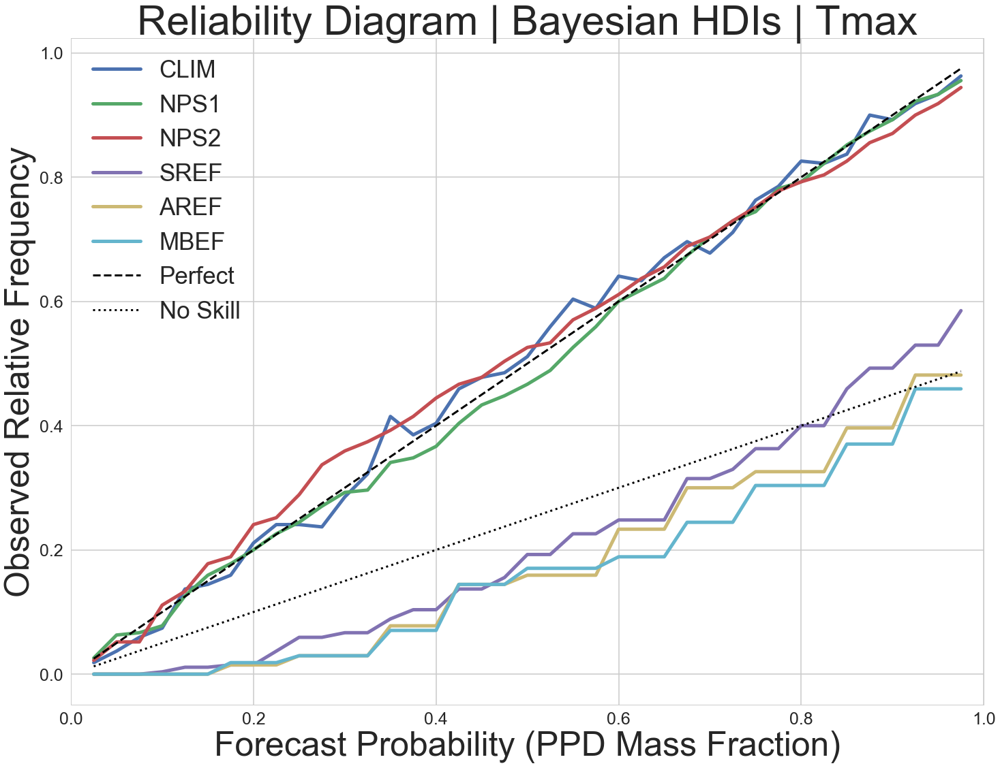

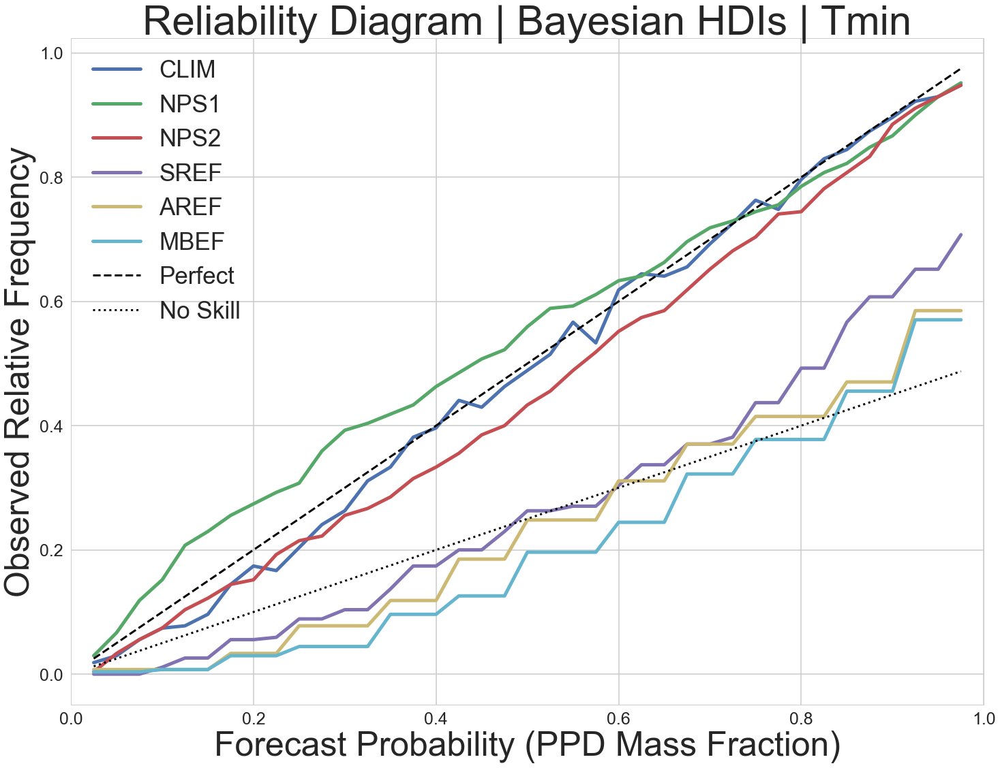

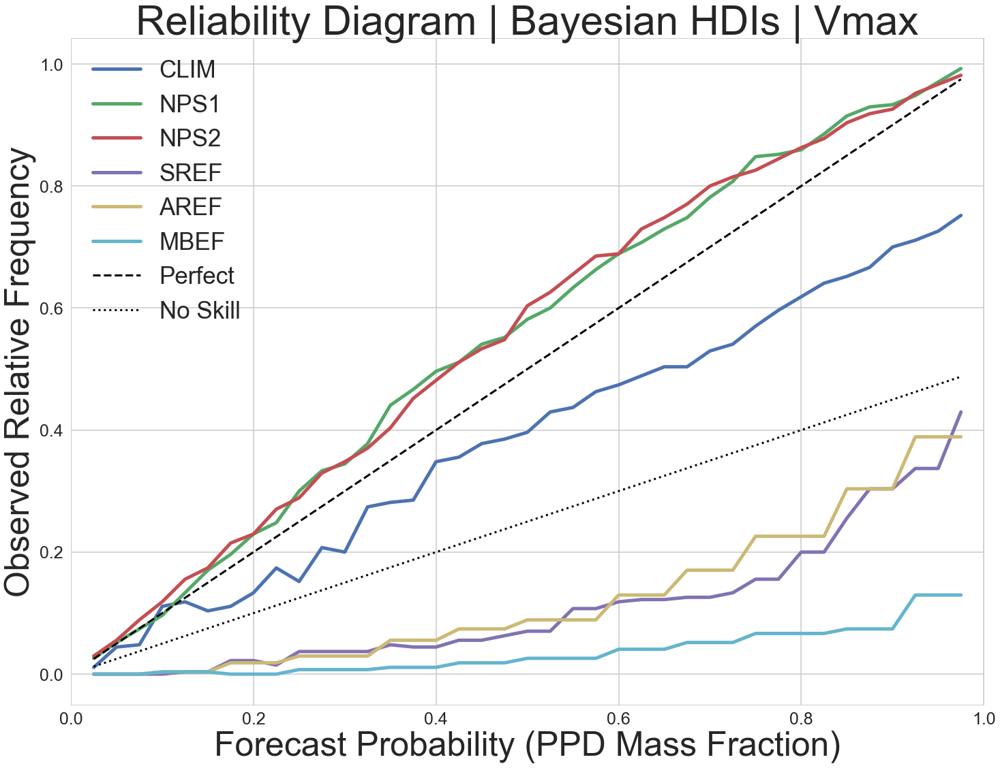

In [39]:
ts = 60
fs = 50
ls = 25

clrA = 1/3
clrB = 2/3

for i,vn in enumerate(varNames):

    df = dfRD.xs(vn,level='Variable').reset_index()
    dm = pd.melt(df,id_vars=['Probability'], value_vars=distList)
    rd = dm.groupby(['Probability','variable']).sum()/(len(cityNames)*len(fDays))
   
    plt.figure(figsize=(24,18))
    
    for j,mdl in enumerate(distList):
        tempVar = rd.xs(mdl,level='variable').reset_index()
        plt.plot(tempVar.iloc[:,0],tempVar.iloc[:,1],
                 label=mdl, marker='', lw=5)
    plt.plot(ppList,ppList,label='Perfect', color = 'black', lw=3, ls = '--')
    plt.plot(ppList,0.5*ppList,label='No Skill', color = 'black', lw=3, ls = ':')

    plt.legend(prop={'size':35})
    plt.title('Reliability Diagram | Bayesian HDIs | ' + vn, fontsize=ts)
    plt.xlabel('Forecast Probability (PPD Mass Fraction)', fontsize=fs)
    plt.ylabel('Observed Relative Frequency', fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
    plt.gca().set_xlim(left=0,right=1)

### Linear logarithmic Score: Forecast Ignorance
Developed by Good (1952), this is a strictly proper score that considers the natural logarithm of the a priori probability density that the forecast distribution assigned to truth. In simple terms, it quantifies the probability density a forecast distribution assigned to the actual, observed outcome. [Scoring rule](https://en.wikipedia.org/wiki/Scoring_rule)

\begin{equation}
        LogS(p,\omega) = -\ln p(\omega) \tag*{[1]}
\end{equation}

[Good, I. J. (1952), “Rational Decisions,”Journal of the Royal Statistical Society, Ser. B, 14, 107–114](https://pdfs.semanticscholar.org/61f2/cbb40ae34df12d18cd60c1dd86f205424ada.pdf)

[Gneiting, T. and Raftery, A. E. (2004). Strictly proper scoring rules, prediction, and estimation. Technical Report no 463, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/raftery/Research/PDF/Gneiting2007jasa.pdf)

[Grimit, E. P., Gneiting, T., Berrocal, V. J. and Johnson, N. A. (2005). The continuous ranked probability score for circular variables and its application to mesoscale forecast ensemble verification. Technical Report no 493, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/research/reports/2006/tr493.pdf)

In [40]:
igsF1 = pd.DataFrame(igsF1)
igsF2 = pd.DataFrame(igsF2)
igsC = pd.DataFrame(igsC)
igsA = pd.DataFrame(igsA)
igsM = pd.DataFrame(igsM)
igsS = pd.DataFrame(igsS)

In [41]:
dfI0 = pd.DataFrame({'NPS1': igsF1.iloc[:,0].tolist(),
                     'NPS2': igsF2.iloc[:,0].tolist(),
                     'CLIM': igsC.iloc[:,0].tolist(),
                     'AREF': igsA.iloc[:,0].tolist(),
                     'MBEF': igsM.iloc[:,0].tolist(),
                     'SREF': igsS.iloc[:,0].tolist(),
                     'Day': dd,
                     'City': cs})

dfI1 = pd.DataFrame({'NPS1': igsF1.iloc[:,1].tolist(),
                     'NPS2': igsF2.iloc[:,1].tolist(),
                     'CLIM': igsC.iloc[:,1].tolist(),
                     'AREF': igsA.iloc[:,1].tolist(),
                     'MBEF': igsM.iloc[:,1].tolist(),
                     'SREF': igsS.iloc[:,1].tolist(),
                     'Day': dd,
                     'City': cs})

dfI2 = pd.DataFrame({'NPS1': igsF1.iloc[:,2].tolist(),
                     'NPS2': igsF2.iloc[:,2].tolist(),
                     'CLIM': igsC.iloc[:,2].tolist(),
                     'AREF': igsA.iloc[:,2].tolist(),
                     'MBEF': igsM.iloc[:,2].tolist(),
                     'SREF': igsS.iloc[:,2].tolist(),
                     'Day': dd,
                     'City': cs})

dfI0 = dfI0.set_index(['City','Day'])
dfI1 = dfI1.set_index(['City','Day'])
dfI2 = dfI2.set_index(['City','Day'])

dfIGS = pd.concat([dfI0,dfI1,dfI2],keys=['Tmax','Tmin','Vmax'],names=['Variable']).reorder_levels(['Variable','City','Day'],axis=0)
dfIGS = dfIGS[distList]

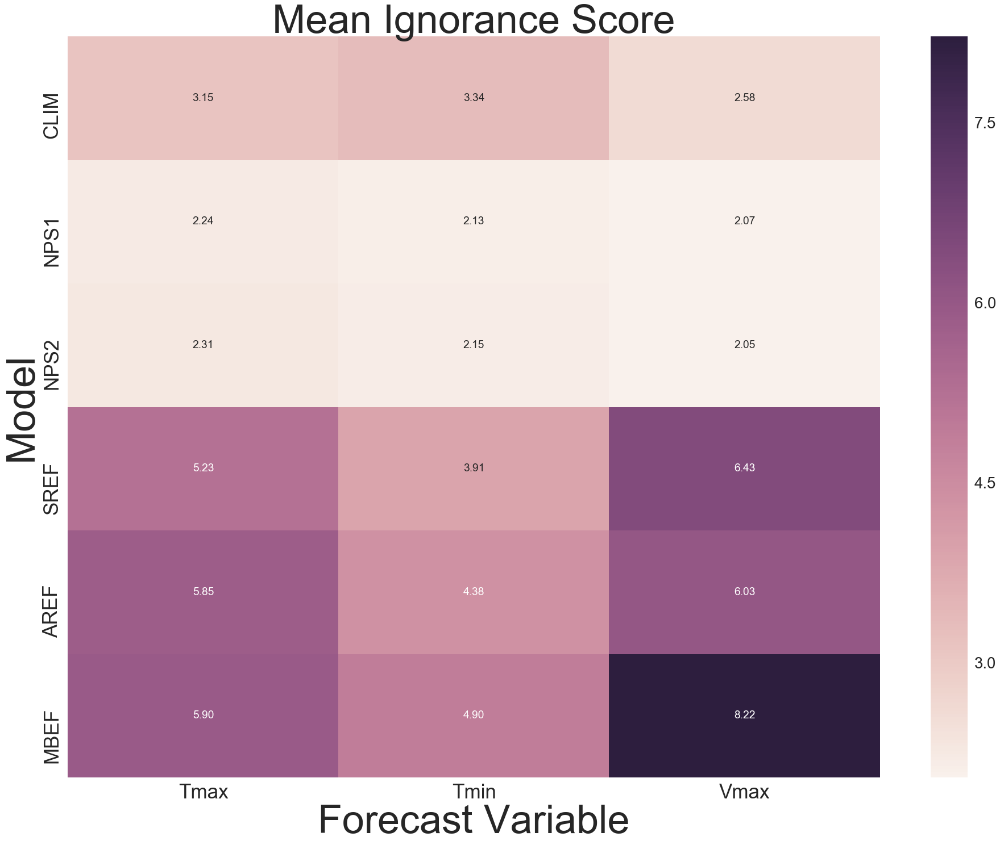

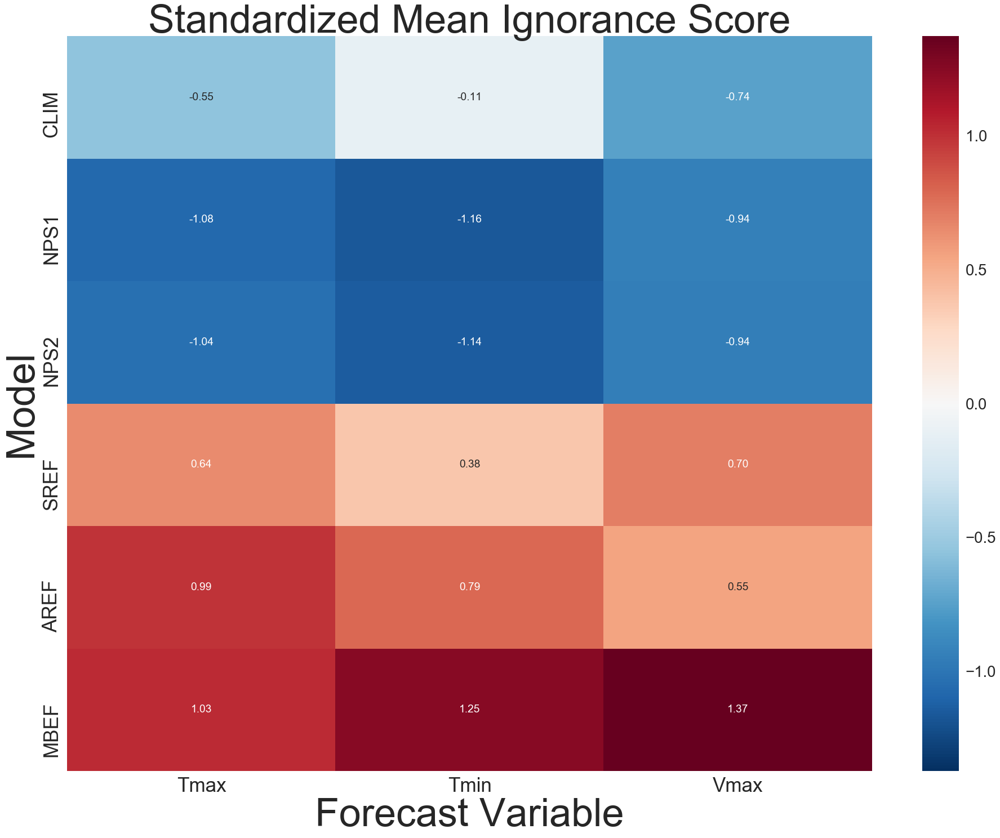

In [42]:
df = dfIGS.mean(level=['Variable'])

ts = 70
fs = 70
ls = 35

plt.figure(figsize=(32,24))
dh = df.T
sns.heatmap(dh,annot=True, fmt='.2f')
plt.title('Mean Ignorance Score', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

plt.figure(figsize=(32,24))
dh = (dh - dh.mean())/dh.std(ddof=1)
sns.heatmap(dh,annot=True, fmt='.2f', center = 0)
plt.title('Standardized Mean Ignorance Score', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

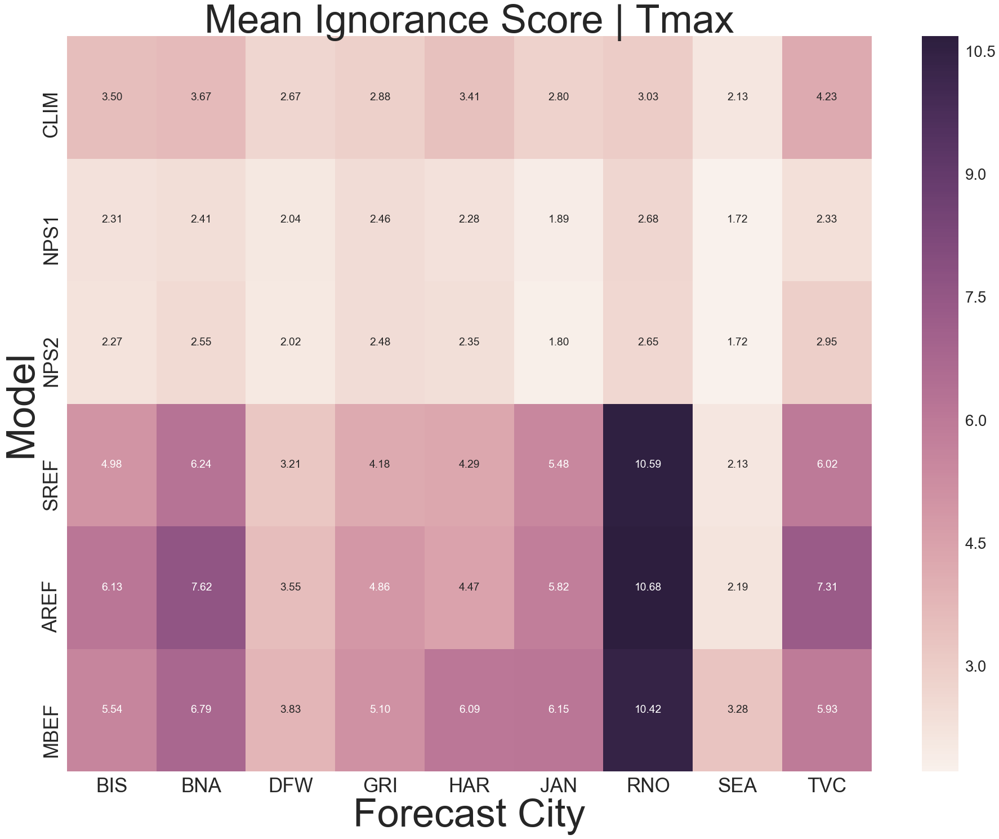

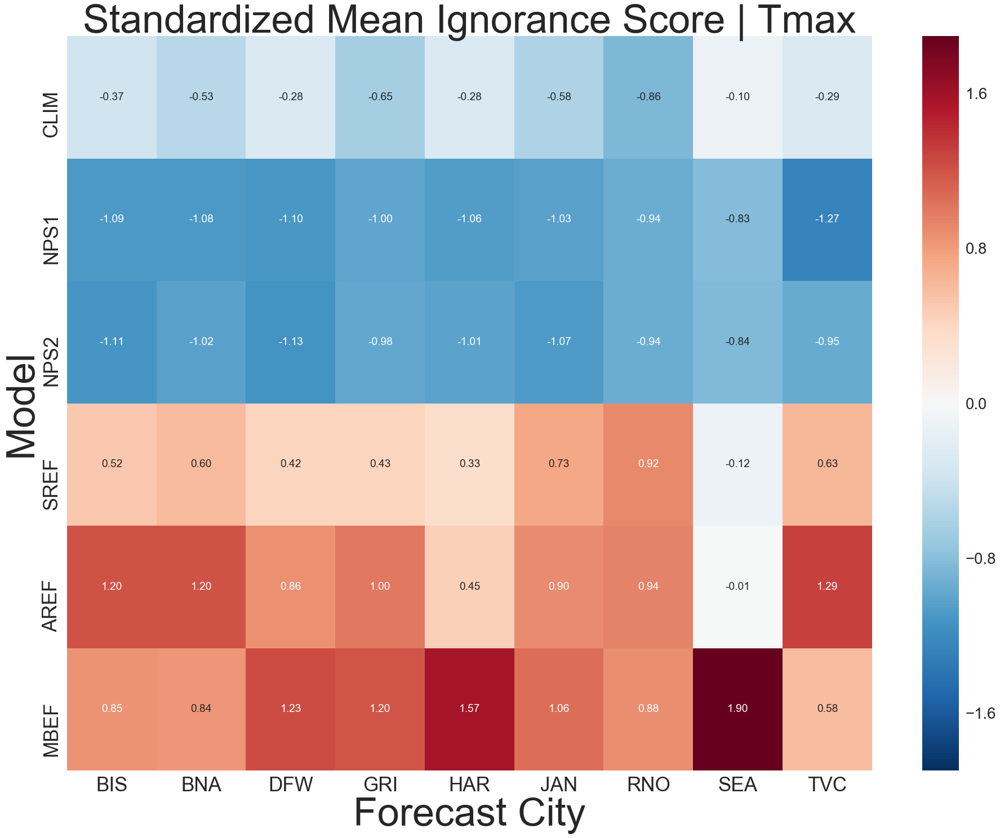

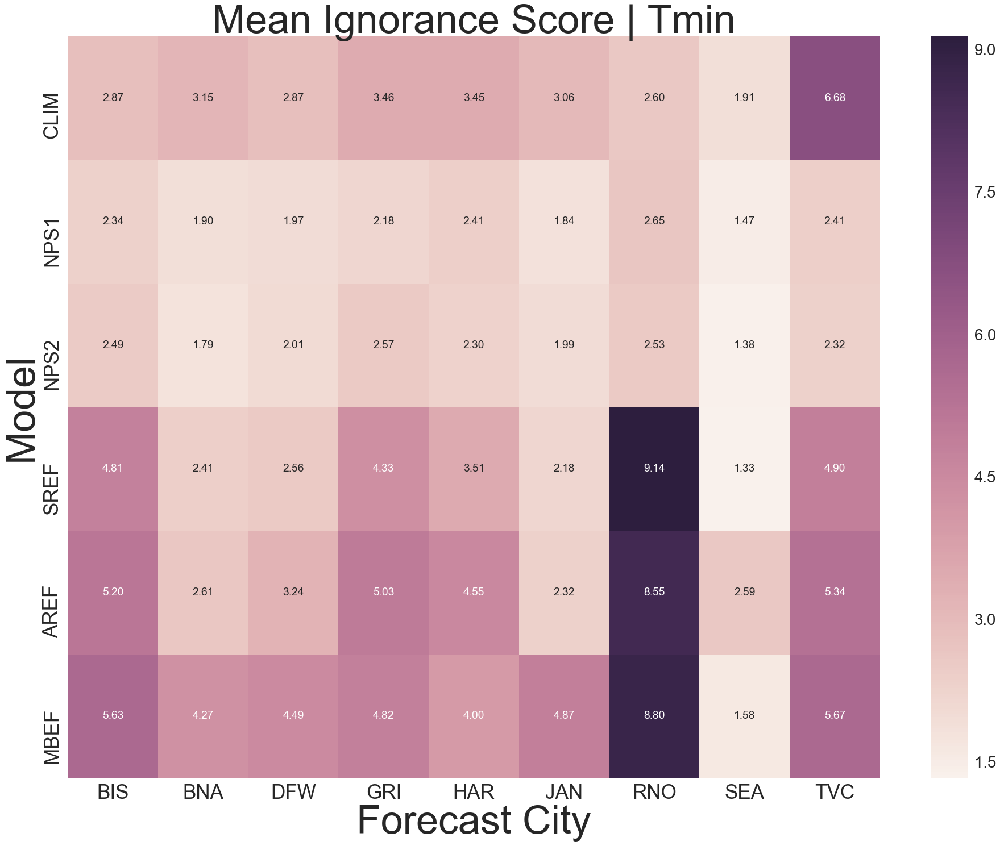

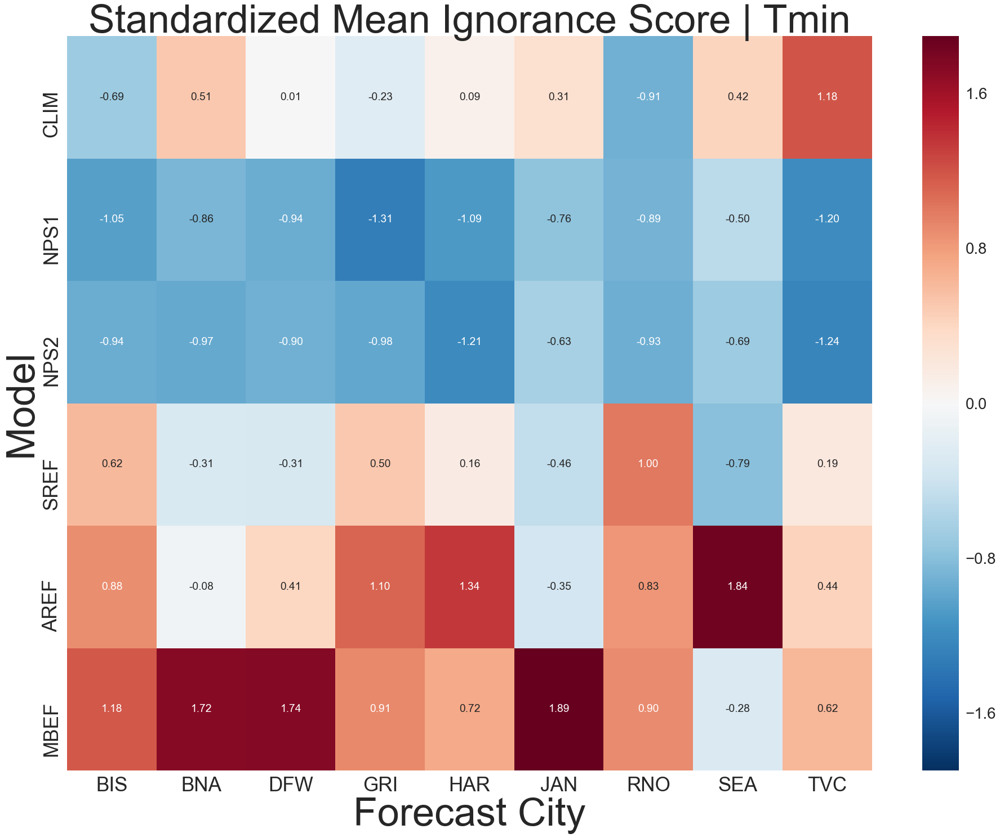

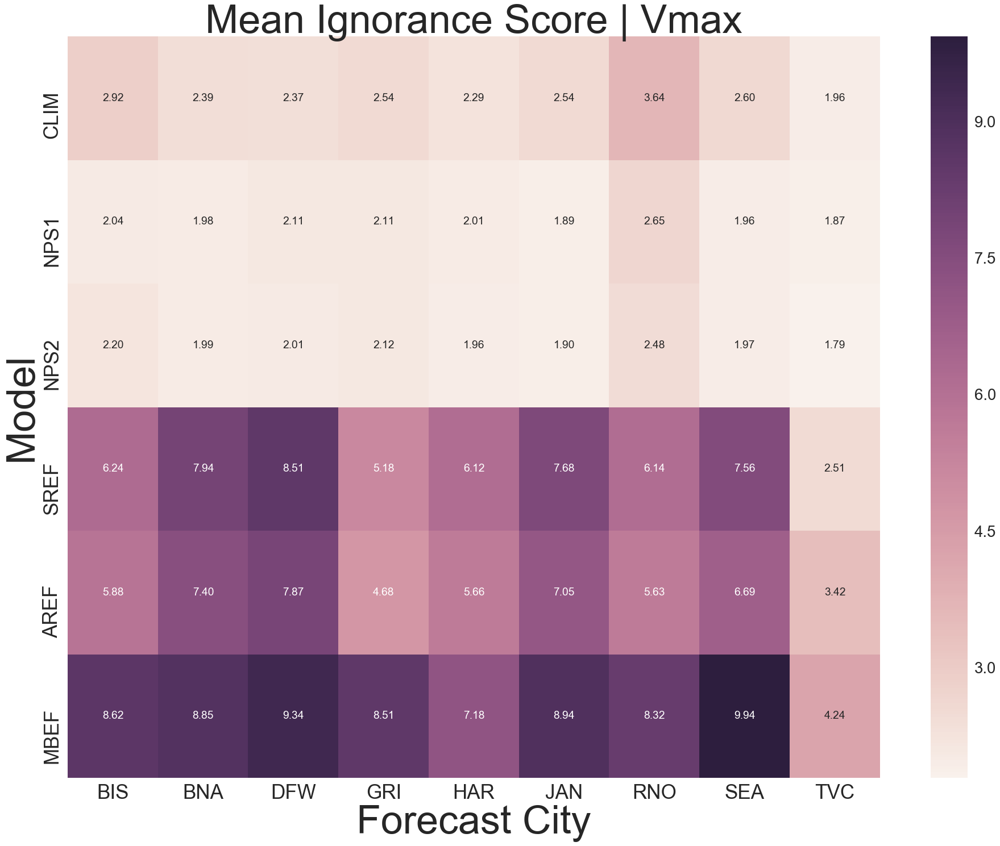

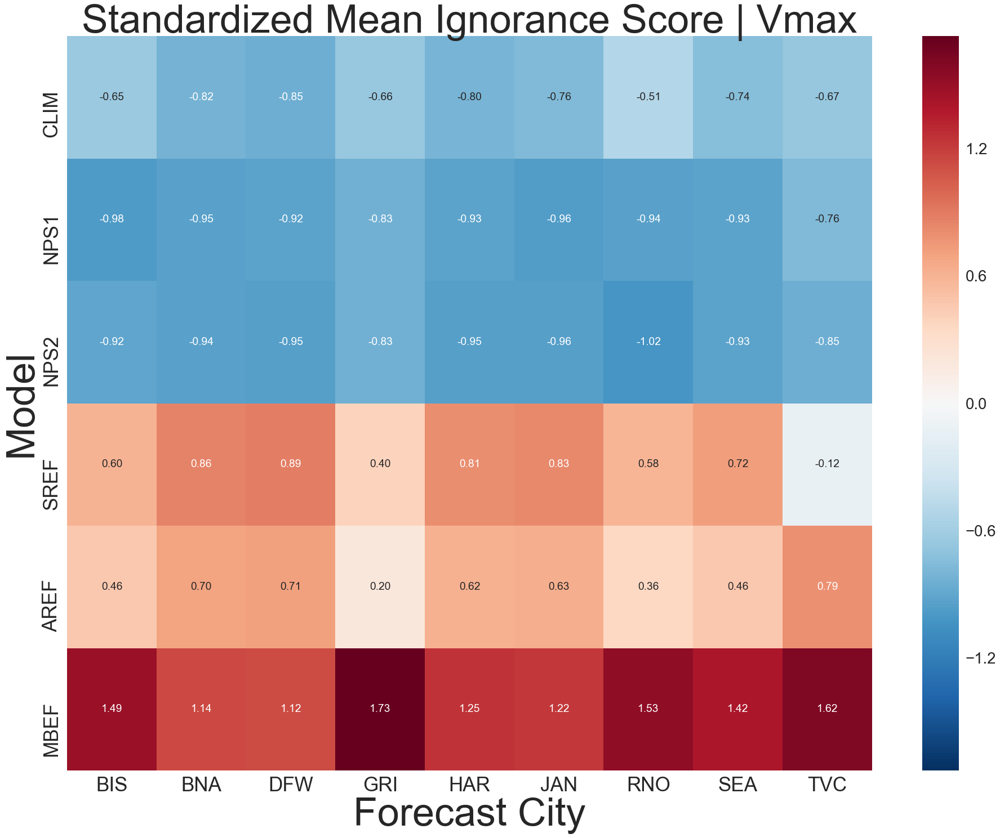

In [43]:
df = dfIGS.mean(level=['Variable','City'])

ts = 70
fs = 70
ls = 35


for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Ignorance Score | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
    
    dh = (dh - dh.mean())/dh.std(ddof=1)
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized Mean Ignorance Score | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

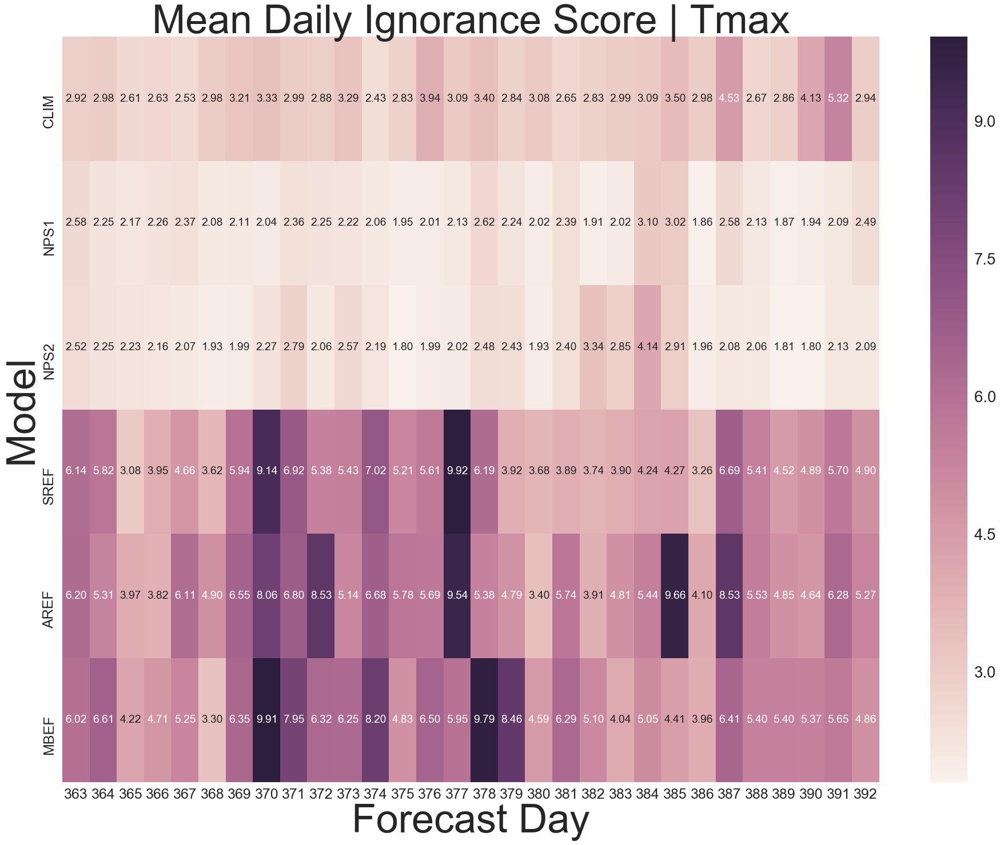

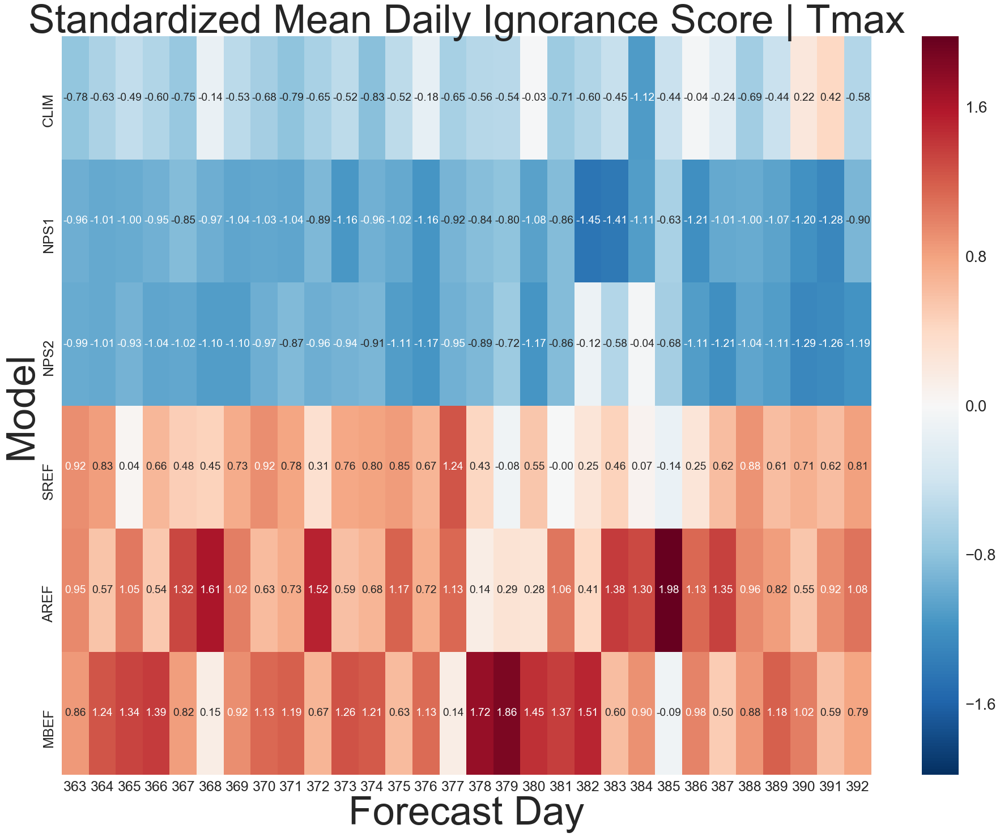

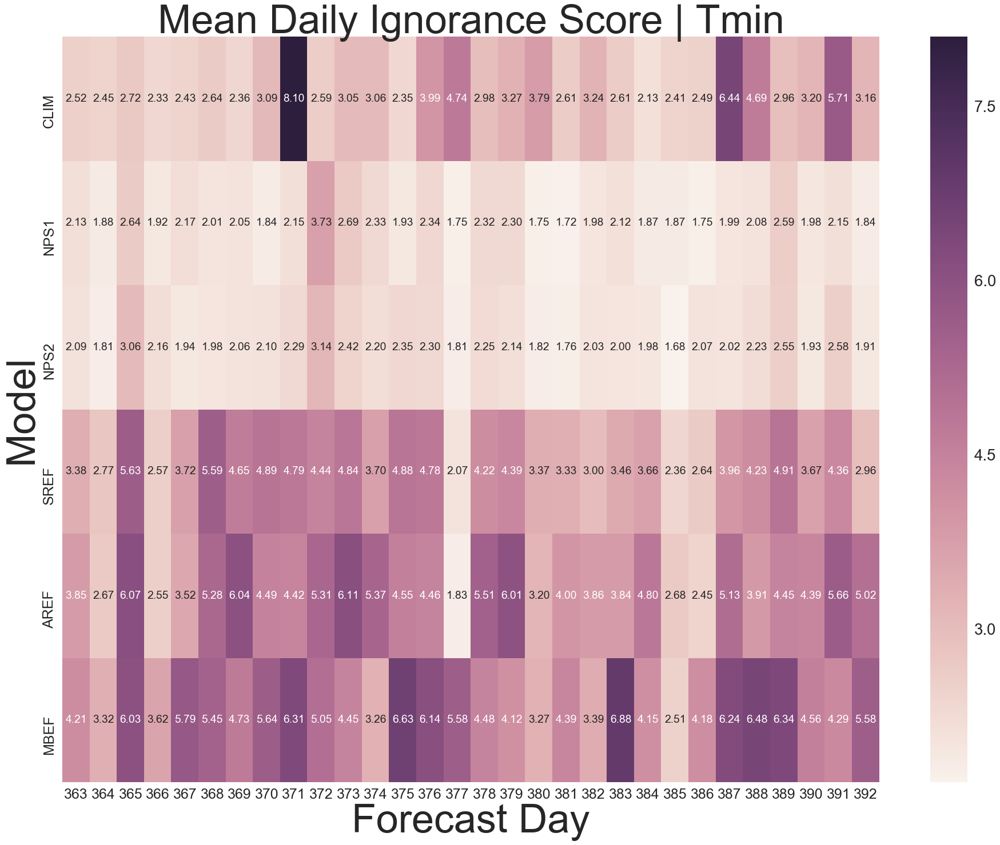

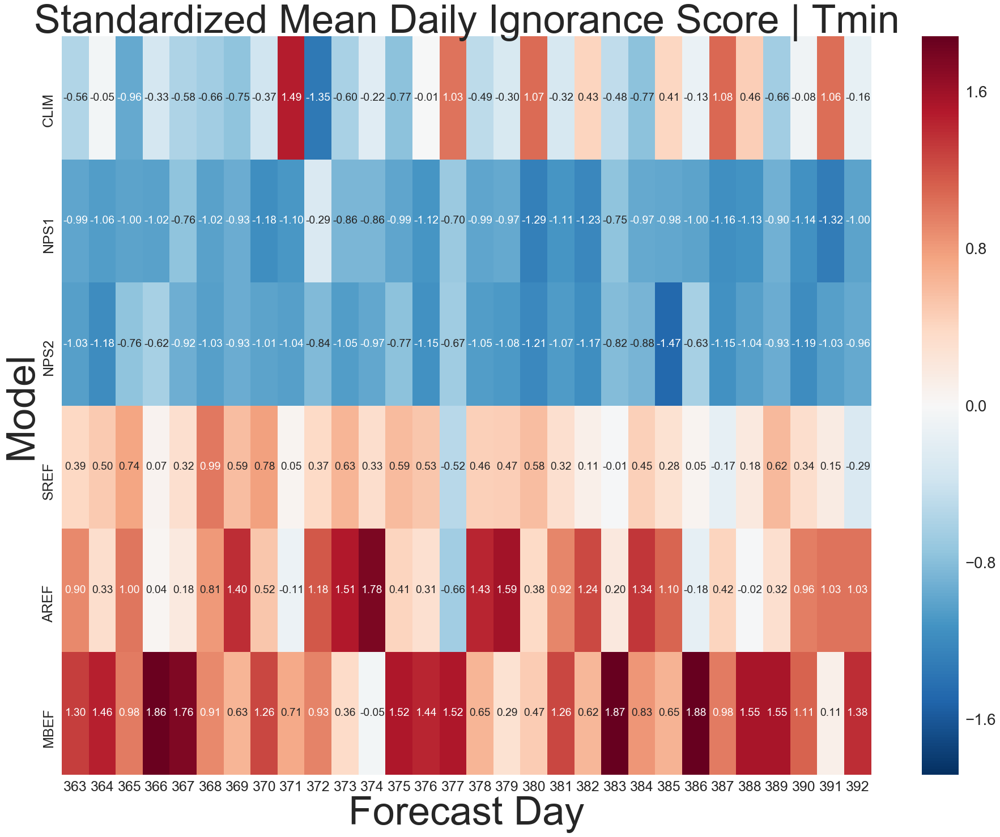

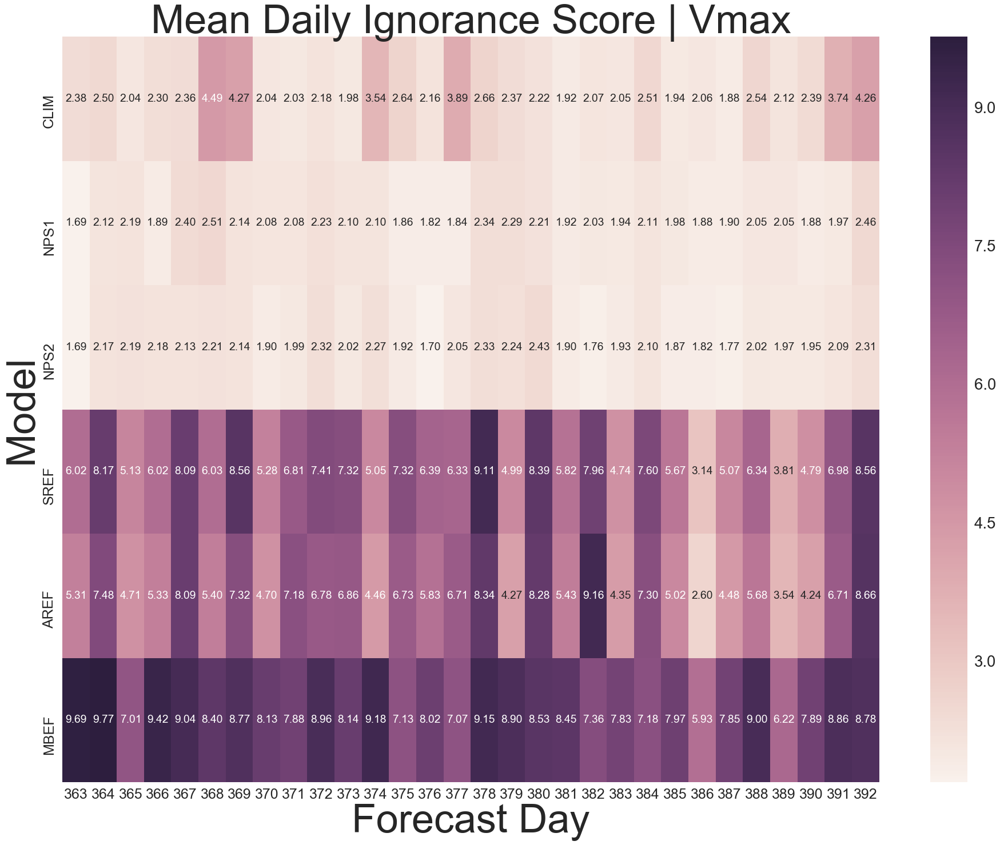

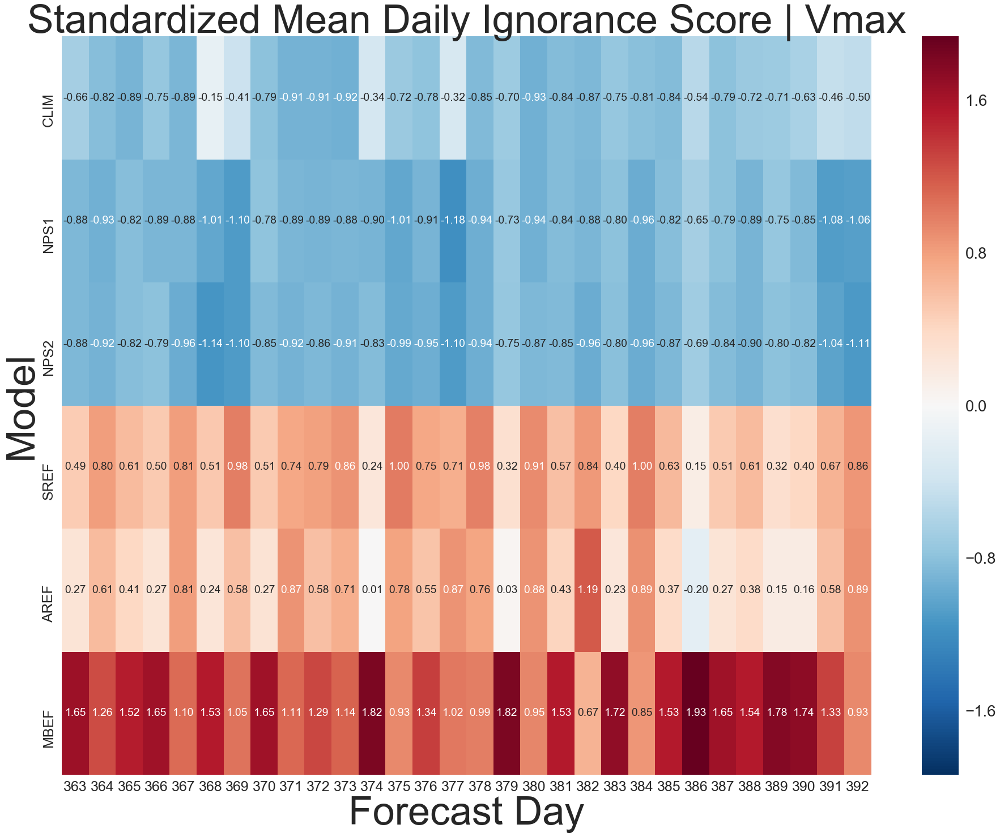

In [44]:
df = dfIGS.mean(level=['Variable','Day'])

ts = 70
fs = 70
ls = 25


for i, var in enumerate(varNames):
        
    plt.figure(figsize=(32,24))
    dh = df.ix[var].T
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Daily Ignorance Score | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
        
    plt.figure(figsize=(32,24))
    dh = (dh - dh.mean())/dh.std(ddof=1)
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized Mean Daily Ignorance Score | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

### Linear Continuous Ranked Probability Score (CRPS)
Gneiting and Raftery (2004) introduce the CRPS as a strictly proper scoring rule that works directly on the cumulative distribution function of a probabilistic forecast, which is convenient for empirically-derived forecast distributions that lack an explit or obvious parametric representation. It also represents a continuous analogue of both the Brier score and the mean aboslute error (MAE) - the latter appearing directly in equation [2] below. This interpretation is particularly useful, as it permits a direct comparison of mean aboslute error between discrete and probabilistic forecast estimates in the native units of the predictand. [CRPS](https://www.lokad.com/continuous-ranked-probability-score)

\begin{equation}
        CRPS(F,x) = \int_{-\infty}^{\infty} \big[ F(y) - \mathcal{H}(y-x)\big]^2 dy \tag*{[1]}
\end{equation}
$$ $$
\begin{equation}
        CRPS(F_{ens},x) = \frac{1}{M} \sum_{m=1}^{M} \left|x_m - x\right| - \frac{1}{2M^2} \sum_{m=1}^{M}\sum_{n=1}^{M} \left|x_m - x_n\right| \tag*{[2]}
\end{equation}

<img src="http://www.bom.gov.au/water/ssf/faq/CRPS.png" style="width: 600px">

[Gneiting, T. and Raftery, A. E. (2004). Strictly proper scoring rules, prediction, and estimation. Technical Report no 463, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/raftery/Research/PDF/Gneiting2007jasa.pdf)
    
[Grimit, E. P., Gneiting, T., Berrocal, V. J. and Johnson, N. A. (2005). The continuous ranked probability score for circular variables and its application to mesoscale forecast ensemble verification. Technical Report no 493, Department of Statistics, University of Washington, Seattle, Washington, USA.](https://www.stat.washington.edu/research/reports/2006/tr493.pdf)

In [45]:
crpsF1 = pd.DataFrame(crpsF1)
crpsF2 = pd.DataFrame(crpsF2)
crpsC = pd.DataFrame(crpsC)
crpsA = pd.DataFrame(crpsA)
crpsM = pd.DataFrame(crpsM)
crpsS = pd.DataFrame(crpsS)

In [46]:
dfC0 = pd.DataFrame({'NPS1': crpsF1.iloc[:,0].tolist(),
                     'NPS2': crpsF2.iloc[:,0].tolist(),
                     'CLIM': crpsC.iloc[:,0].tolist(),
                     'AREF': crpsA.iloc[:,0].tolist(),
                     'MBEF': crpsM.iloc[:,0].tolist(),
                     'SREF': crpsS.iloc[:,0].tolist(),
                     'Day': dd,
                     'City': cs})

dfC1 = pd.DataFrame({'NPS1': crpsF1.iloc[:,1].tolist(),
                     'NPS2': crpsF2.iloc[:,1].tolist(),
                     'CLIM': crpsC.iloc[:,1].tolist(),
                     'AREF': crpsA.iloc[:,1].tolist(),
                     'MBEF': crpsM.iloc[:,1].tolist(),
                     'SREF': crpsS.iloc[:,1].tolist(),
                     'Day': dd,
                     'City': cs})

dfC2 = pd.DataFrame({'NPS1': crpsF1.iloc[:,2].tolist(),
                     'NPS2': crpsF2.iloc[:,2].tolist(),
                     'CLIM': crpsC.iloc[:,2].tolist(),
                     'AREF': crpsA.iloc[:,2].tolist(),
                     'MBEF': crpsM.iloc[:,2].tolist(),
                     'SREF': crpsS.iloc[:,2].tolist(),
                     'Day': dd,
                     'City': cs})

dfC0 = dfC0.set_index(['City','Day'])
dfC1 = dfC1.set_index(['City','Day'])
dfC2 = dfC2.set_index(['City','Day'])

dfCRPS = pd.concat([dfC0,dfC1,dfC2],keys=['Tmax','Tmin','Vmax'],names=['Variable']).reorder_levels(['Variable','City','Day'],axis=0)
dfCRPS = dfCRPS[distList]

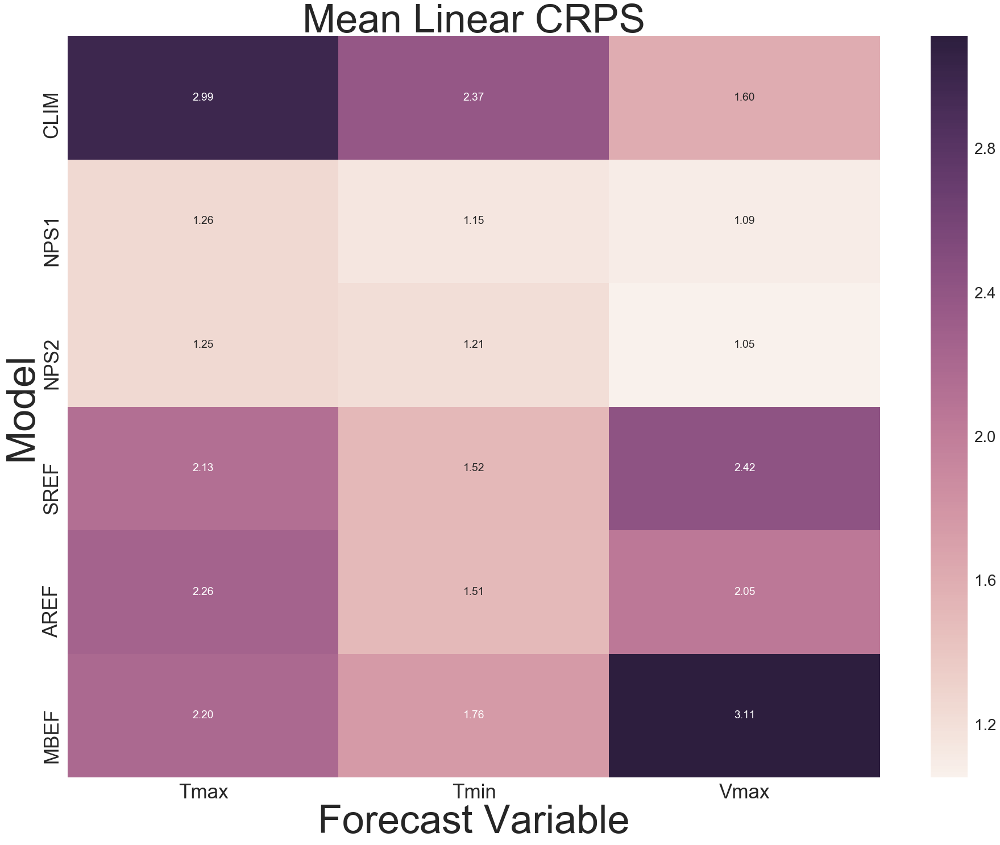

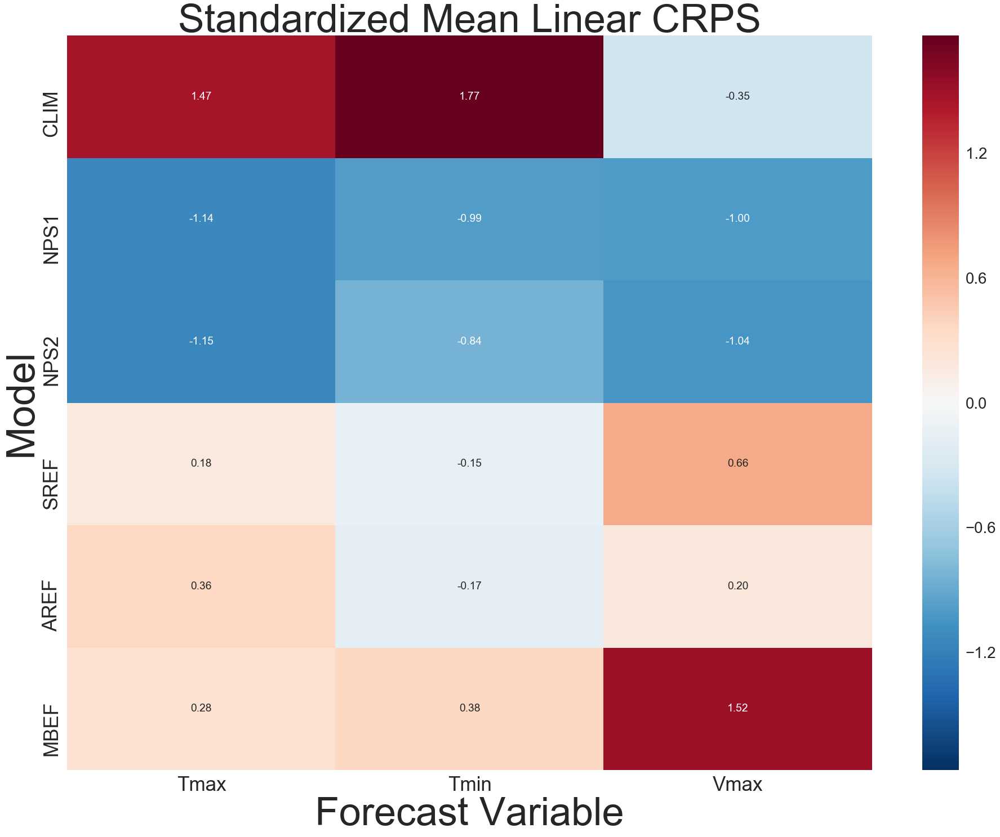

In [47]:
df = dfCRPS.mean(level=['Variable'])

ts = 70
fs = 70
ls = 35

plt.figure(figsize=(32,24))
dh = df.T
sns.heatmap(dh,annot=True, fmt='.2f')
plt.title('Mean Linear CRPS', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

plt.figure(figsize=(32,24))
dh = (dh - dh.mean())/dh.std(ddof=1)
sns.heatmap(dh,annot=True, fmt='.2f', center = 0)
plt.title('Standardized Mean Linear CRPS', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

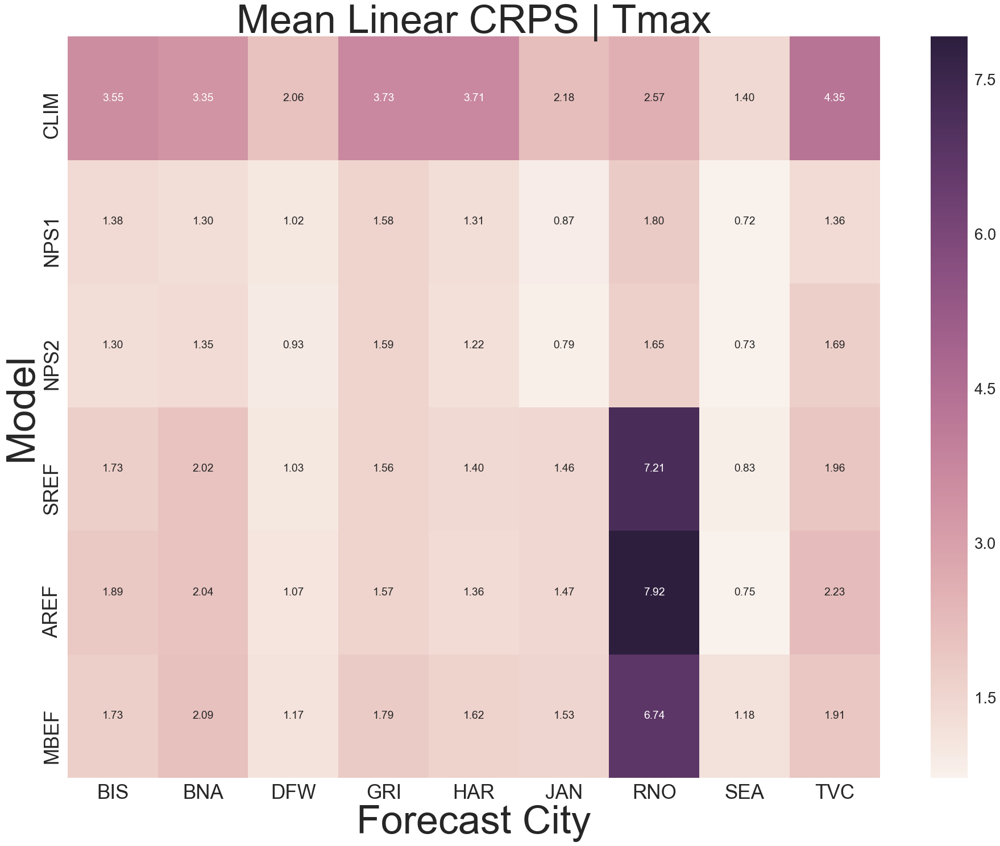

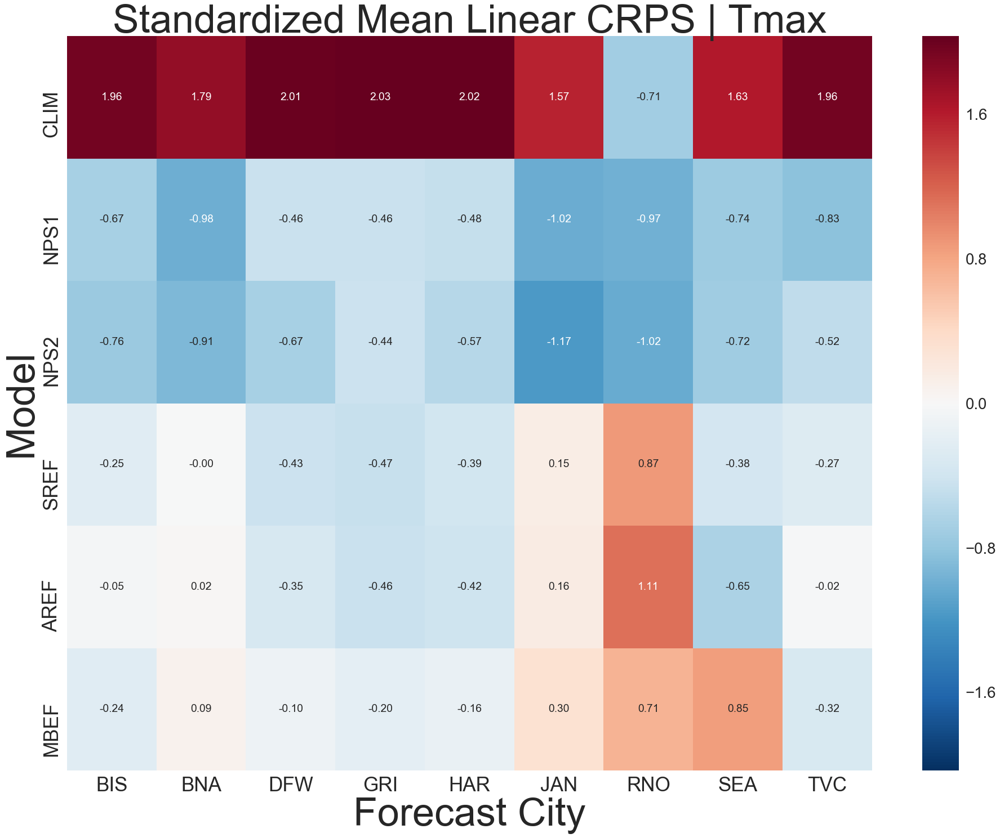

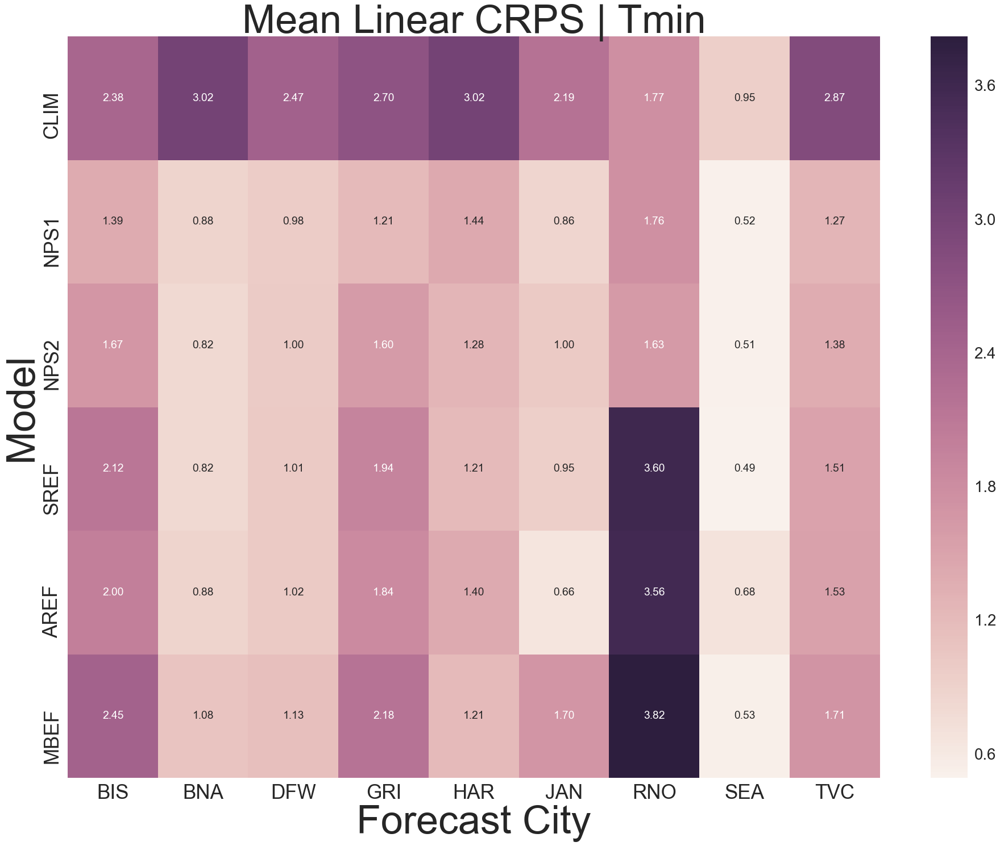

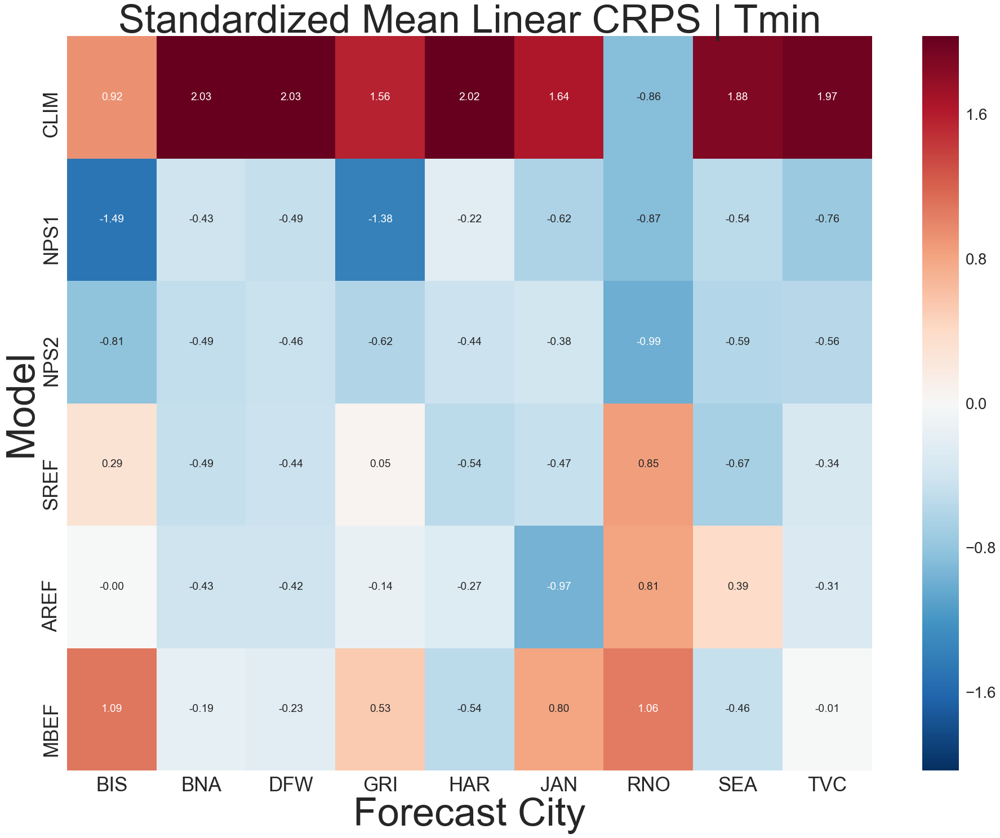

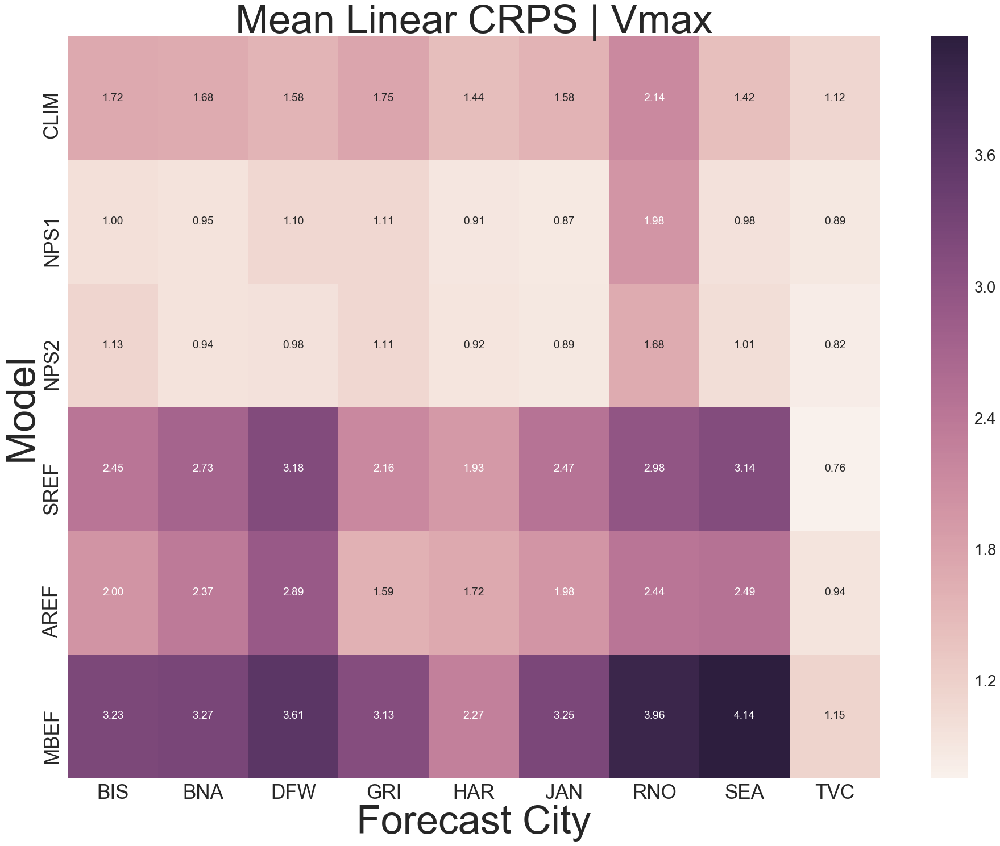

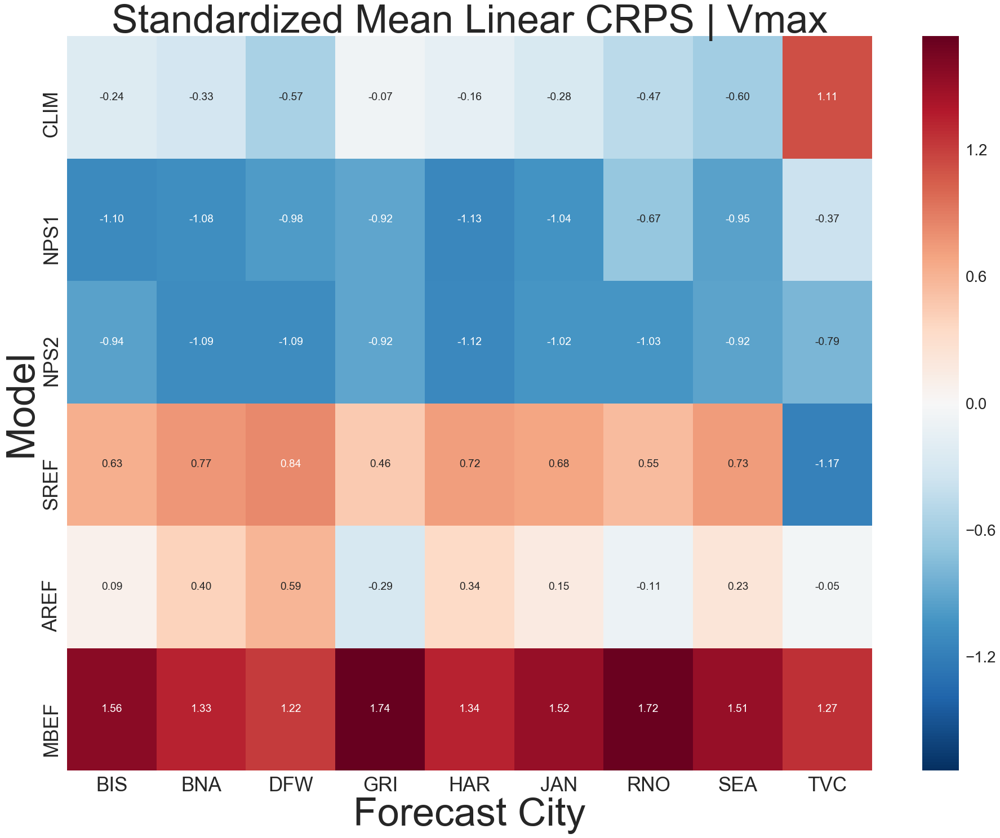

In [48]:
df = dfCRPS.mean(level=['Variable','City'])

ts = 70
fs = 70
ls = 35

for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Linear CRPS | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
    
    dh = (dh - dh.mean())/dh.std(ddof=1)
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized Mean Linear CRPS | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

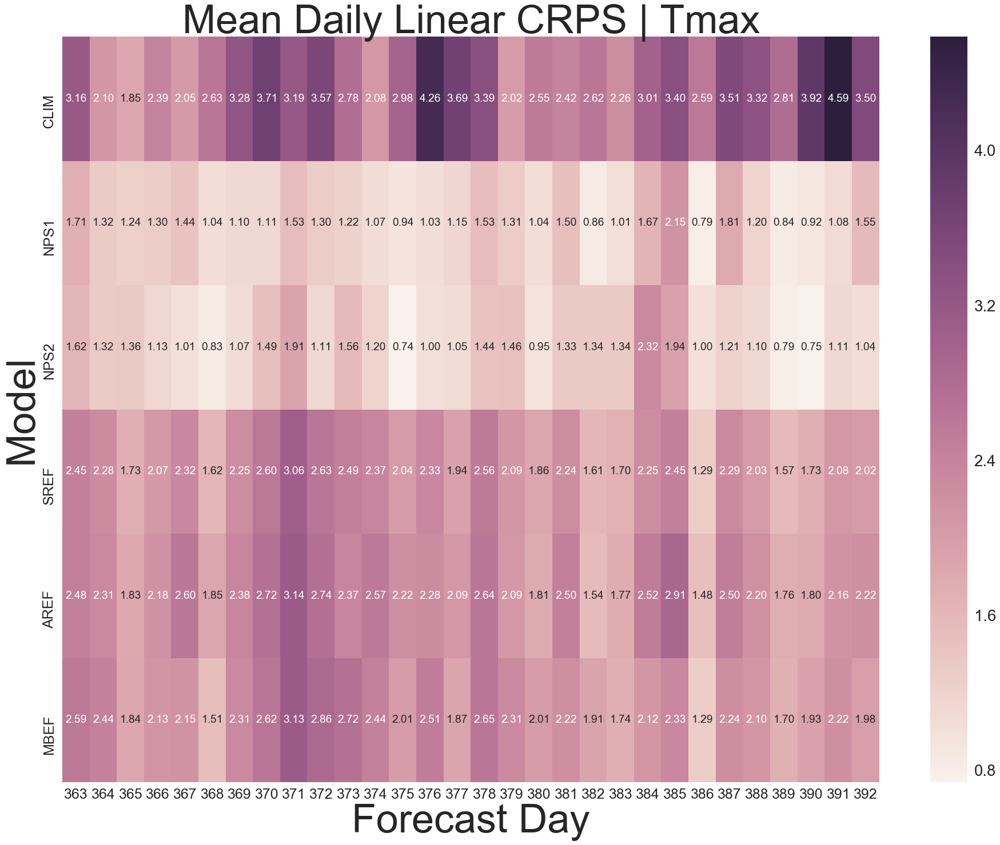

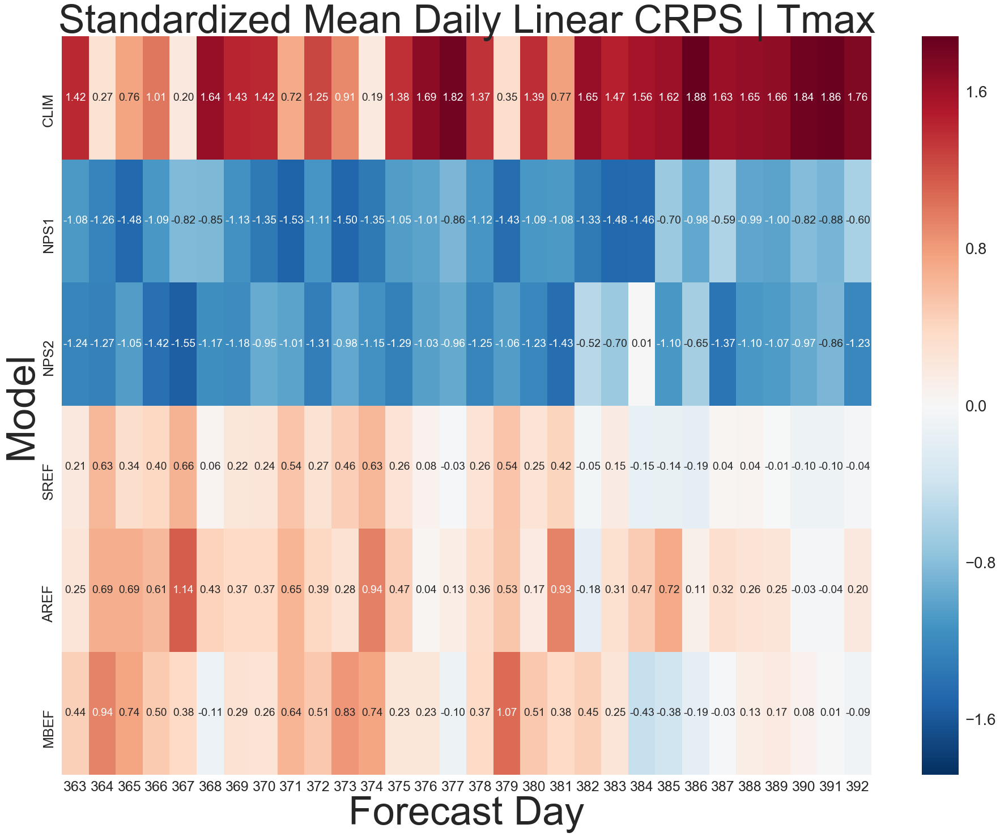

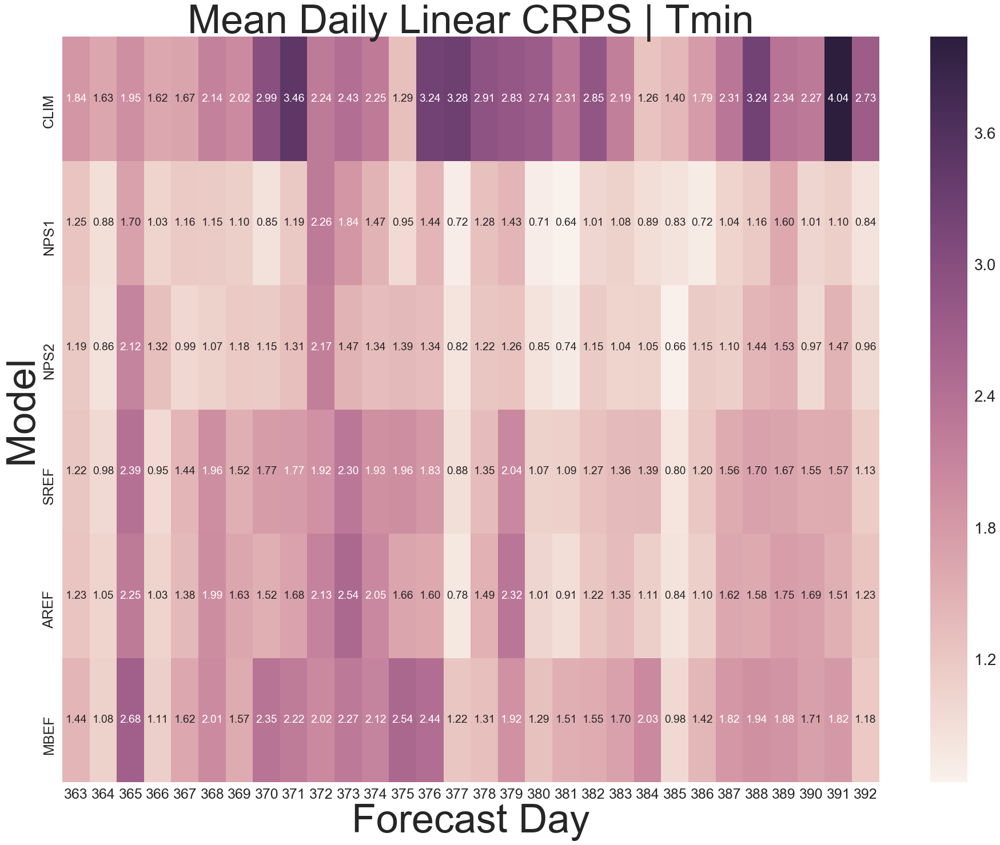

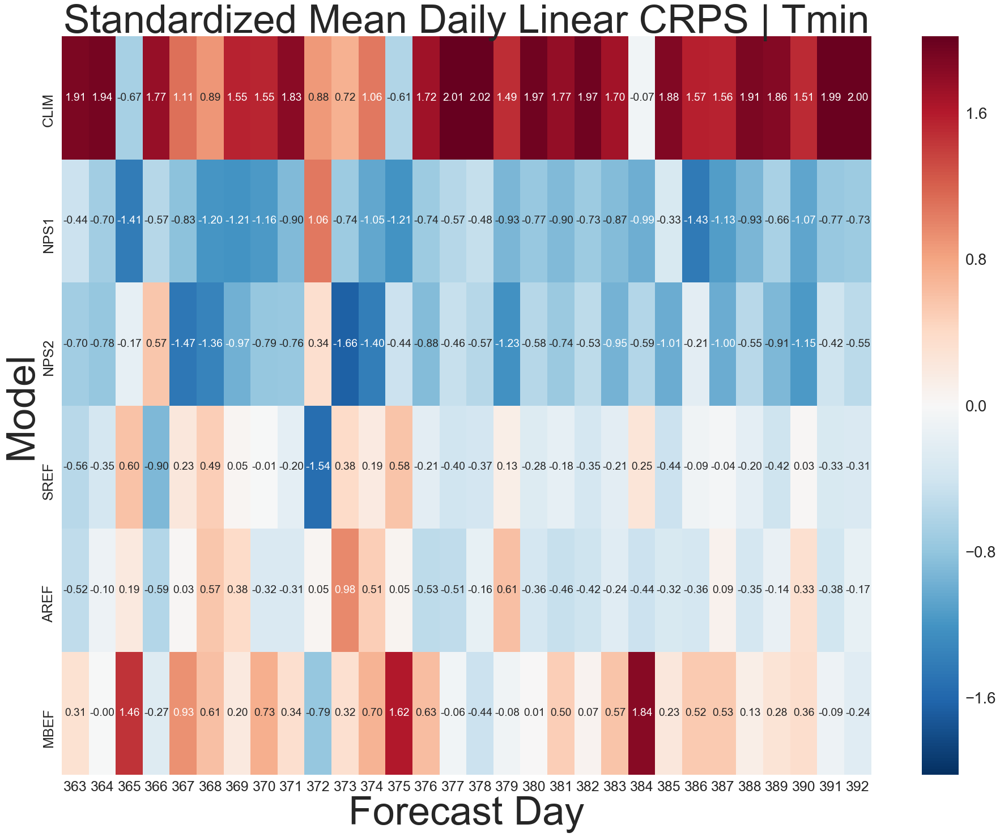

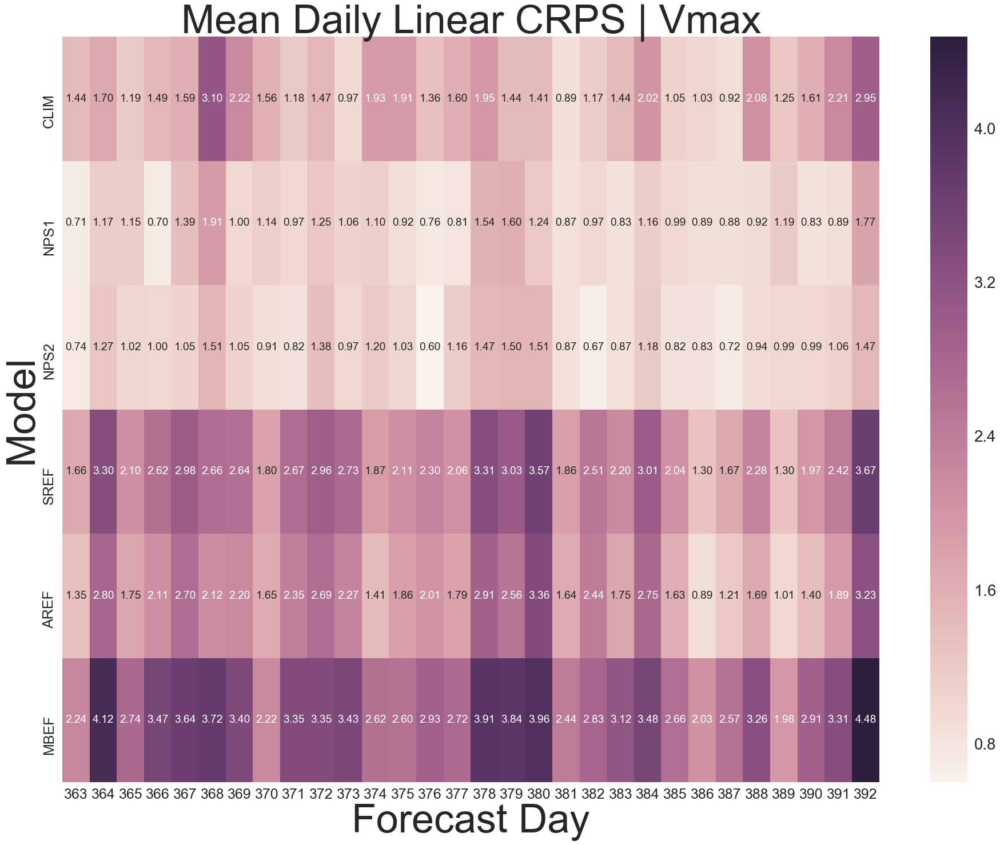

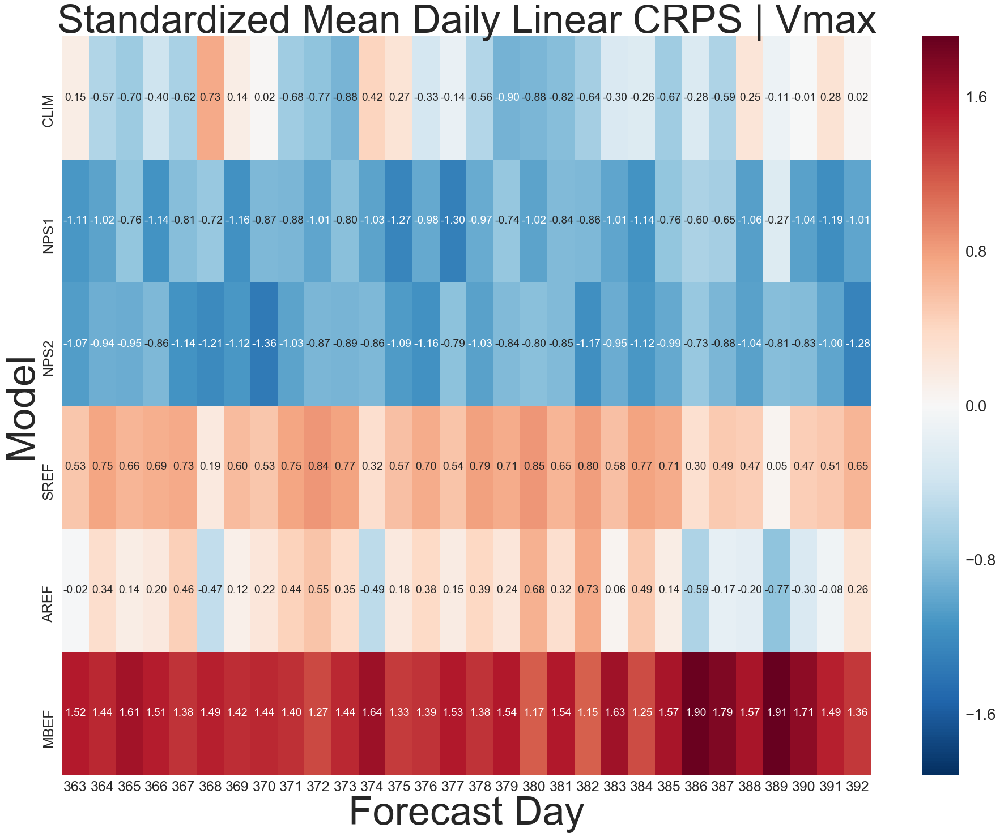

In [49]:
df = dfCRPS.mean(level=['Variable','Day'])

ts = 70
fs = 70
ls = 25

for i, var in enumerate(varNames):
        
    plt.figure(figsize=(32,24))
    dh = df.ix[var].T
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Daily Linear CRPS | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
        
    plt.figure(figsize=(32,24))
    dh = (dh - dh.mean())/dh.std(ddof=1)
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized Mean Daily Linear CRPS | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

## Measures-oriented Scoring

### Taylor Diagrams
Taylor diagrams provide three dimensions of scoring information in a two-dimensional polar plot. In particular, the Law of Cosines provides a convenient link between a modification of the canonical root mean square error - in this case, the mean-centered RMS difference - and the standard deviations of the forecasts and obeservations combined with their Pearson correlation coefficient. In particular,

\begin{equation}
        \hat{E}^2 = \sigma_f^2 + \sigma_o^2 - 2\sigma_f\sigma_o\rho, \tag*{[1]}
\end{equation}

where $\rho$ is the Pearson correlation coefficient, $\sigma_f$ and $\sigma_o$ are the standard deviations for the forecasts and observations, and $\hat{E}^2$ is the centered RMS deviation between them. In this way, "good" forecasts are identified by their proximity to the reference location along the $\rho = \cos(\phi)= 1$ radial - closer is better.

[Taylor diagram](https://en.wikipedia.org/wiki/Taylor_diagram)

<img src="https://www.ncl.ucar.edu/Applications/Images/taylor_4_1_lg.png" style="width: 500px">

[Taylor Diagram Primer (2005)](http://www-pcmdi.llnl.gov/about/staff/Taylor/CV/Taylor_diagram_primer.pdf)

[Taylor KE (2001) Summarizing multiple aspects of model performance in a single diagram. J Geophys Res 106:7183–7192](http://onlinelibrary.wiley.com/doi/10.1029/2000JD900719/abstract;jsessionid=49124CDF4E5DCCD5CB9691674E0AE448.f04t01)

[Taylor diagram via Yannick's Blog](http://yannick-copin.blogspot.com/2012/08/taylor-diagram.html)

[Taylor diagram implementation for python/matplotlib](https://gist.github.com/ycopin/3342888)

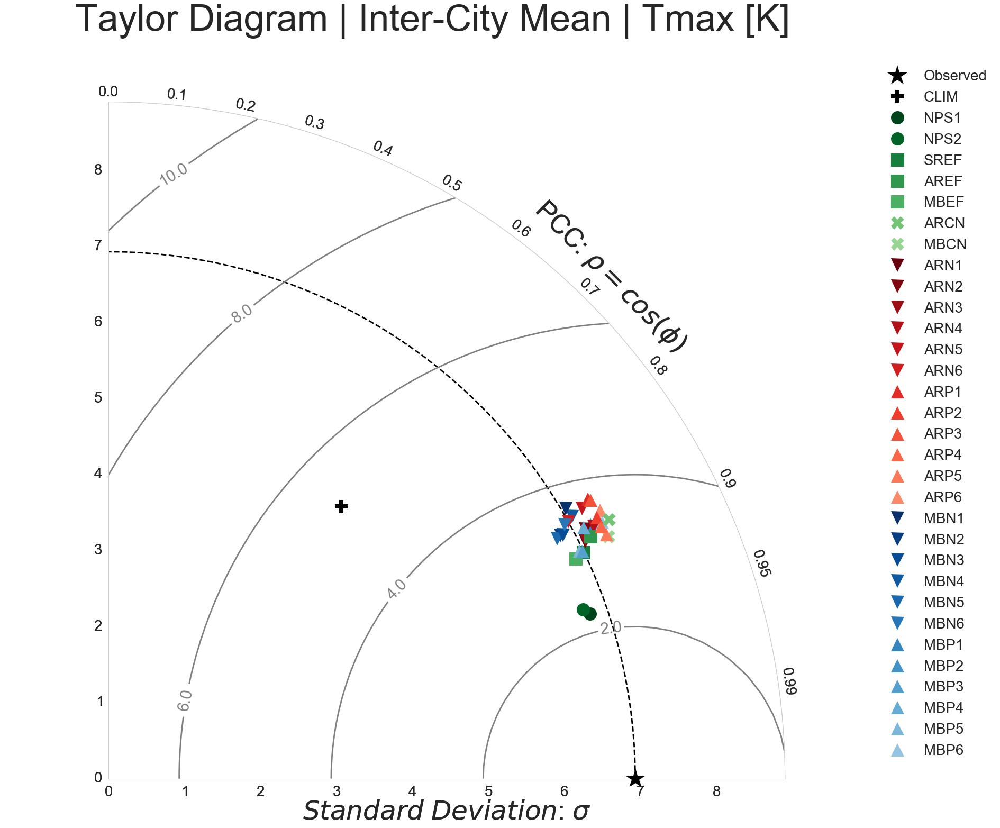

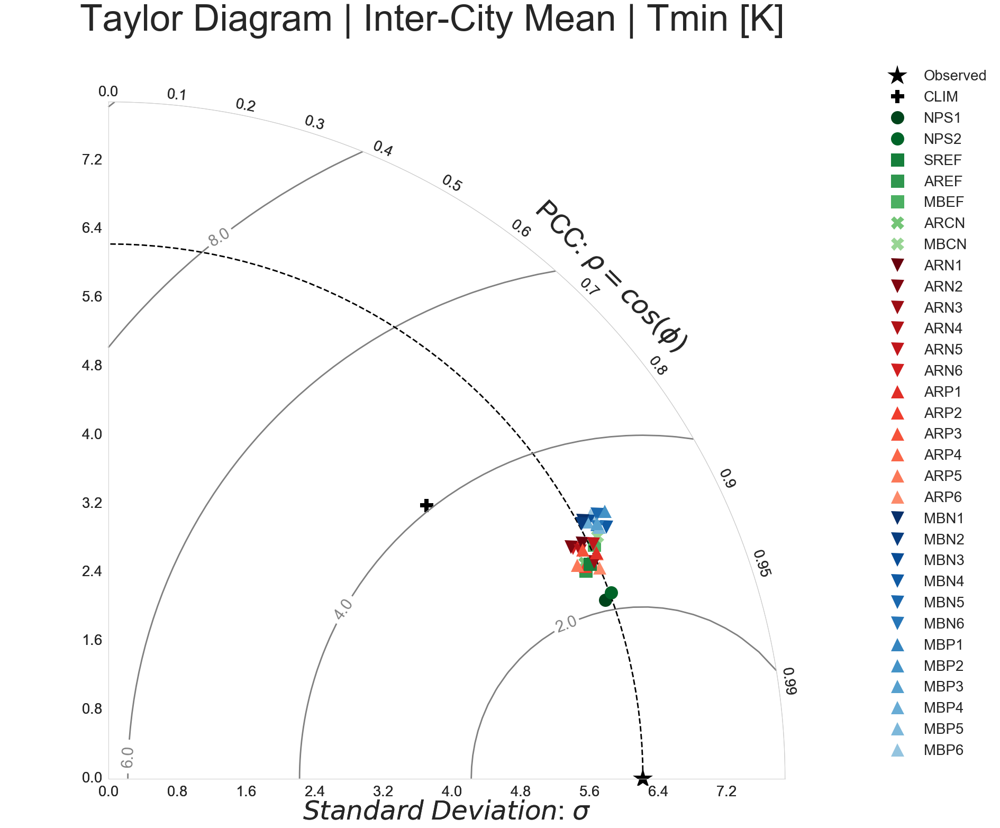

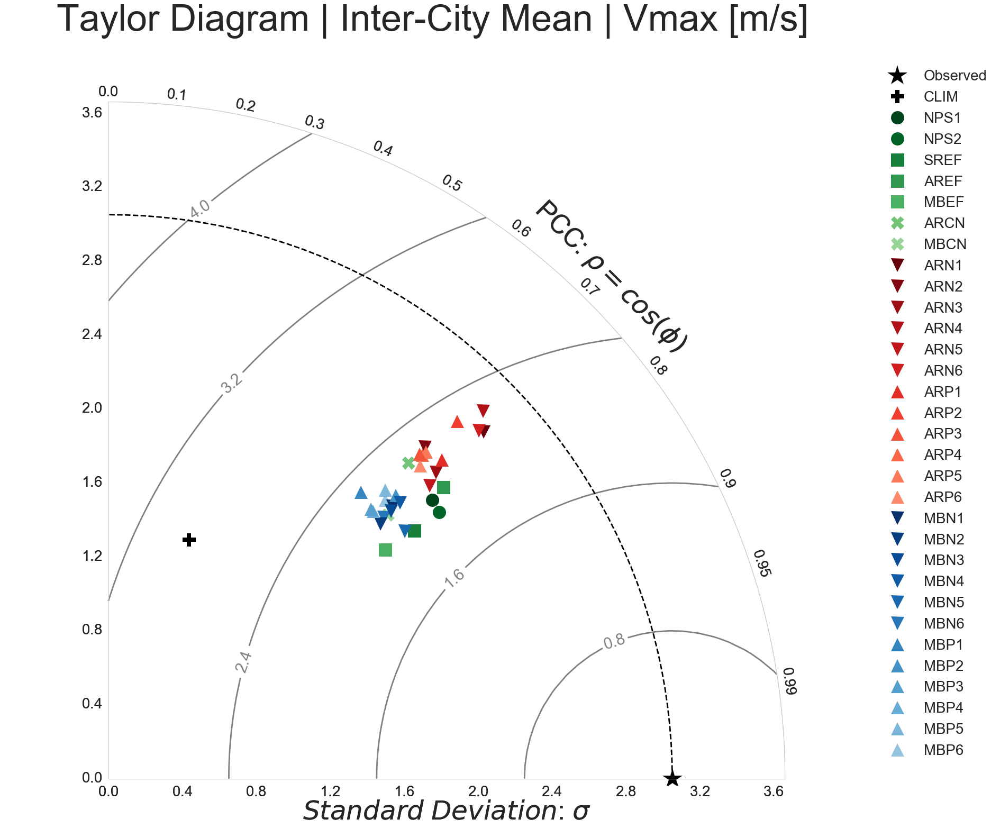

In [50]:
clrA = 0
clrB = 3/5

markerList = ['P',
              'o','o',
              's','s','s',
              'X','X',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^']

for iy, var in enumerate(varNames):
    
    dx = dfFF.xs([var],level=['Variable']).reset_index(drop=True)
    tempSamples = pd.concat((dx.std(ddof=1),dx.corr().OBS),axis=1)
    tempSamples.columns = ['sd','pcc']
    
    refstd = tempSamples.loc['OBS','sd']
    samples = tempSamples.drop('OBS',axis=0)
    
    modelNames = list(samples.index)
    
    fig = plt.figure(figsize=(30,24))
    dia = TaylorDiagram(refstd, np.max(samples.iloc[:,0]), fig=fig, label="Observed")
    clr0 = array([0,0,0,0]).reshape(1,-1)
    clr1 = plt.matplotlib.cm.Greens_r(np.linspace(clrA,clrB,7))
    clr2 = plt.matplotlib.cm.Reds_r(np.linspace(clrA,clrB,12))
    clr3 = plt.matplotlib.cm.Blues_r(np.linspace(clrA,clrB,12))
    clrs = np.concatenate((clr0,clr1,clr2,clr3),axis=0)

    # Add samples to Taylor diagram
    for i,(stddev,corrcoef) in enumerate(array(samples)):

        dia.add_sample(stddev, corrcoef,
                       # marker='$%d$' % (i+1),
                       marker = markerList[i],
                       ms=25, 
                       ls='',
                       alpha = 1,
                       mfc=clrs[i],
                       label=modelNames[i])

    # Add RMS contours, and label them
    contours = dia.add_contours(colors='0.5')
    plt.clabel(contours, inline=1, fontsize=30, fmt='%.1f')

    # Add a figure legend
    fig.legend(dia.samplePoints,
               [ p.get_label() for p in dia.samplePoints ],
               numpoints=1, prop=dict(size='x-large'), loc=5)

    fig.suptitle('Taylor Diagram | Inter-City Mean | ' + var + ' ' + unitNames[iy], fontsize = 70)
    # fig.tight_layout()

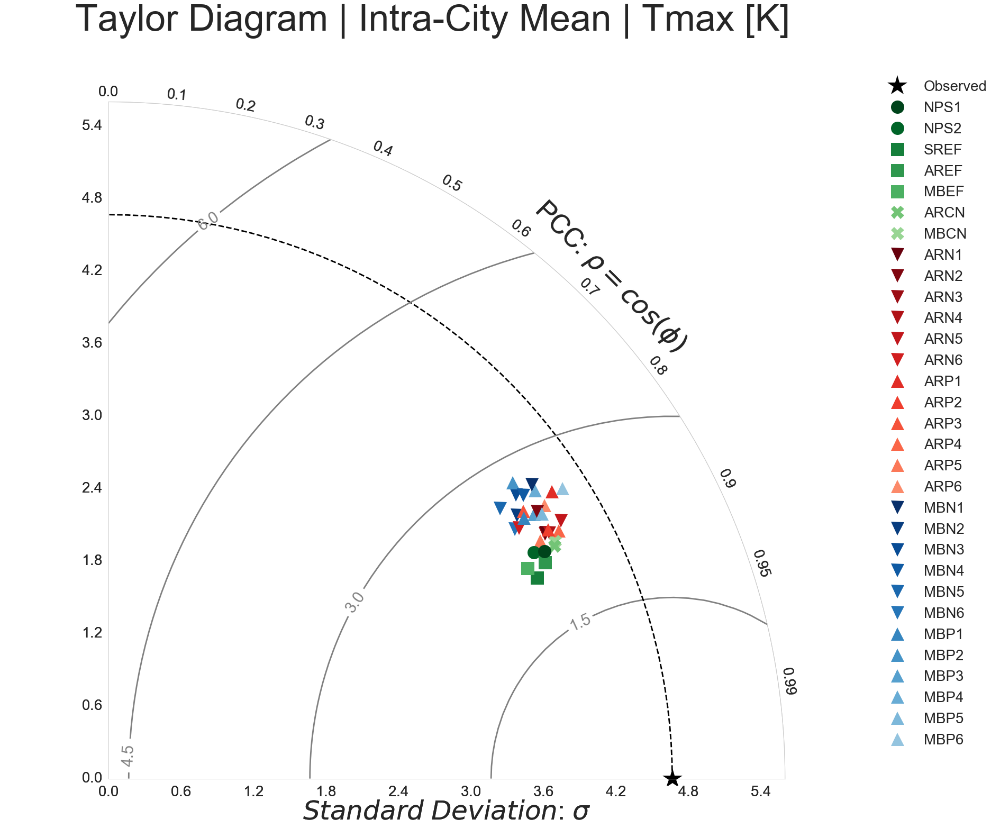

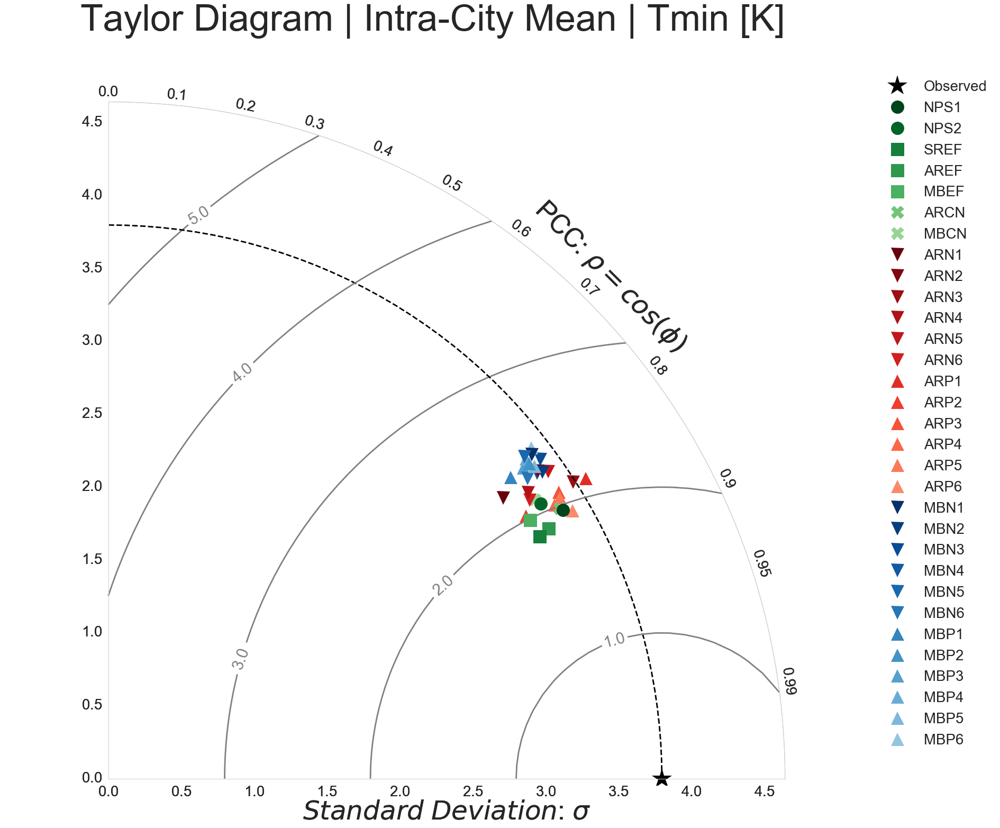

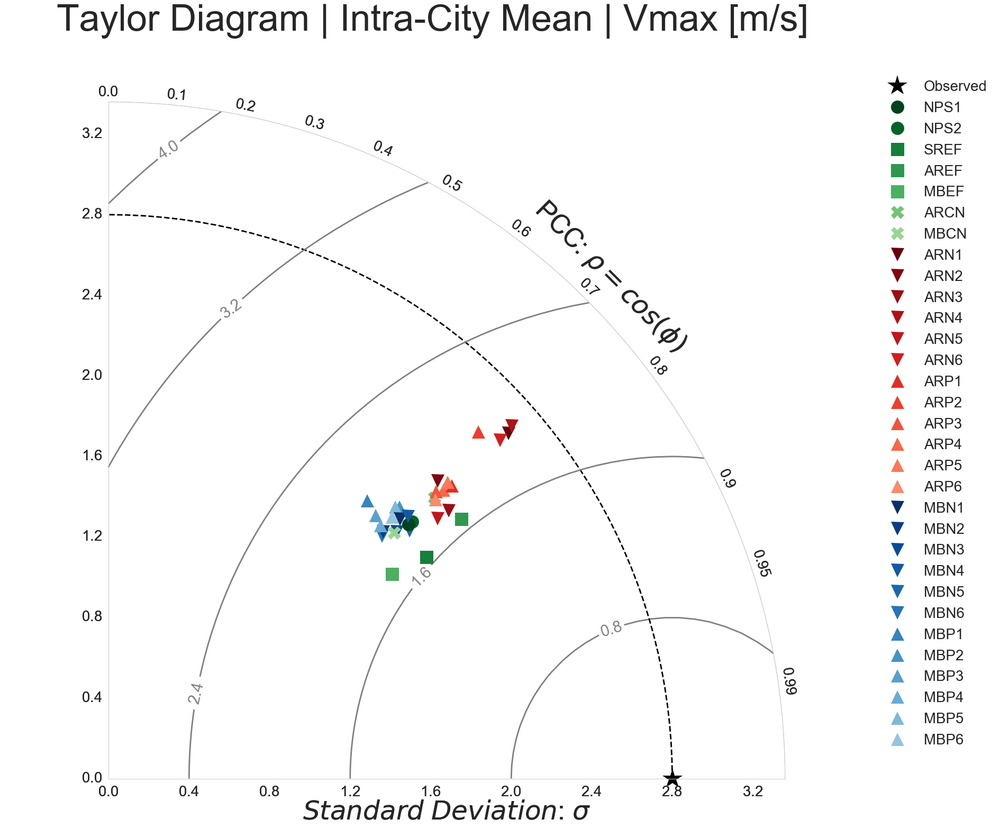

In [51]:
markerList = ['o','o',
              's','s','s',
              'X','X',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^']

for iy, var in enumerate(varNames):
    
    for ix, cty in enumerate(cityNames):
    
        dx = dfFF.xs([var,cty],level=['Variable','City']).reset_index(drop=True)
        tempSamples = pd.concat((dx.std(ddof=1),dx.corr().OBS),axis=1)
        tempSamples.columns = ['sd','pcc']
        tempSamples['City'] = cty
        tempSamples = tempSamples.drop('CLIM',axis=0)
        tempSamples = tempSamples.reset_index().rename(columns={'index': 'Model'}).set_index(['City','Model'])
               
        if ix == 0:
            
            TS = tempSamples.copy()
        
        else:
            
            TS = pd.concat((TS,tempSamples),ignore_index=False)
        
        del tempSamples

    refstd = TS.mean(level=1).loc['OBS','sd']
    samples = np.zeros((TS.mean(level=1).drop('OBS',axis=0).shape[0],2))
    
    for i, mdl in enumerate(taylorList):
        
        samples[i,:] = TS.mean(level=1).loc[mdl,:]
        
    modelNames = taylorList

    fig = plt.figure(figsize=(30,24))
    dia = TaylorDiagram(refstd, np.max(samples[:,0]), fig=fig, label="Observed")
    clr1 = plt.matplotlib.cm.Greens_r(np.linspace(clrA,clrB,7))
    clr2 = plt.matplotlib.cm.Reds_r(np.linspace(clrA,clrB,12))
    clr3 = plt.matplotlib.cm.Blues_r(np.linspace(clrA,clrB,12))
    clrs = np.concatenate((clr1,clr2,clr3),axis=0)

    # Add samples to Taylor diagram
    for i,(stddev,corrcoef) in enumerate(array(samples)):

        dia.add_sample(stddev, corrcoef,
                       # marker='$%d$' % (i+1),
                       marker = markerList[i],
                       ms=25, 
                       ls='',
                       alpha = 1,
                       mfc=clrs[i],
                       label=modelNames[i])

    # Add RMS contours, and label them
    contours = dia.add_contours(colors='0.5')
    plt.clabel(contours, inline=1, fontsize=30, fmt='%.1f')

    # Add a figure legend
    fig.legend(dia.samplePoints,
               [ p.get_label() for p in dia.samplePoints ],
               numpoints=1, prop=dict(size='x-large'), loc=5)

    fig.suptitle('Taylor Diagram | Intra-City Mean | ' + var + ' ' + unitNames[iy], fontsize = 70)
    # fig.tight_layout()

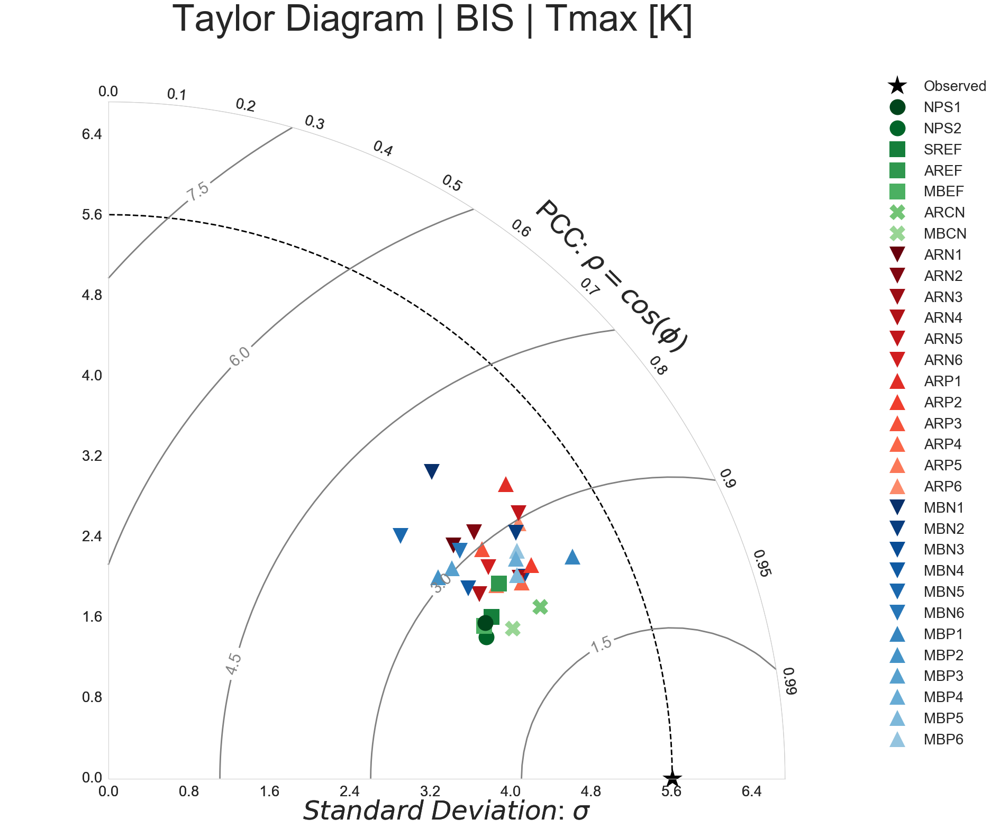

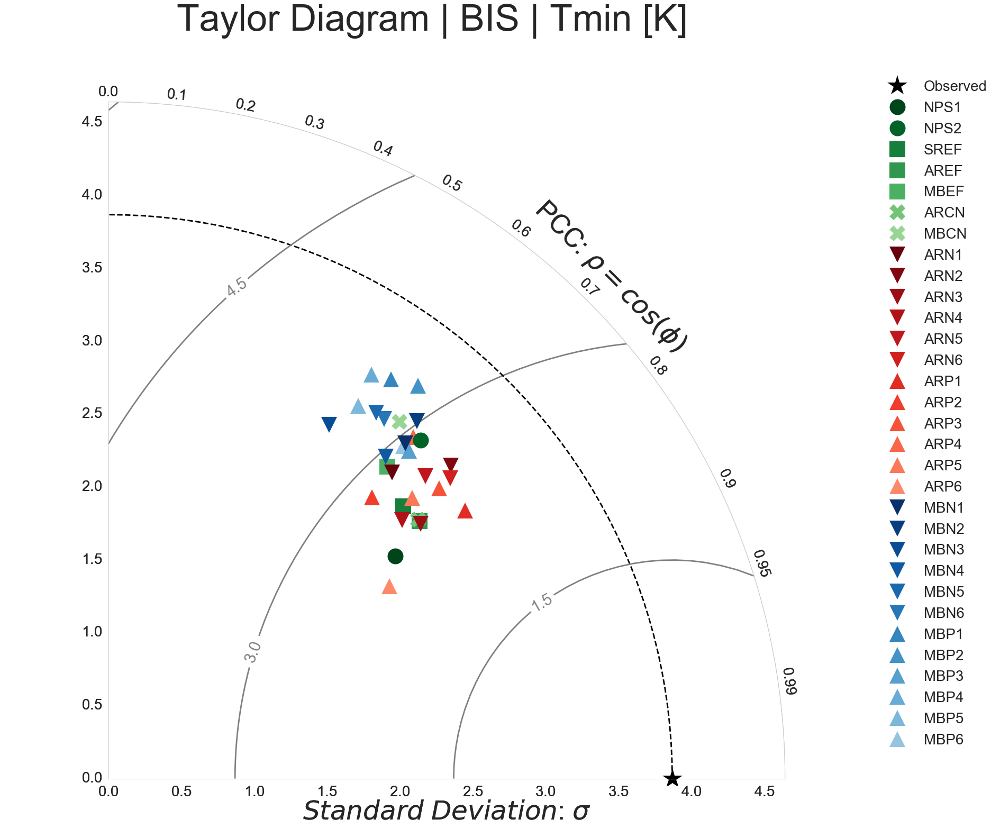

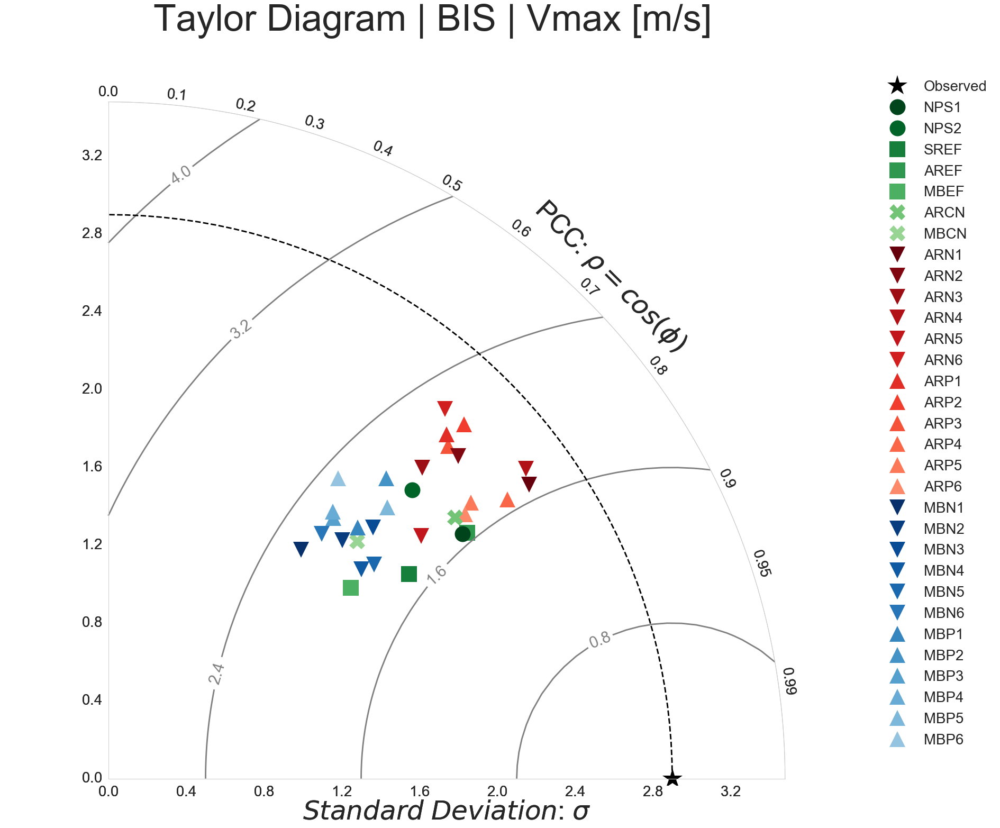

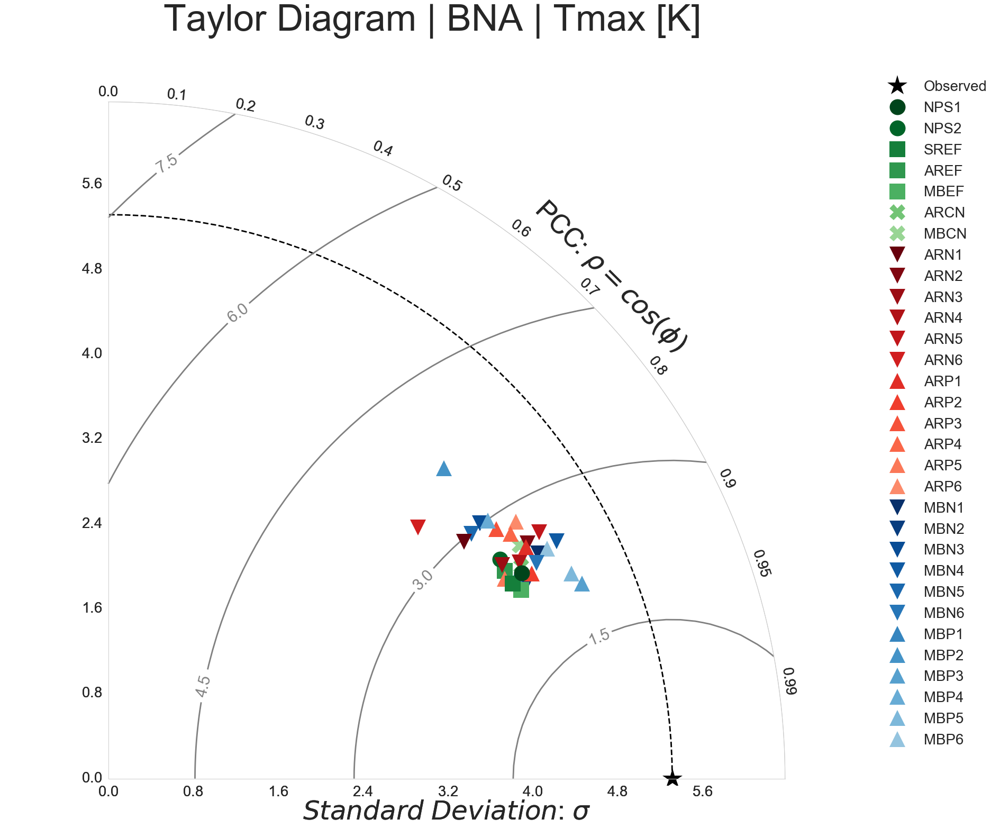

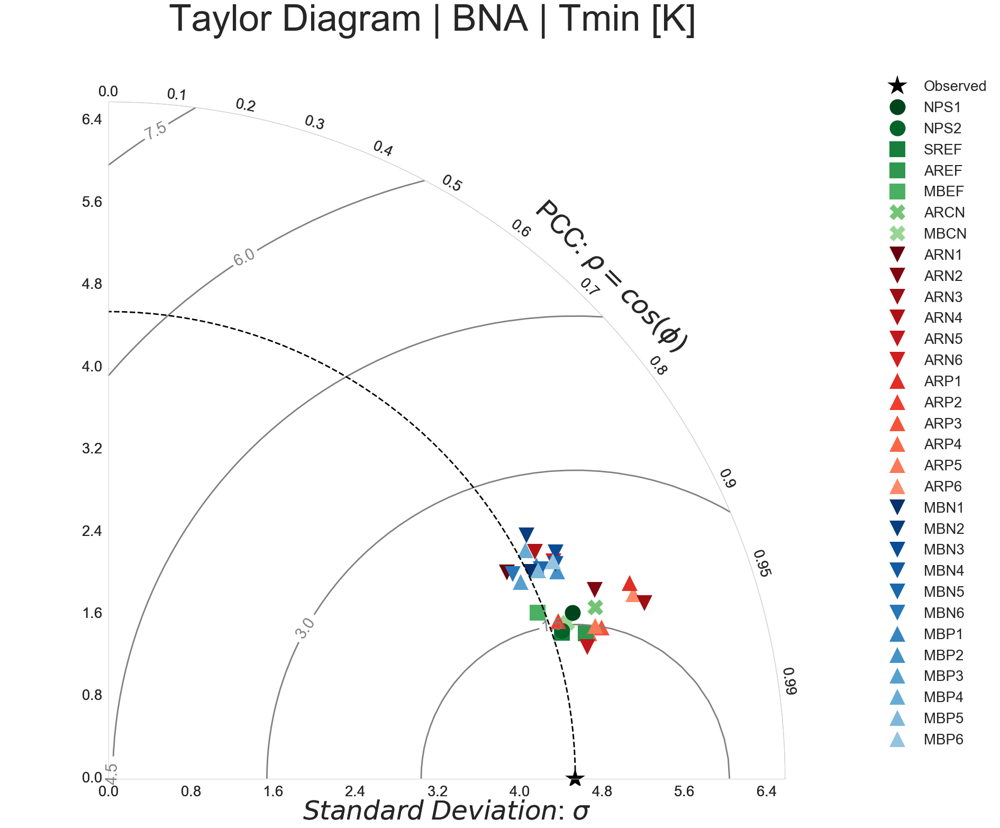

...

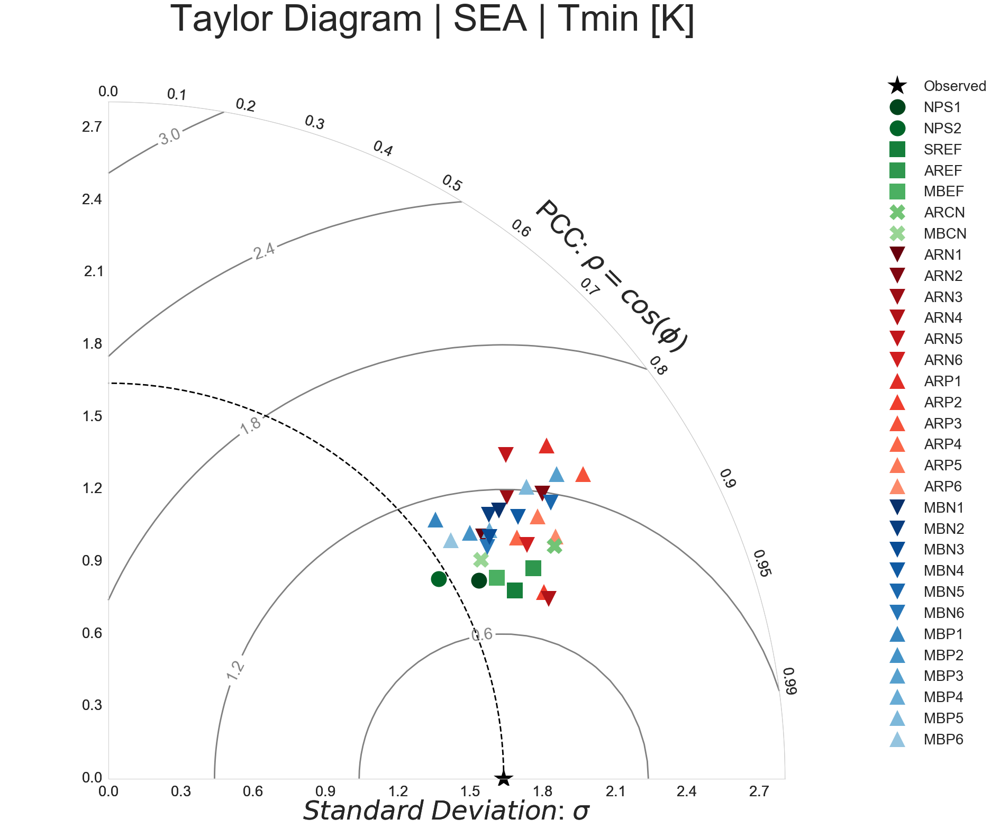

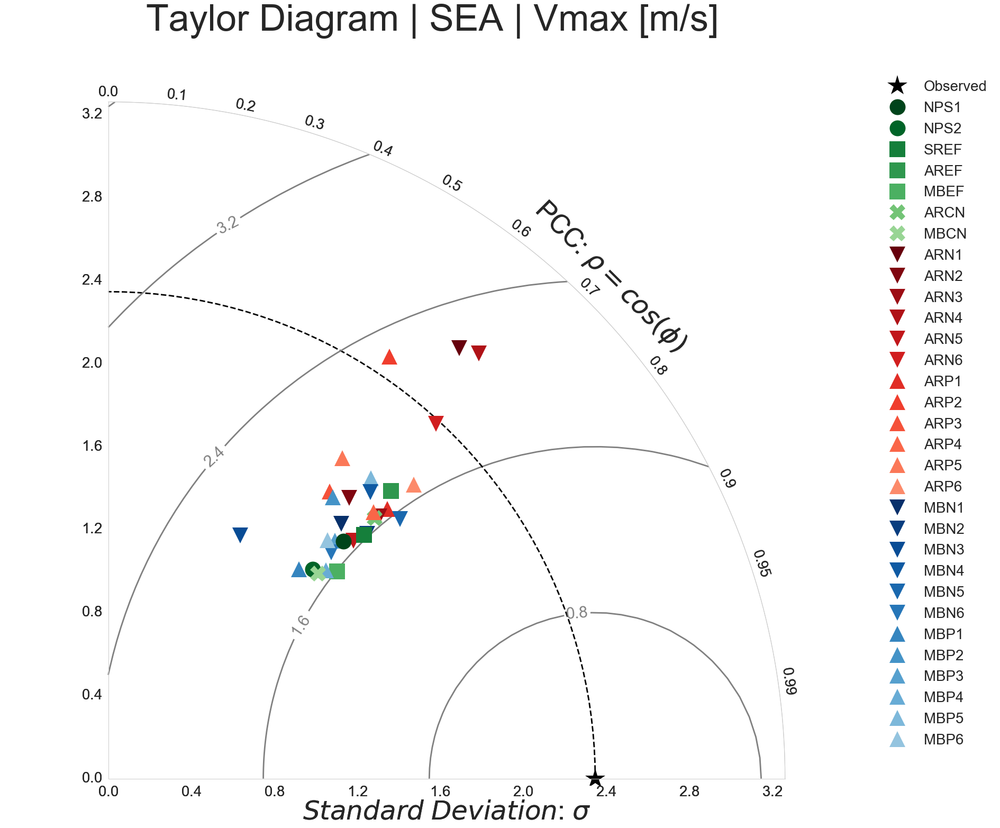

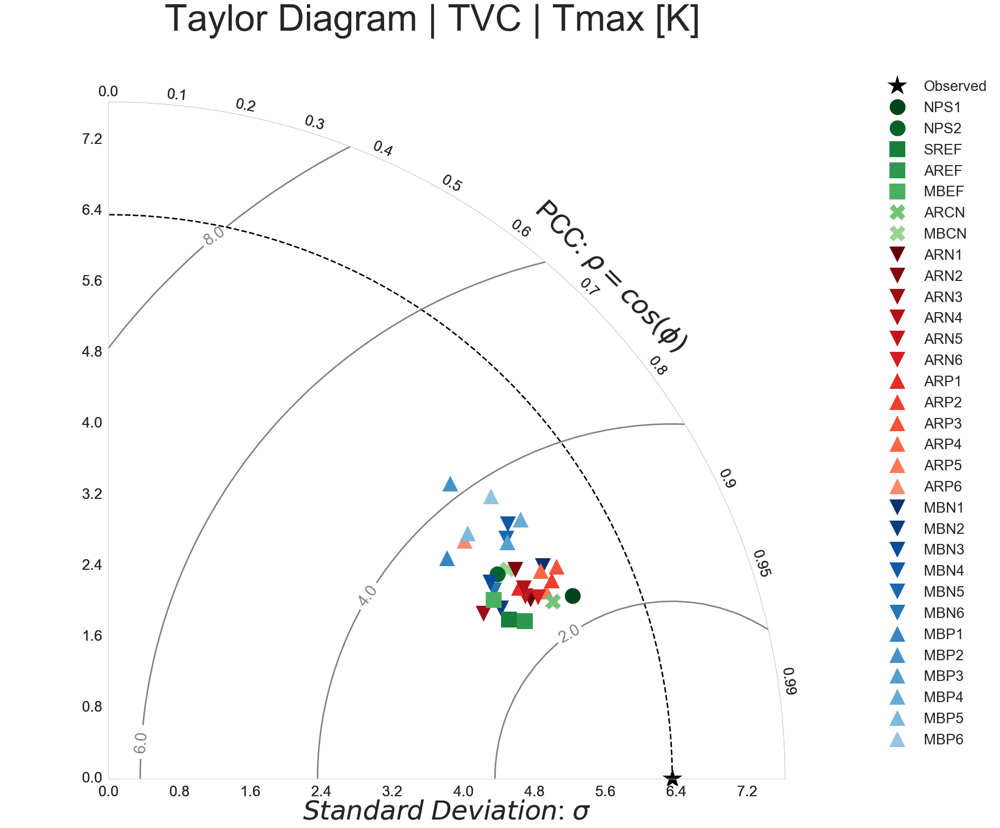

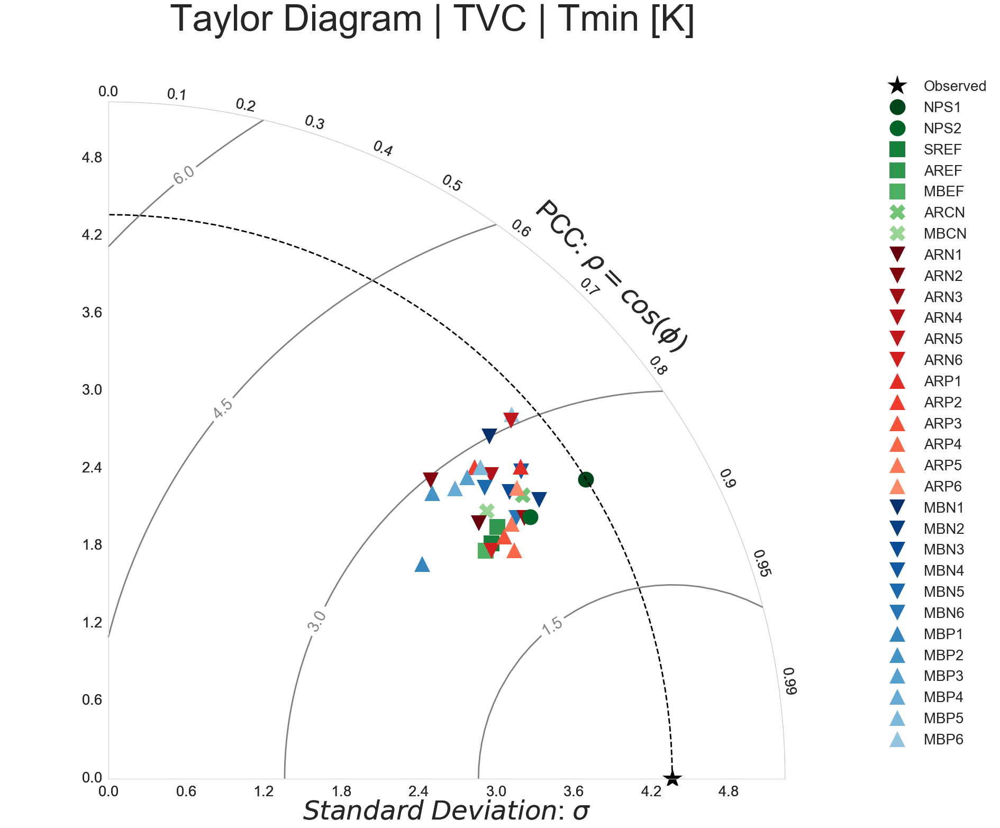

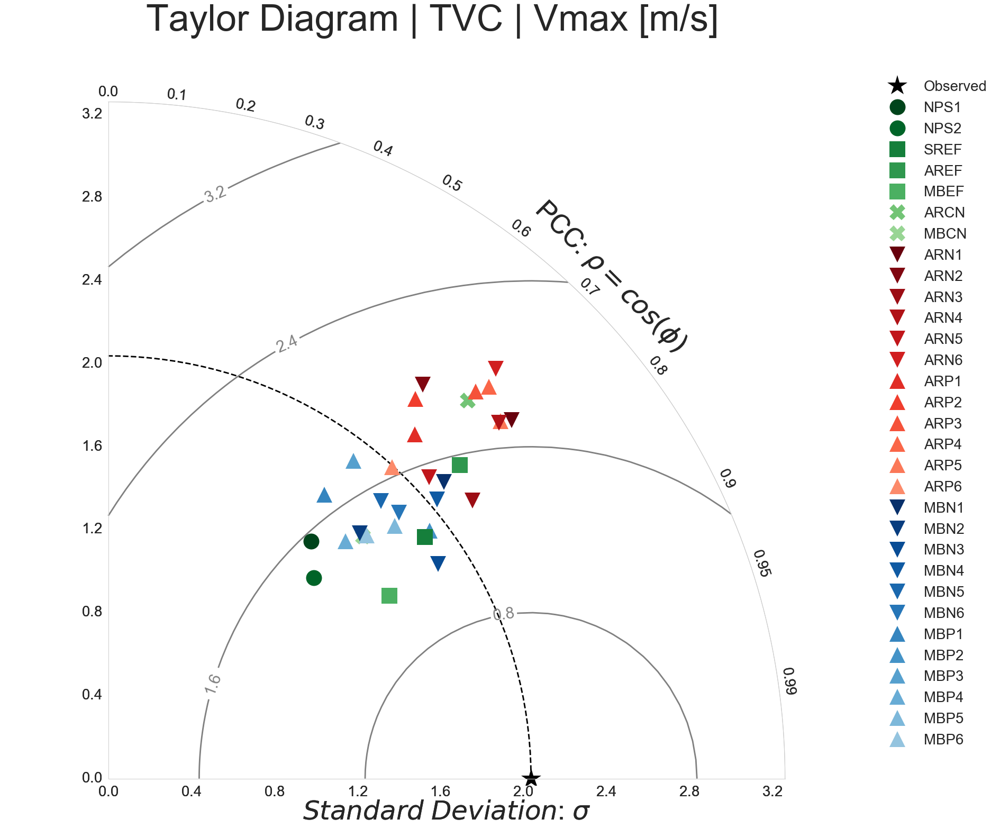

In [52]:
markerList = ['o','o',
              's','s','s',
              'X','X',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^',
              'v','v','v','v','v','v',
              '^','^','^','^','^','^']

for ix, cityStr in enumerate(cityNames):
    
    for iy, varStr in enumerate(varNames):
    
        dx = dfFF.xs([varStr,cityStr],level=['Variable','City']).drop('CLIM',axis=1)
        
        tempSamples = pd.concat((dx.std(ddof=1),dx.corr().OBS),axis=1)
        tempSamples.columns = ['sd','pcc']

        refstd = tempSamples.loc['OBS','sd']
        samples = tempSamples.drop('OBS',axis=0)
        modelNames = list(samples.index)

        fig = plt.figure(figsize=(30,24))
        dia = TaylorDiagram(refstd, np.max(samples.iloc[:,0]), fig=fig, label="Observed")
        clr1 = plt.matplotlib.cm.Greens_r(np.linspace(clrA,clrB,7))
        clr2 = plt.matplotlib.cm.Reds_r(np.linspace(clrA,clrB,12))
        clr3 = plt.matplotlib.cm.Blues_r(np.linspace(clrA,clrB,12))
        clrs = np.concatenate((clr1,clr2,clr3),axis=0)

        # Add samples to Taylor diagram
        for i,(stddev,corrcoef) in enumerate(array(samples)):

            dia.add_sample(stddev, corrcoef,
                           # marker='$%d$' % (i+1),
                           marker = markerList[i],
                           ms=30, 
                           ls='',
                           alpha = 1,
                           mfc=clrs[i],
                           label=modelNames[i])
                
        # Add RMS contours, and label them
        contours = dia.add_contours(colors='0.5')
        plt.clabel(contours, inline=1, fontsize=30, fmt='%.1f')

        # Add a figure legend
        fig.legend(dia.samplePoints,
                   [ p.get_label() for p in dia.samplePoints ],
                   numpoints=1, prop=dict(size='x-large'), loc=5)
        
        fig.suptitle('Taylor Diagram | ' + cityStr + ' | ' + varStr + ' ' + unitNames[iy], fontsize = 70)
        # fig.tight_layout()

## Traditional Metrics for Continuous Variables

In [53]:
dfScores = dfFF.copy()

### Mean Error (Bias)

In [54]:
dfError = dfScores.loc[:,errorList].sub(dfScores['OBS'], axis=0)

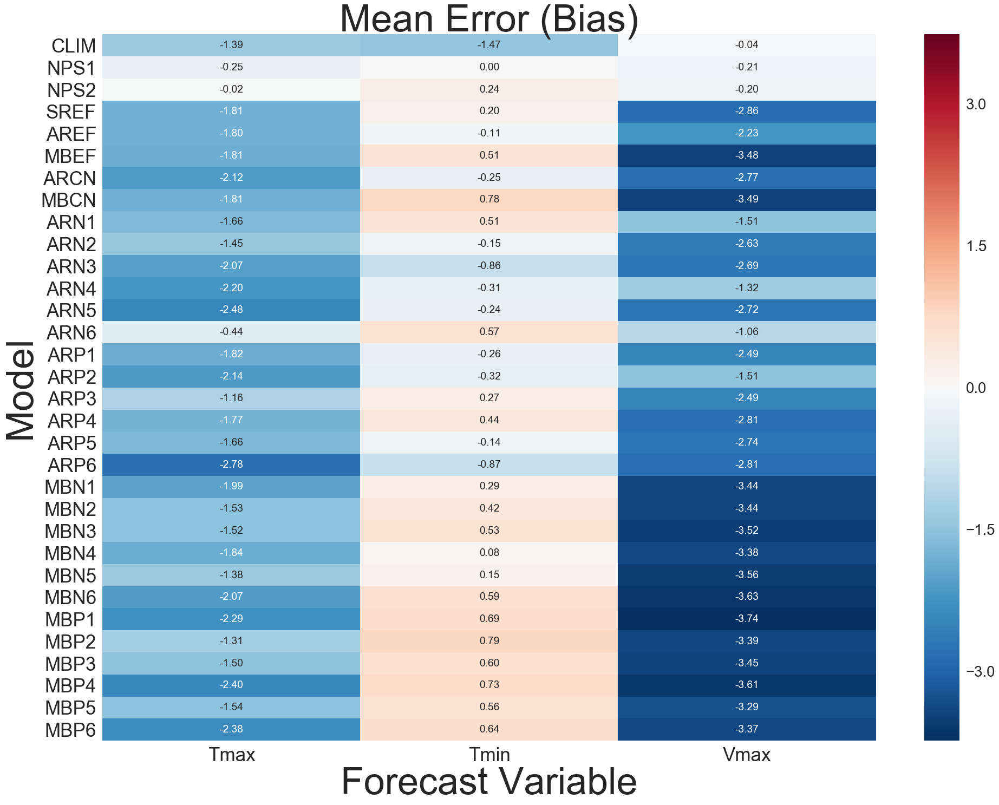

In [55]:
df = dfError.mean(level=['Variable'])
cols = list(df)

ts = 70
fs = 70
ls = 35

plt.figure(figsize=(32,24))
dh = df.T
sns.heatmap(dh,annot=True, fmt='.2f')
plt.title('Mean Error (Bias)', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

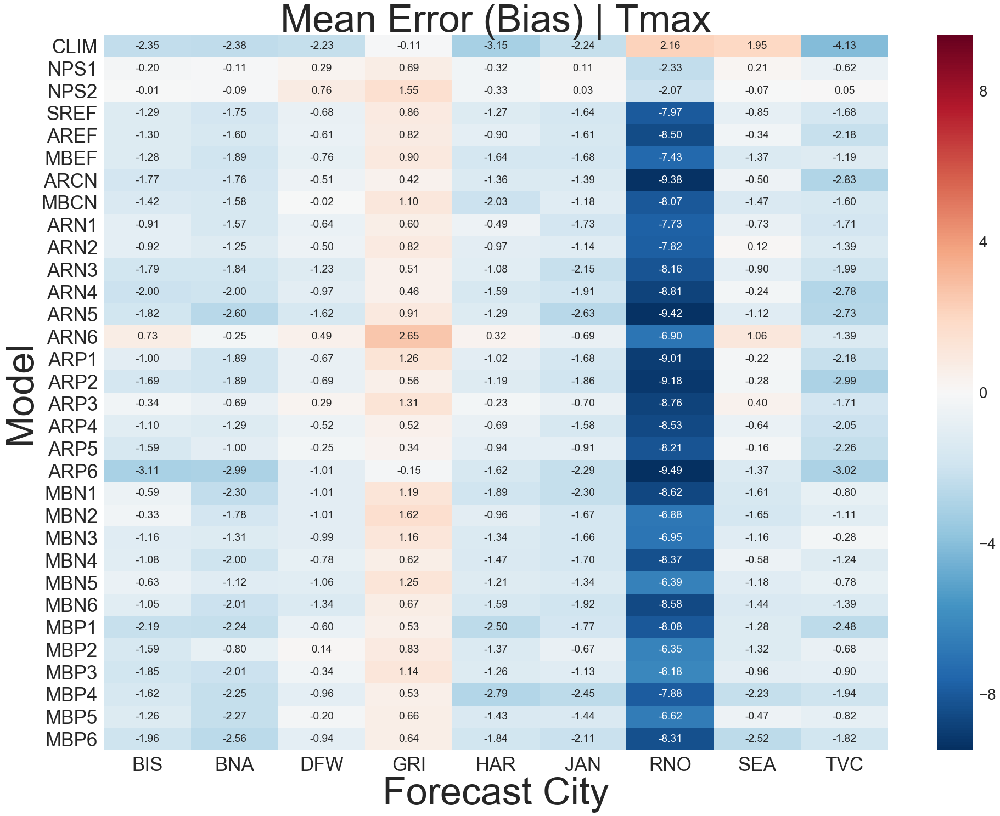

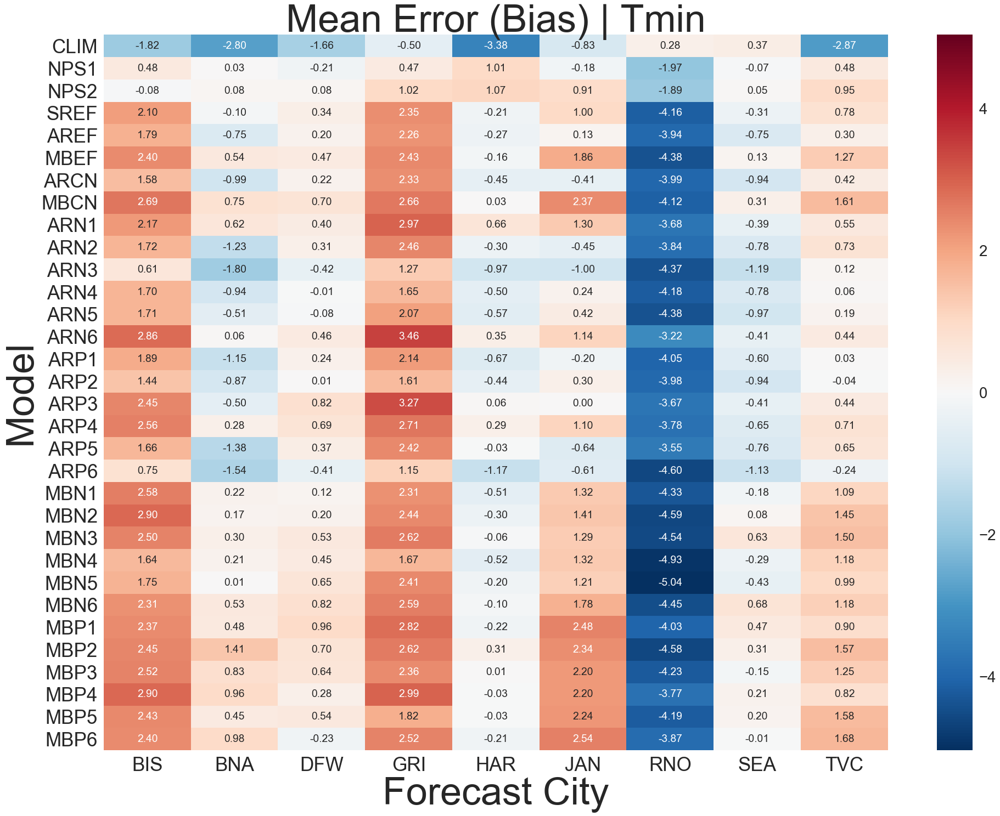

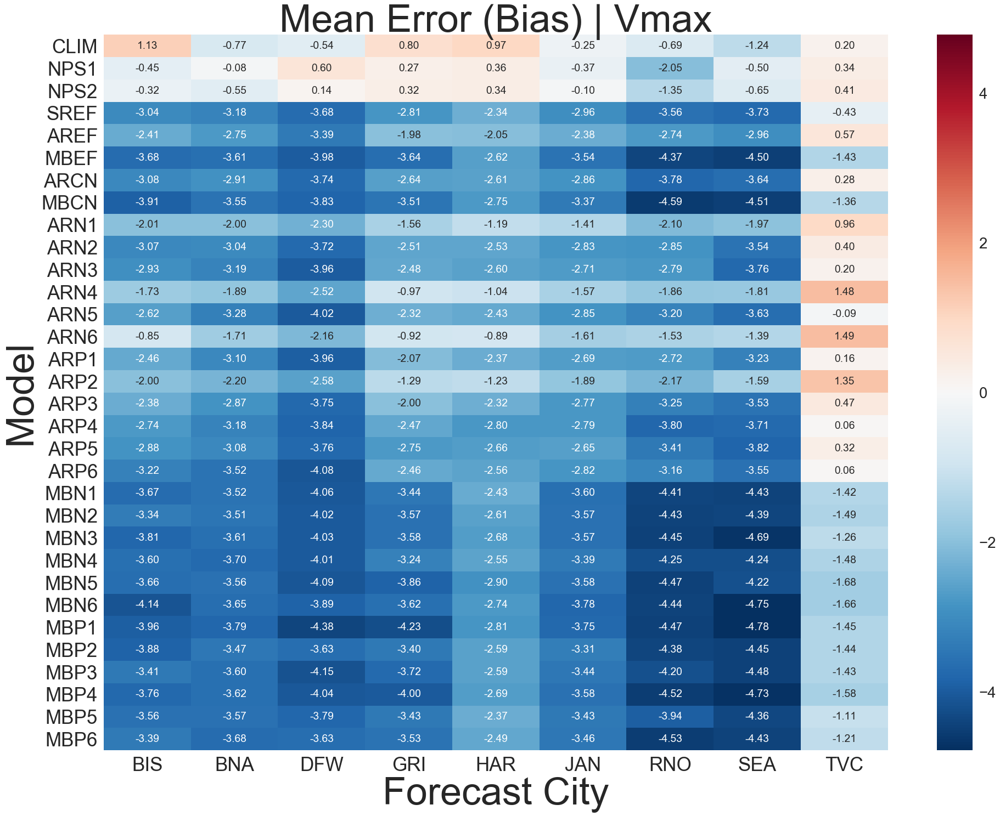

In [56]:
df = dfError.mean(level=['Variable','City'])
cols = list(df)

ts = 70
fs = 70
ls = 35

for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Error (Bias) | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

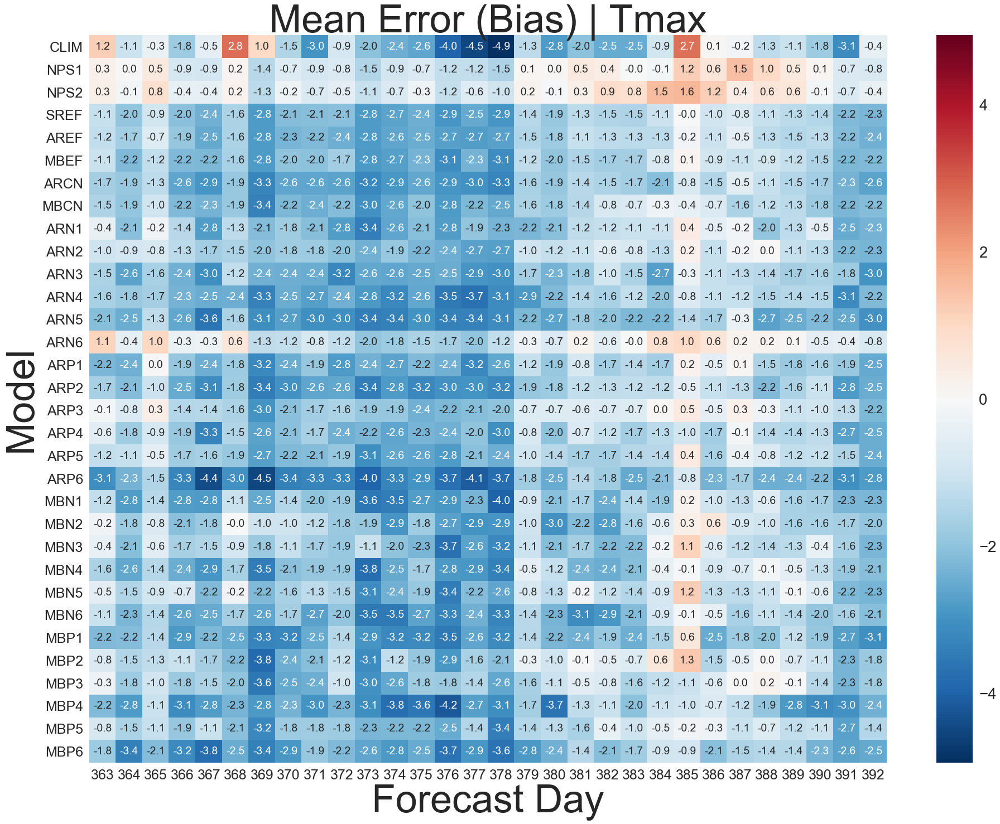

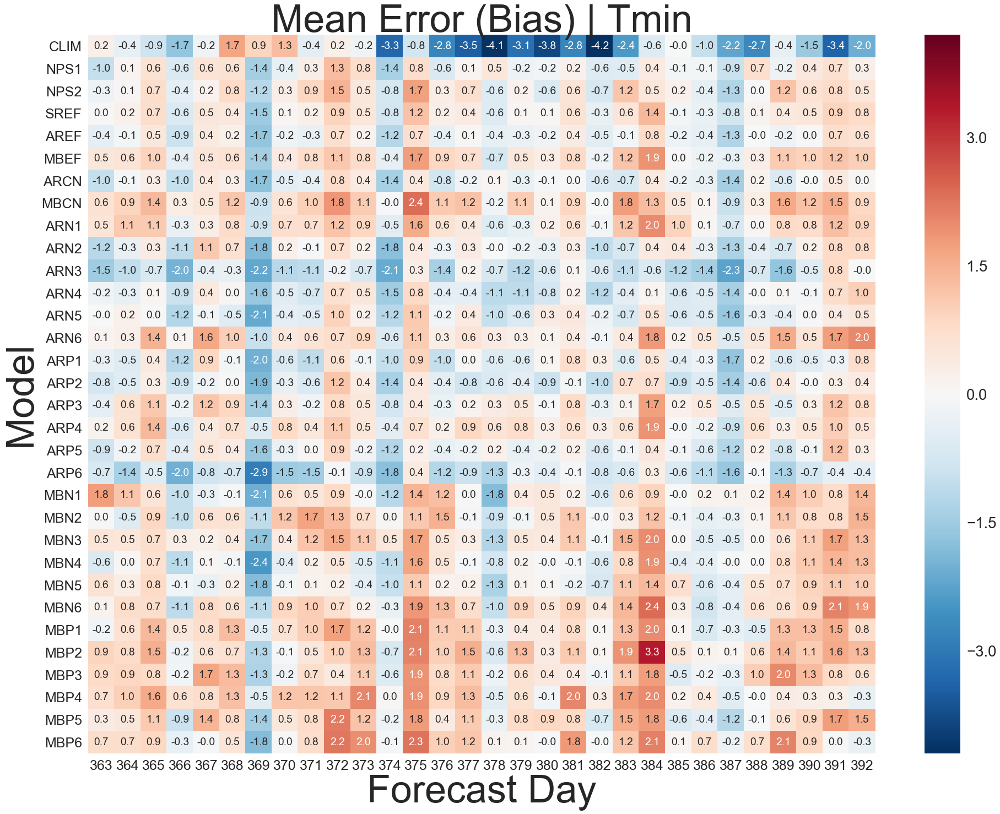

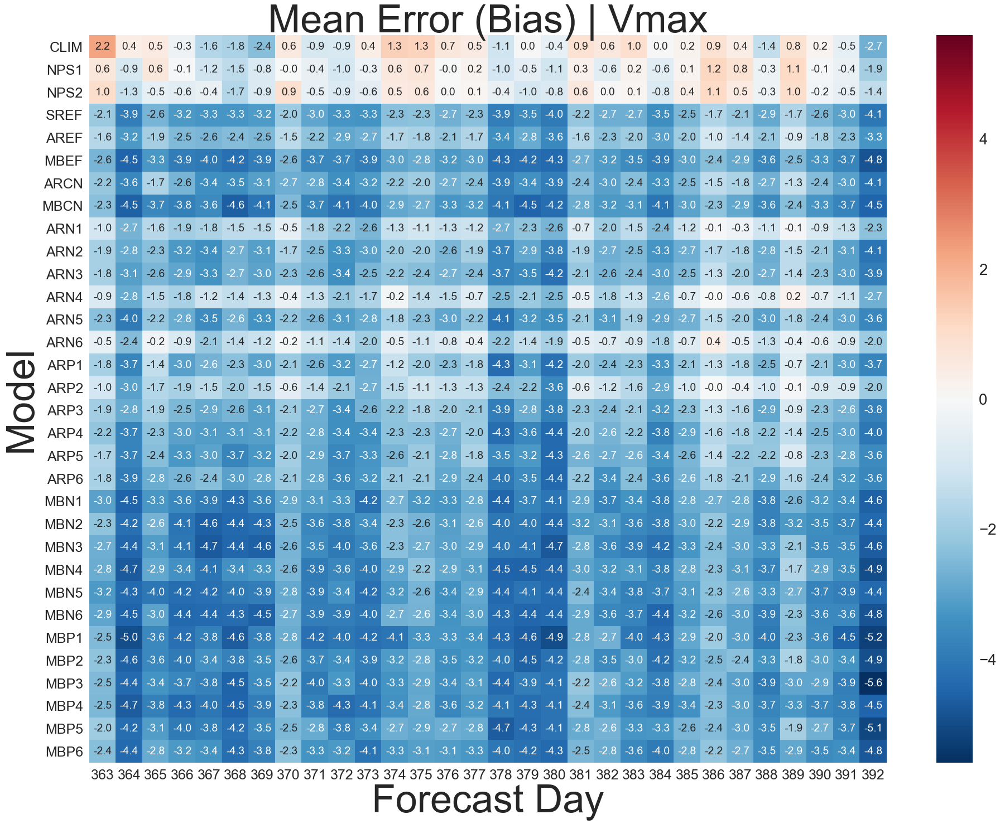

In [57]:
df = dfError.mean(level=['Variable','Day'])
cols = list(df)

ts = 70
fs = 70
ls = 25

for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.1f')
    plt.title('Mean Error (Bias) | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

### Mean Absolute Error (MAE)

In [58]:
dfAbsError = np.absolute(dfError)

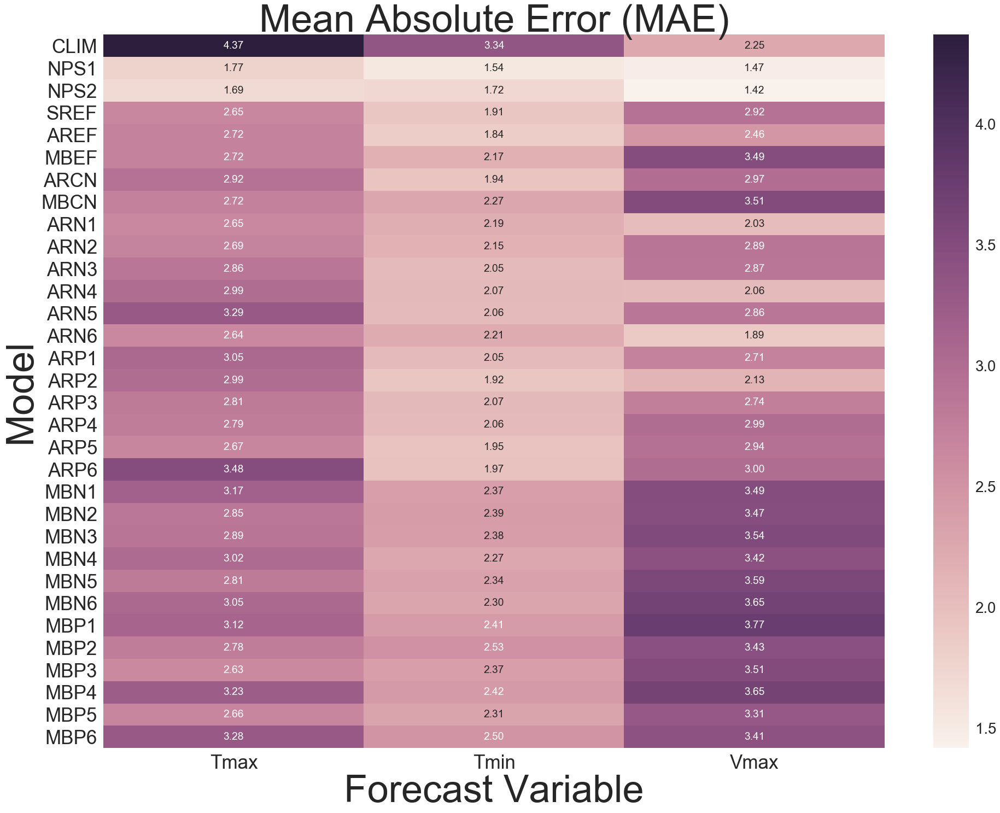

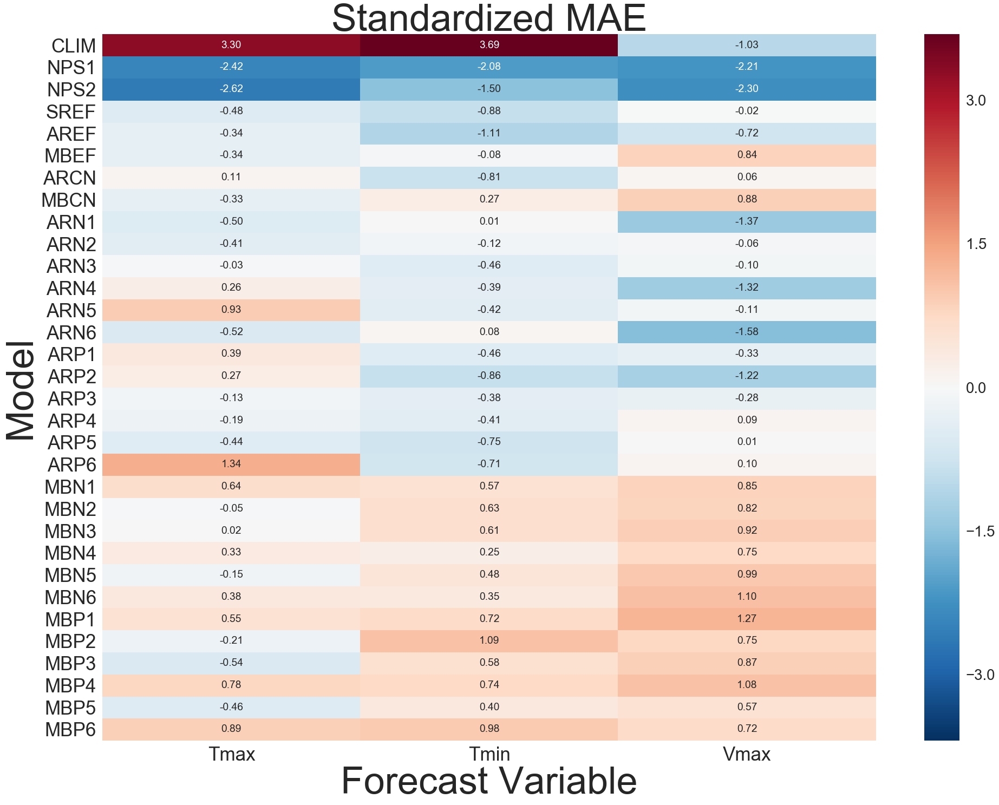

In [59]:
df = dfAbsError.mean(level=['Variable'])
cols = list(df)

ts = 70
fs = 70
ls = 35

plt.figure(figsize=(32,24))
dh = df.T
sns.heatmap(dh,annot=True, fmt='.2f')
plt.title('Mean Absolute Error (MAE)', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

plt.figure(figsize=(32,24))
dh = (dh - dh.mean())/dh.std(ddof=1)
sns.heatmap(dh,annot=True, fmt='.2f', center = 0)
plt.title('Standardized MAE', fontsize=ts)
plt.xticks(rotation='horizontal')
plt.xlabel('Forecast Variable', fontsize=fs)
plt.ylabel('Model',fontsize=fs)
plt.xticks(fontsize = ls)
plt.yticks(fontsize = ls);

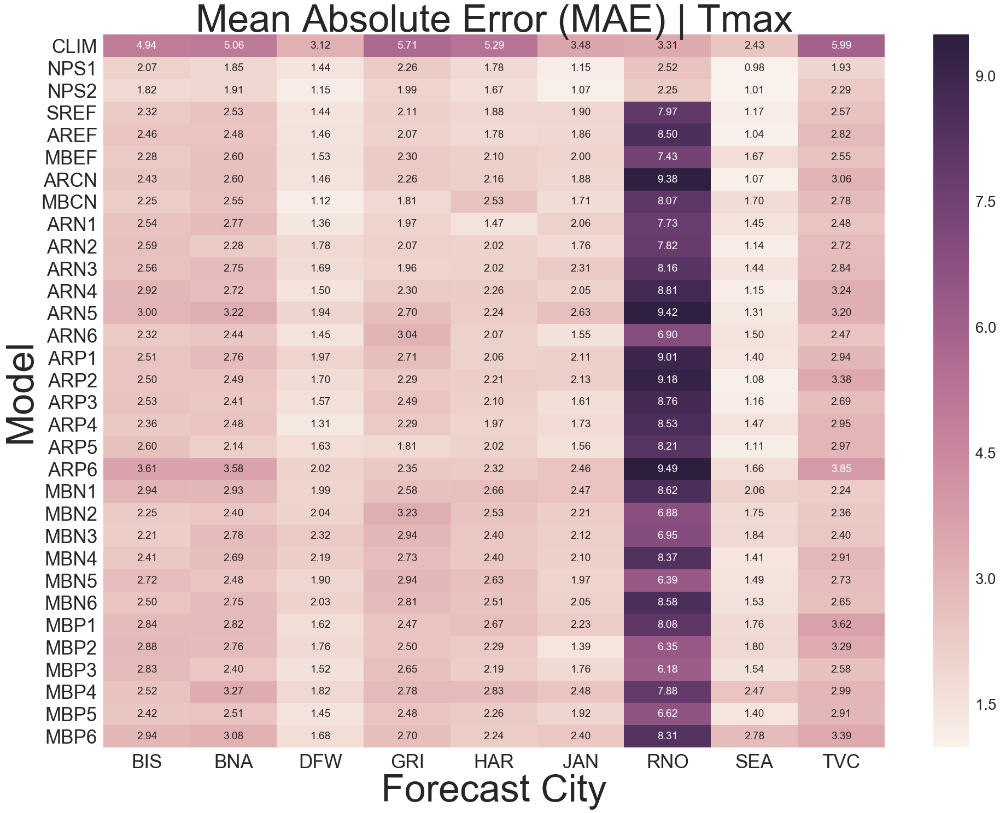

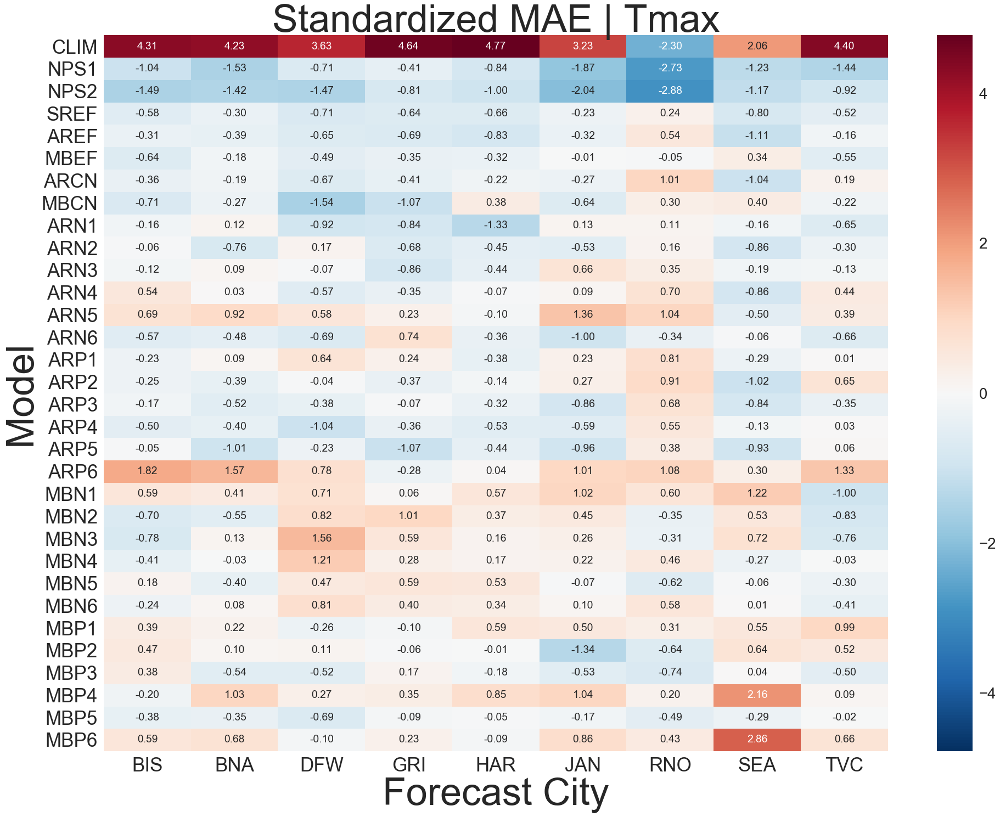

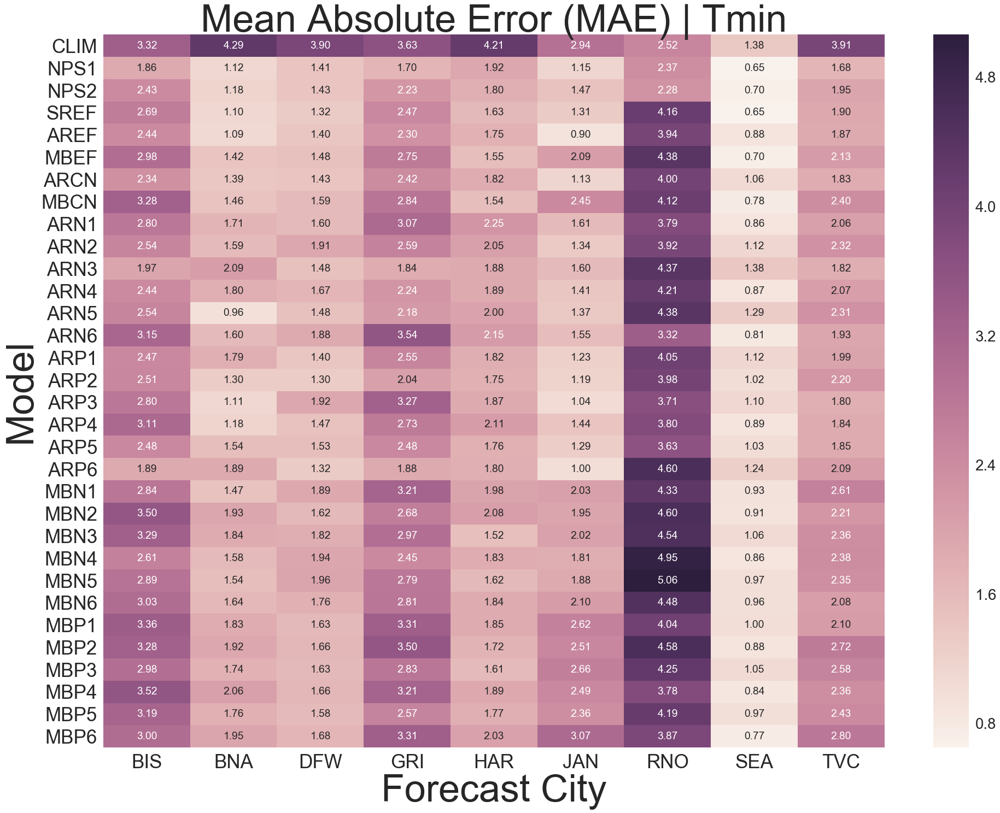

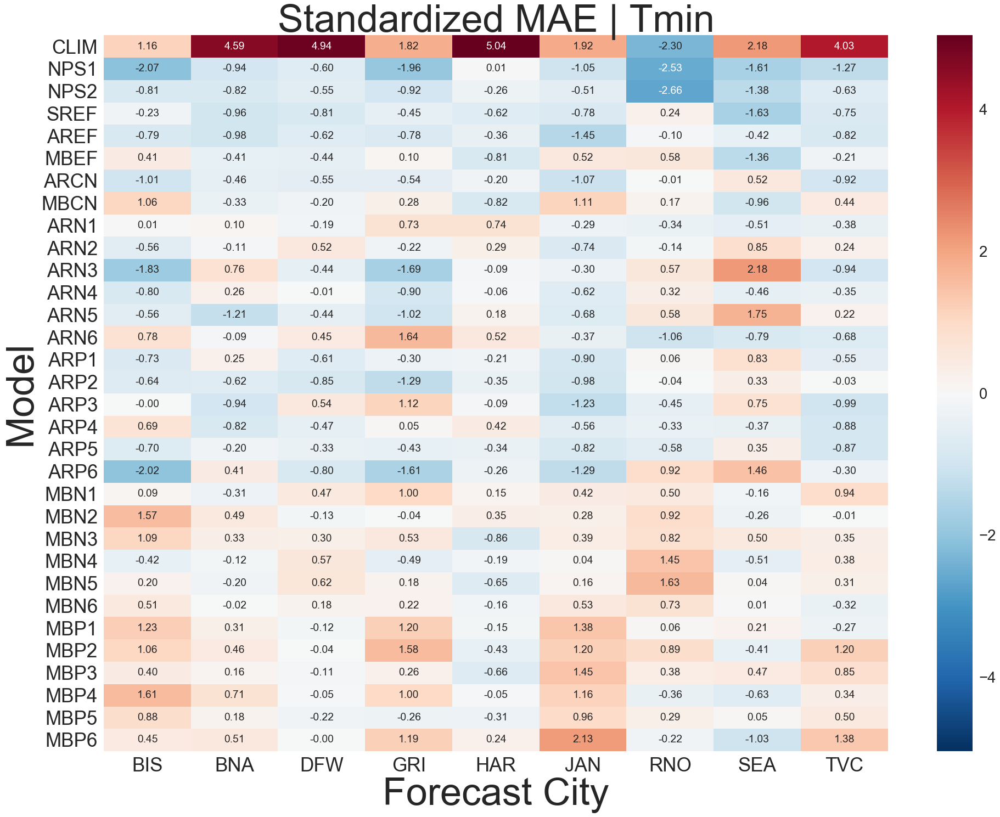

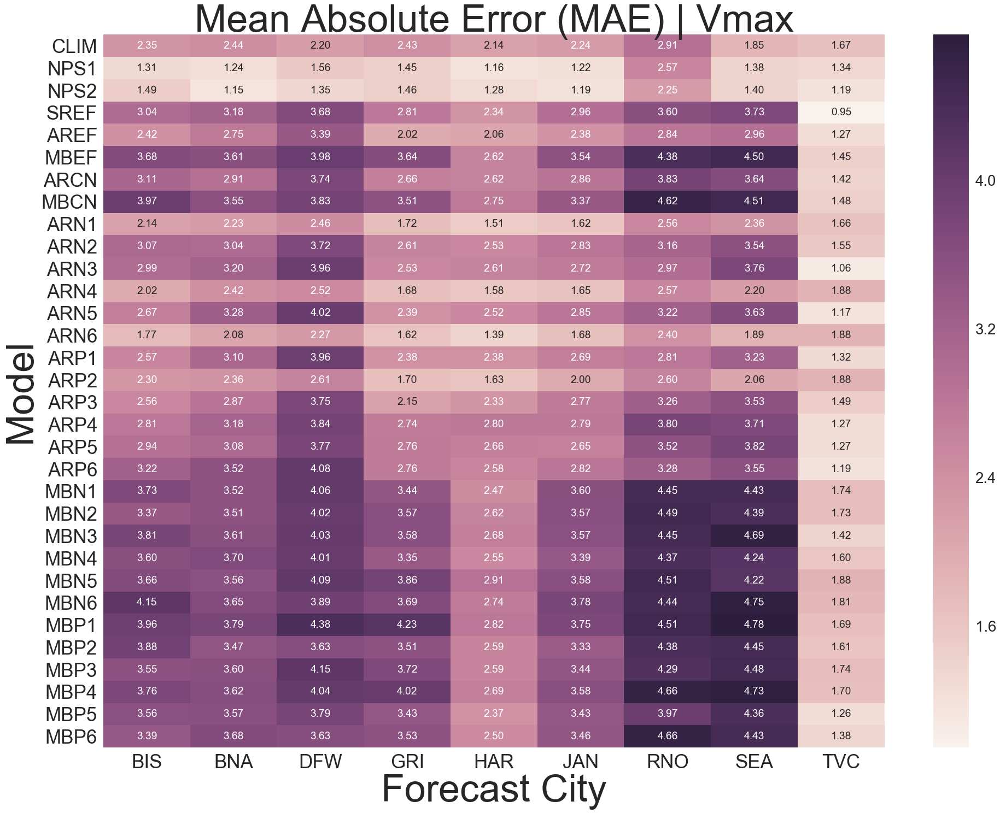

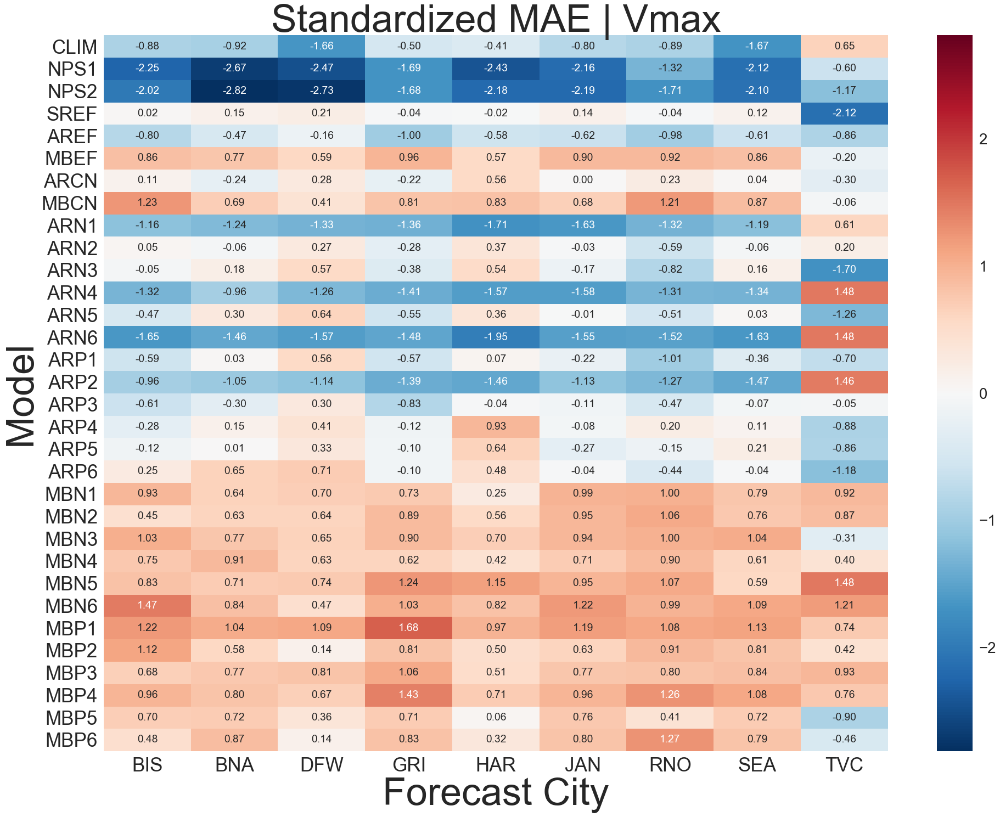

In [60]:
df = dfAbsError.mean(level=['Variable','City'])
cols = list(df)

ts = 70
fs = 70
ls = 35

for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Mean Absolute Error (MAE) | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
    
    dh = (dh - dh.mean())/dh.std(ddof=1)
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized MAE | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast City', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)

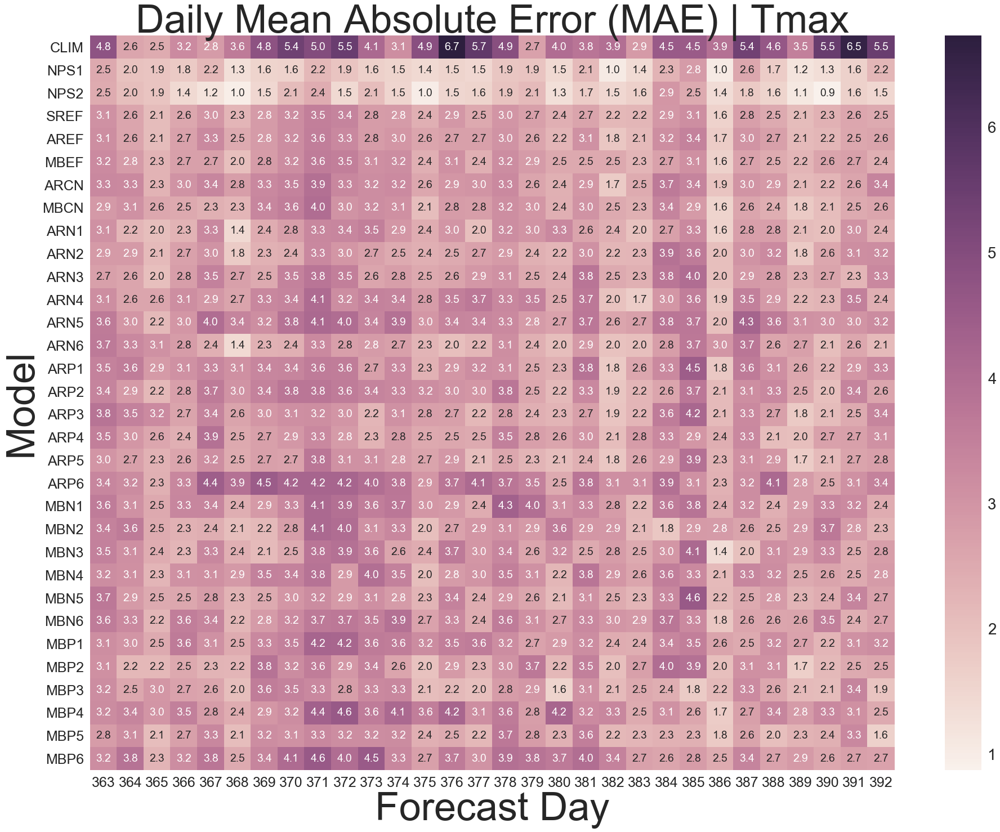

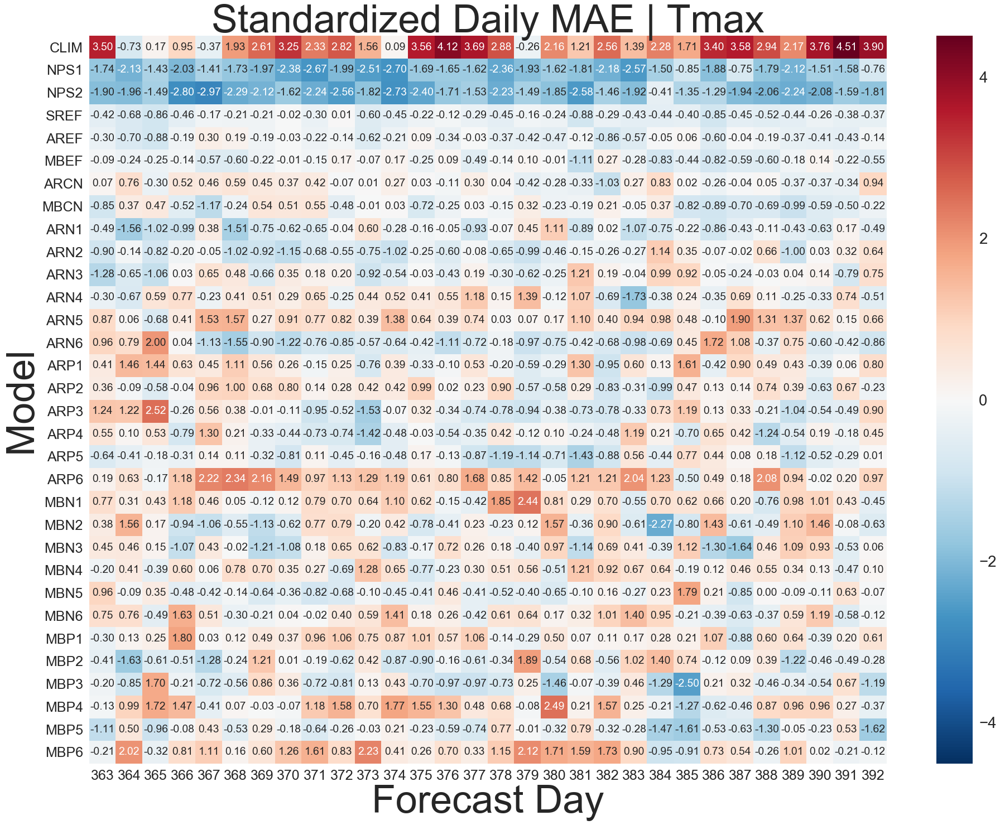

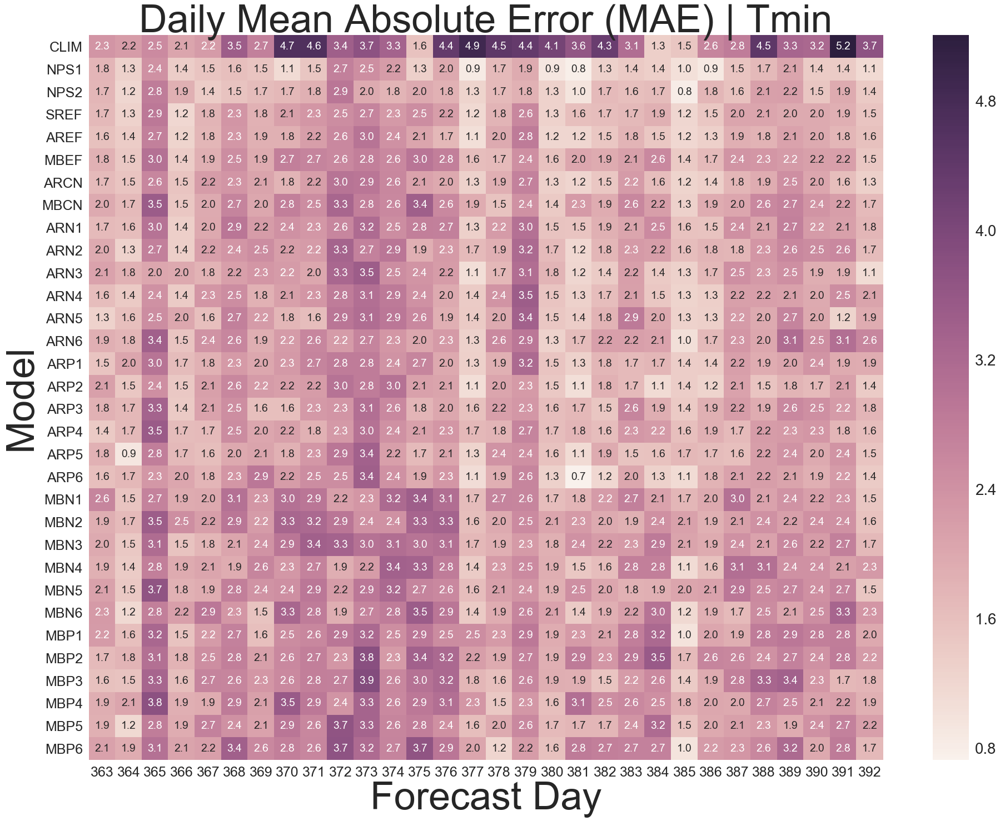

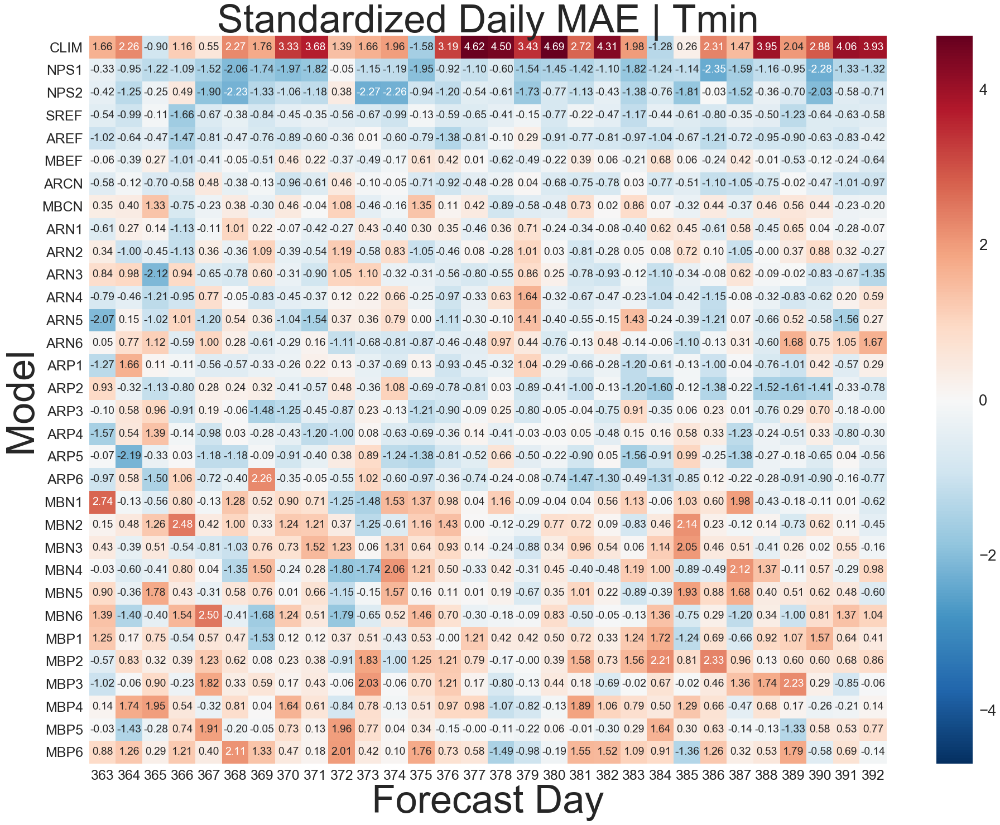

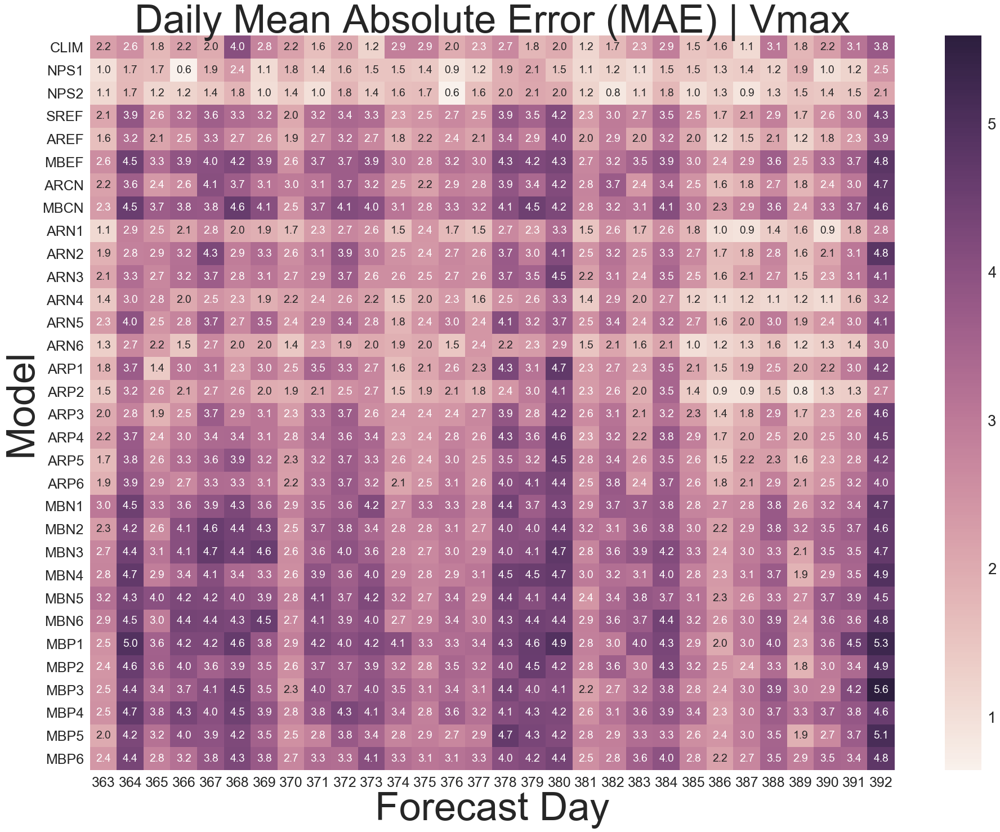

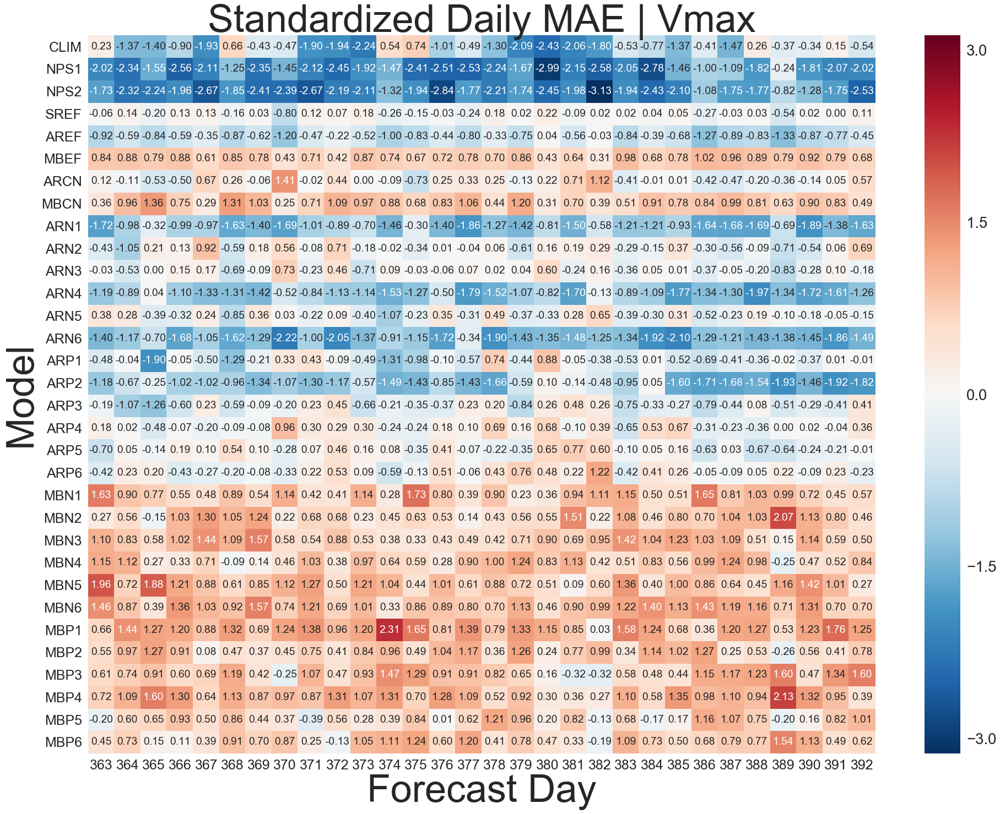

In [61]:
df = dfAbsError.mean(level=['Variable','Day'])
cols = list(df)

ts = 70
fs = 70
ls = 25

for i, var in enumerate(varNames):
    
    dh = df.ix[var].T
    plt.figure(figsize=(32,24))
    sns.heatmap(dh,annot=True, fmt='.1f')
    plt.title('Daily Mean Absolute Error (MAE) | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)
    
    plt.figure(figsize=(32,24))
    dh = (dh - dh.mean())/dh.std(ddof=1)
    sns.heatmap(dh,annot=True, fmt='.2f')
    plt.title('Standardized Daily MAE | ' + var, fontsize=ts)
    plt.xticks(rotation='horizontal')
    plt.xlabel('Forecast Day', fontsize=fs)
    plt.ylabel('Model',fontsize=fs)
    plt.xticks(fontsize = ls)
    plt.yticks(fontsize = ls)